# Tiny NeRF | James Roberts | 2020

This is a simplied version of the method presented in NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis.

Components not included in the notebook

- 5D input including view directions
- Hierarchical Sampling

Python 3.7 | Tensorflow 2.2

In [1]:
import os, sys
import tensorflow as tf
tf.compat.v1.enable_eager_execution()

from tqdm import tqdm_notebook as tqdm
import numpy as np
import matplotlib.pyplot as plt

In [2]:
if not os.path.exists('tiny_nerf_data.npz'):
    !wget https://people.eecs.berkeley.edu/~bmild/nerf/tiny_nerf_data.npz

### Load Input Images and Poses

(106, 100, 100, 3) (106, 4, 4) 138.88887889922103


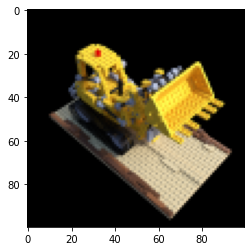

In [3]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']
H, W = images.shape[1:3]
print(images.shape, poses.shape, focal)

testimg, testpose = images[101], poses[101]
images = images[:100,...,:3]
poses = poses[:100]

plt.imshow(testimg)
plt.show()

### Optimize NeRF

In [4]:
def posenc(x):
  rets = [x]
  for i in range(L_embed):
    for fn in [tf.sin, tf.cos]:
      rets.append(fn(2.**i * x))
  return tf.concat(rets, -1)

L_embed = 6
embed_fn = posenc
# L_embed = 0
# embed_fn = tf.identity

def init_model(D=8, W=256):
    relu = tf.keras.layers.ReLU()    
    dense = lambda W=W, act=relu : tf.keras.layers.Dense(W, activation=act)

    inputs = tf.keras.Input(shape=(3 + 3*2*L_embed)) 
    outputs = inputs
    for i in range(D):
        outputs = dense()(outputs)
        if i%4==0 and i>0:
            outputs = tf.concat([outputs, inputs], -1)
    outputs = dense(4, act=None)(outputs)
    
    model = tf.keras.Model(inputs=inputs, outputs=outputs)
    return model


def get_rays(H, W, focal, c2w):
    i, j = tf.meshgrid(tf.range(W, dtype=tf.float32), tf.range(H, dtype=tf.float32), indexing='xy')
    dirs = tf.stack([(i-W*.5)/focal, -(j-H*.5)/focal, -tf.ones_like(i)], -1)
    rays_d = tf.reduce_sum(dirs[..., np.newaxis, :] * c2w[:3,:3], -1)
    rays_o = tf.broadcast_to(c2w[:3,-1], tf.shape(rays_d))
    return rays_o, rays_d



def render_rays(network_fn, rays_o, rays_d, near, far, N_samples, rand=False):

    def batchify(fn, chunk=1024*32):
        return lambda inputs : tf.concat([fn(inputs[i:i+chunk]) for i in range(0, inputs.shape[0], chunk)], 0)
    
    # Compute 3D query points
    z_vals = tf.linspace(near, far, N_samples) 
    if rand:
      z_vals += tf.random.uniform(list(rays_o.shape[:-1]) + [N_samples]) * (far-near)/N_samples
    pts = rays_o[...,None,:] + rays_d[...,None,:] * z_vals[...,:,None]
    
    # Run network
    pts_flat = tf.reshape(pts, [-1,3])
    pts_flat = embed_fn(pts_flat)
    raw = batchify(network_fn)(pts_flat)
    raw = tf.reshape(raw, list(pts.shape[:-1]) + [4])
    
    # Compute opacities and colors
    sigma_a = tf.nn.relu(raw[...,3])
    rgb = tf.math.sigmoid(raw[...,:3]) 
    
    # Do volume rendering
    dists = tf.concat([z_vals[..., 1:] - z_vals[..., :-1], tf.broadcast_to([1e10], z_vals[...,:1].shape)], -1) 
    alpha = 1.-tf.exp(-sigma_a * dists)  
    weights = alpha * tf.math.cumprod(1.-alpha + 1e-10, -1, exclusive=True)
    
    rgb_map = tf.reduce_sum(weights[...,None] * rgb, -2) 
    depth_map = tf.reduce_sum(weights * z_vals, -1) 
    acc_map = tf.reduce_sum(weights, -1)

    return rgb_map, depth_map, acc_map

Here we optimize the model. We plot a rendered holdout view and its PSNR every 50 iterations.

0 0.03197752952575684 secs per iter


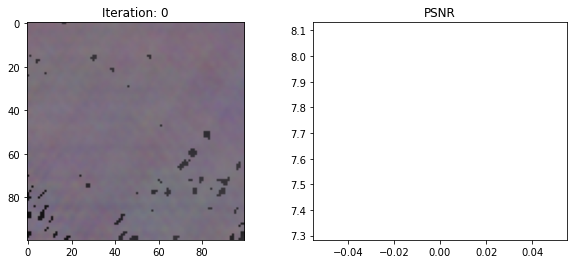

25 0.4035657978057861 secs per iter


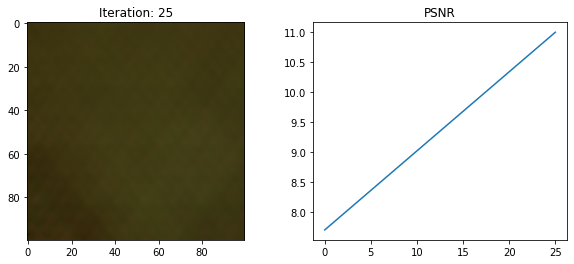

50 0.39203083992004395 secs per iter


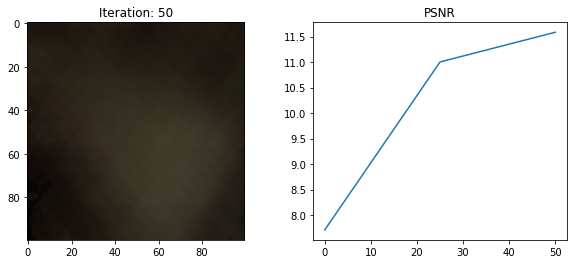

75 0.38600478172302244 secs per iter


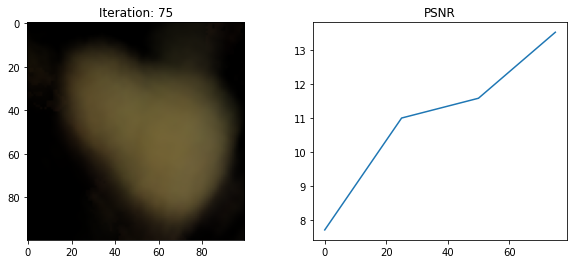

100 0.3845642852783203 secs per iter


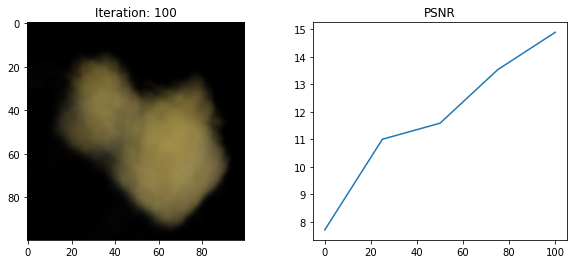

125 0.38999329566955565 secs per iter


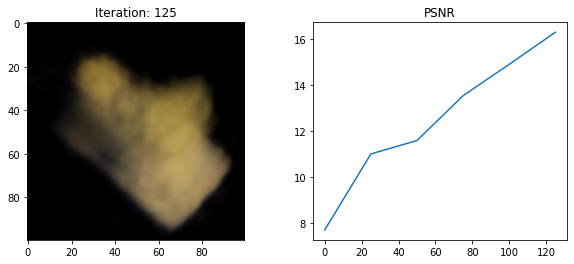

150 0.3890176486968994 secs per iter


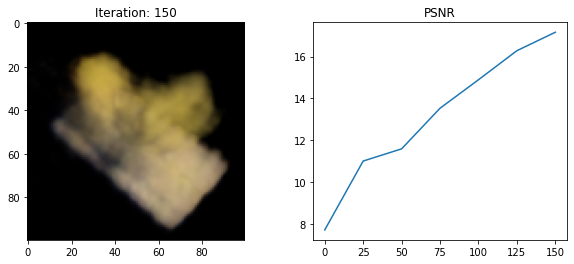

175 0.39023319244384763 secs per iter


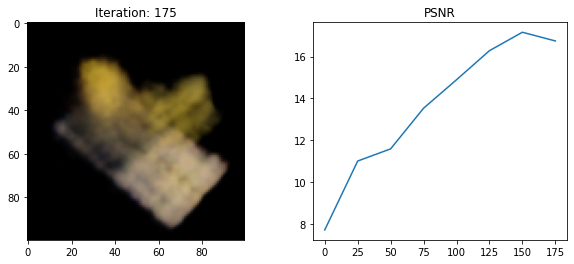

200 0.3871498775482178 secs per iter


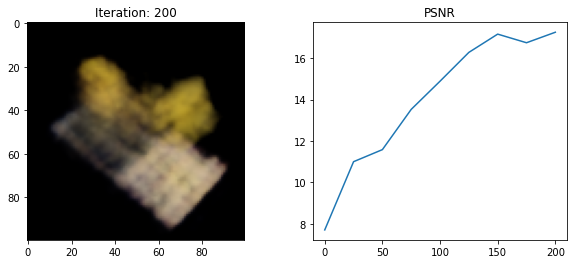

225 0.3864100170135498 secs per iter


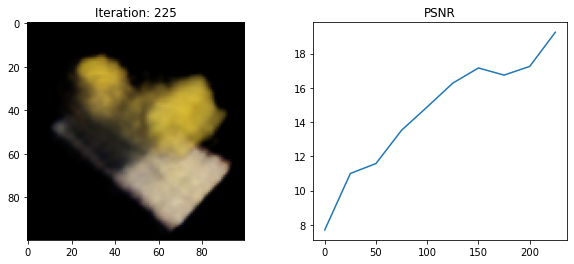

250 0.392461462020874 secs per iter


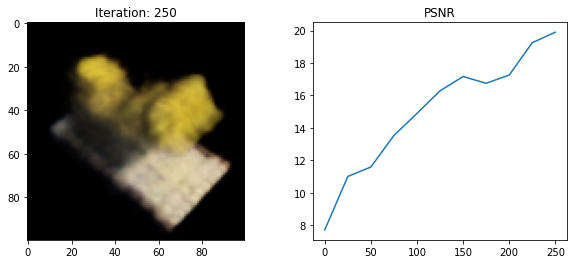

275 0.3906791114807129 secs per iter


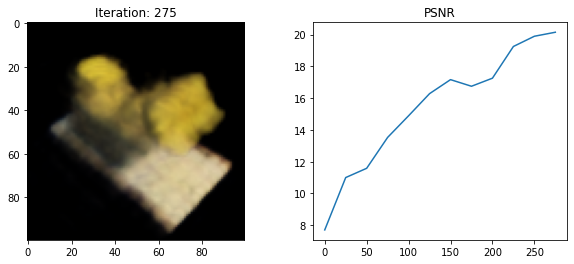

300 0.3910486888885498 secs per iter


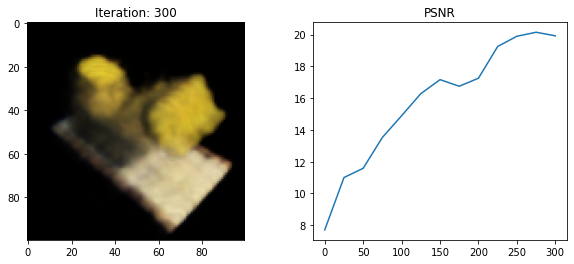

325 0.3910286617279053 secs per iter


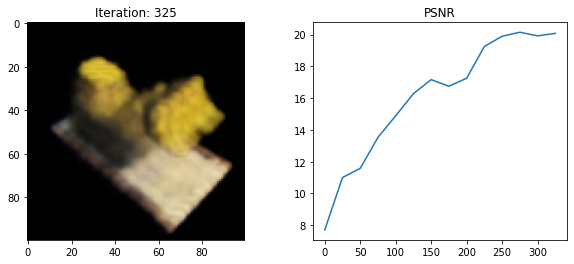

350 0.3918082141876221 secs per iter


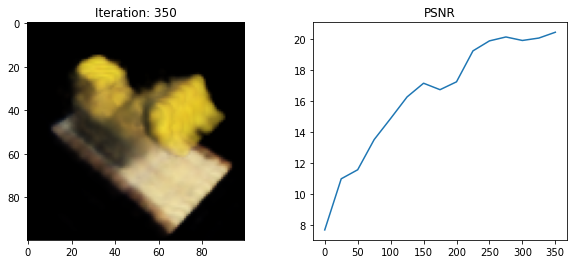

375 0.3992674446105957 secs per iter


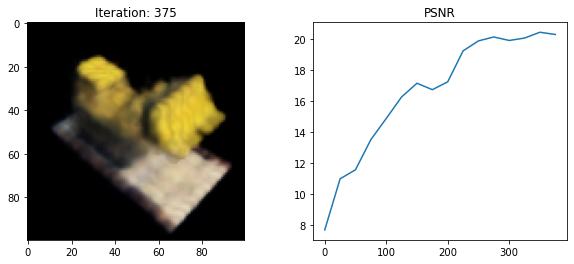

400 0.39090829849243164 secs per iter


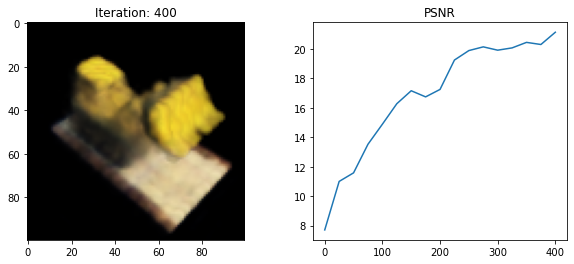

425 0.396410551071167 secs per iter


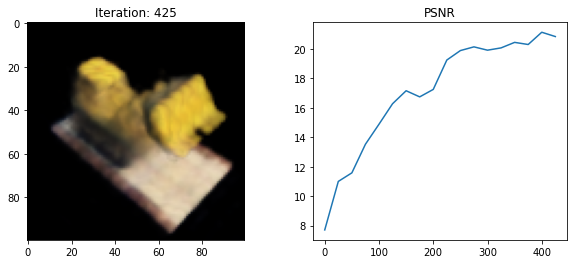

450 0.39377479553222655 secs per iter


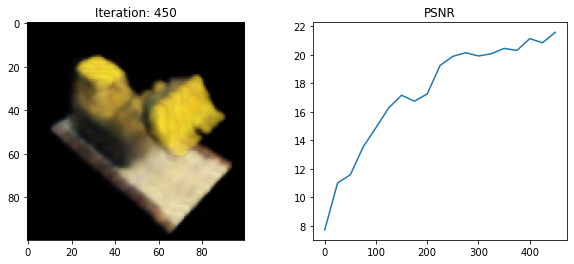

475 0.3921582889556885 secs per iter


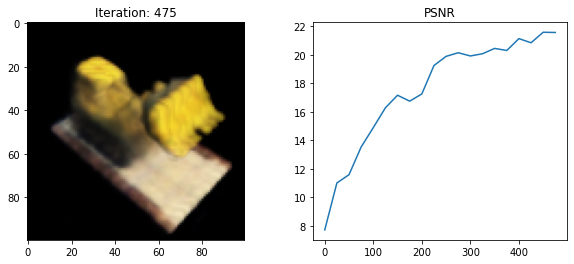

500 0.3892680263519287 secs per iter


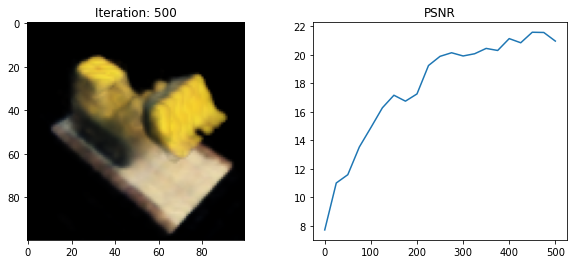

525 0.38797238349914553 secs per iter


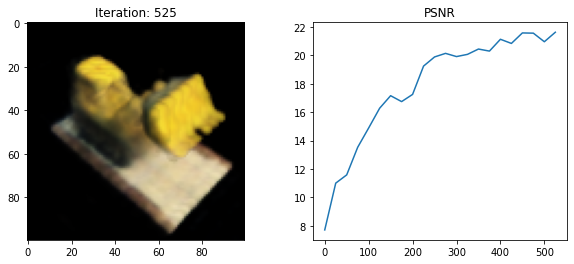

550 0.38967119216918944 secs per iter


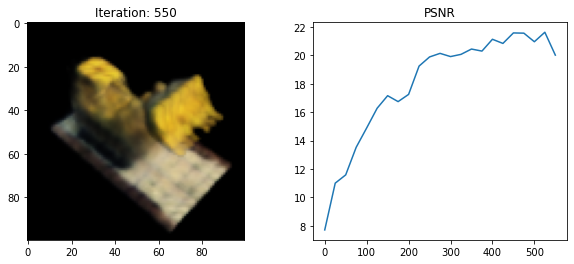

575 0.38866150856018067 secs per iter


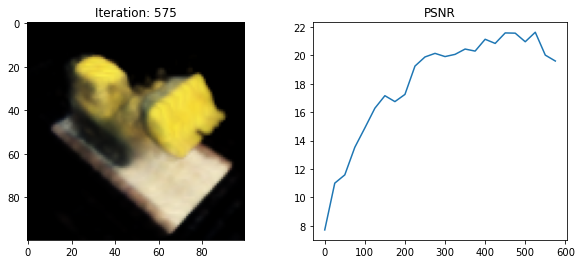

600 0.3901353931427002 secs per iter


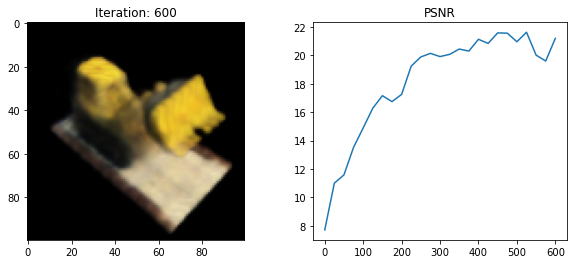

625 0.38849356651306155 secs per iter


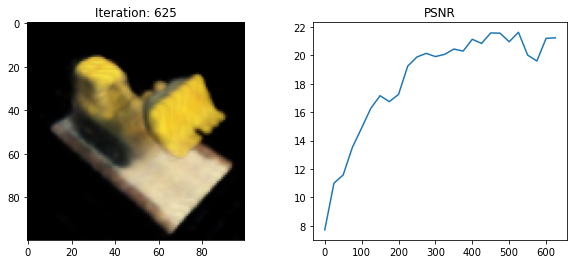

650 0.3885078239440918 secs per iter


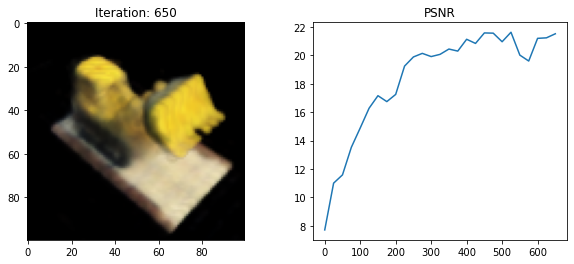

675 0.388896017074585 secs per iter


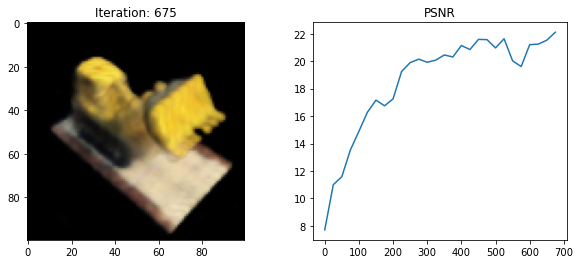

700 0.3914558124542236 secs per iter


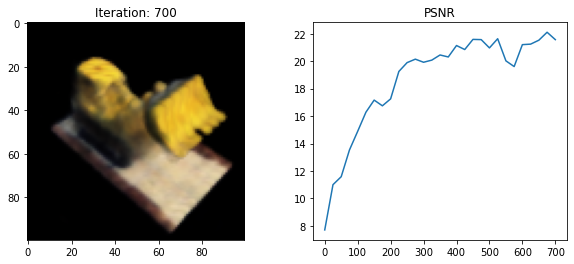

725 0.38870007514953614 secs per iter


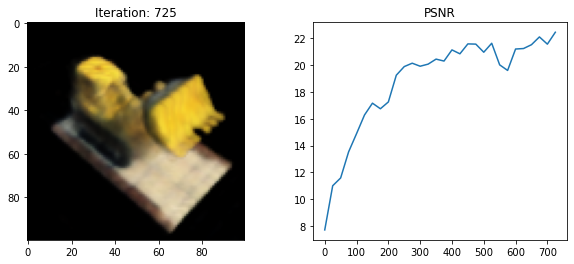

750 0.38851715087890626 secs per iter


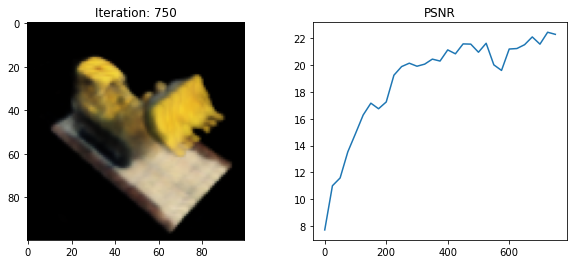

775 0.38805832862854006 secs per iter


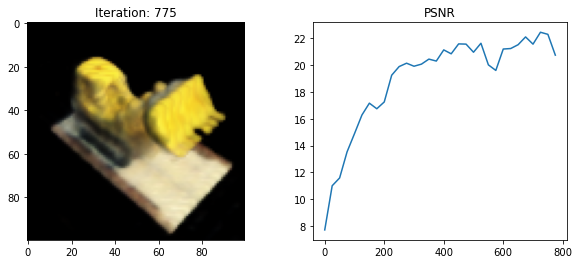

800 0.38778469085693357 secs per iter


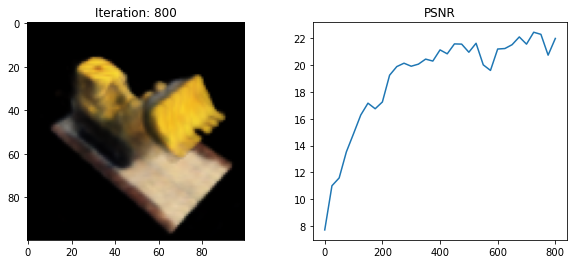

825 0.3904416561126709 secs per iter


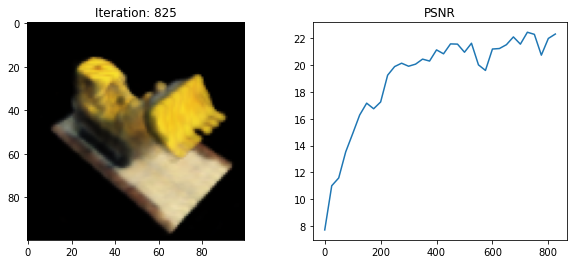

850 0.3877689743041992 secs per iter


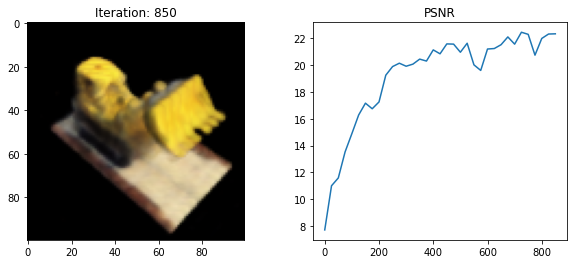

875 0.38978060722351077 secs per iter


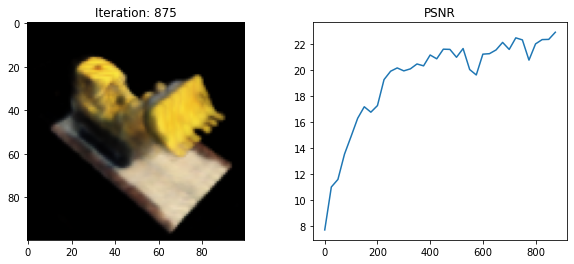

900 0.38861445426940916 secs per iter


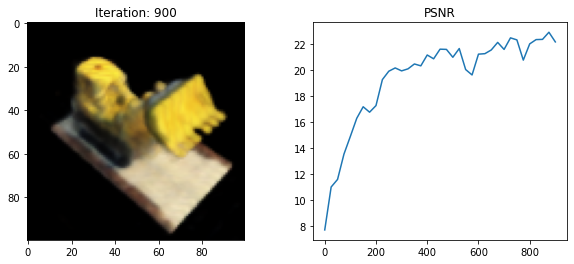

925 0.390470027923584 secs per iter


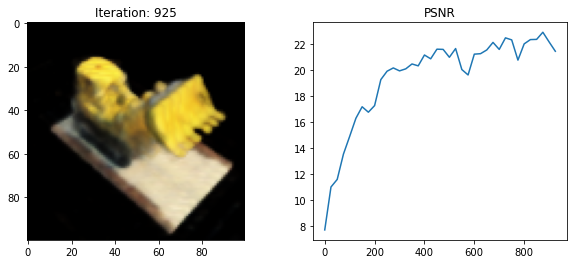

950 0.3884365463256836 secs per iter


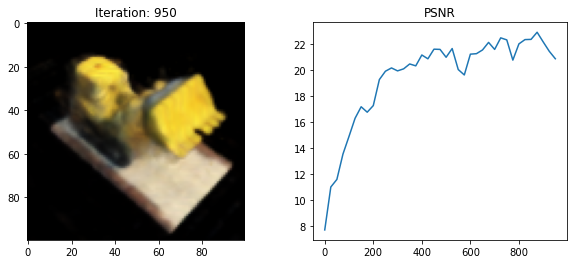

975 0.3876624870300293 secs per iter


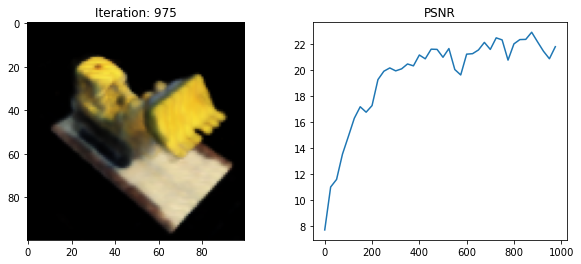

1000 0.38825968742370603 secs per iter


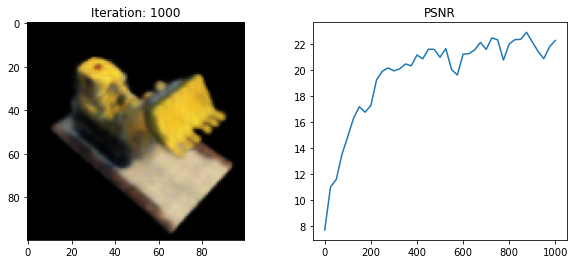

1025 0.3885007762908936 secs per iter


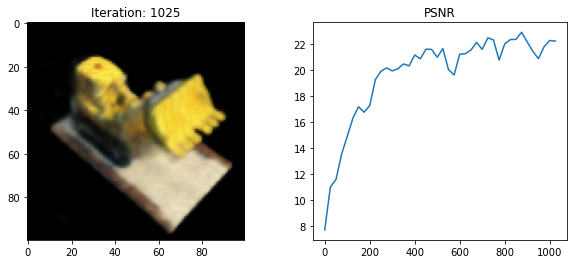

1050 0.390431547164917 secs per iter


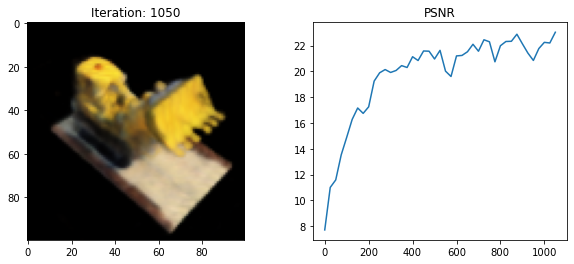

1075 0.38746813774108885 secs per iter


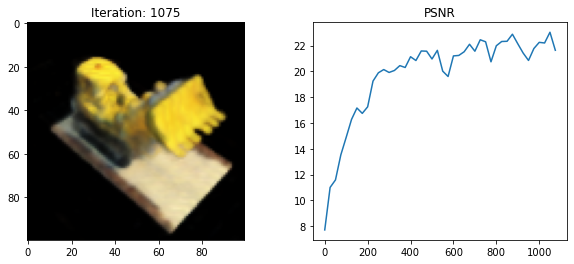

1100 0.3887935256958008 secs per iter


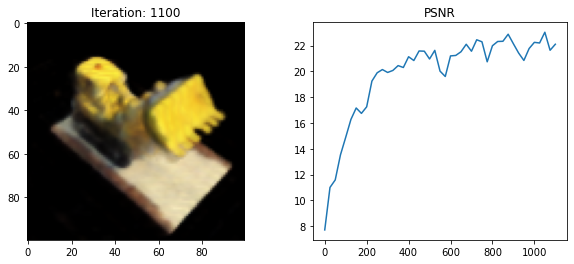

1125 0.3883126163482666 secs per iter


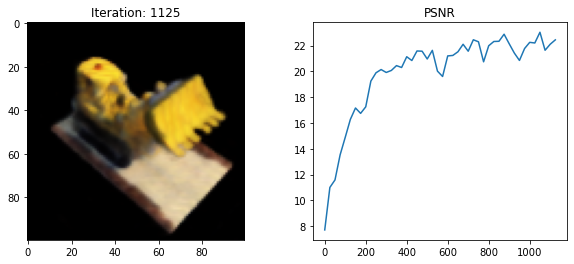

1150 0.39189647674560546 secs per iter


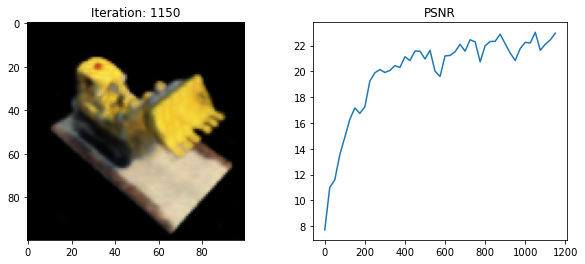

1175 0.390072193145752 secs per iter


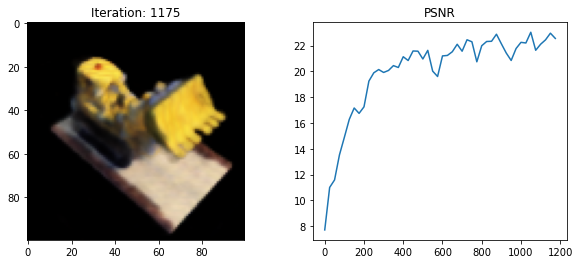

1200 0.3893687152862549 secs per iter


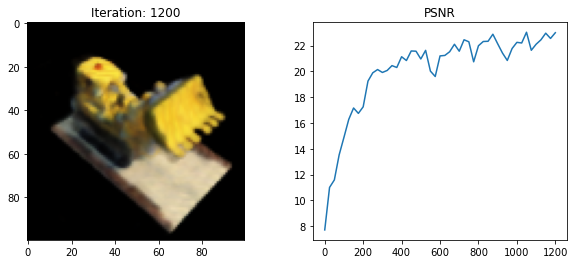

1225 0.3885577487945557 secs per iter


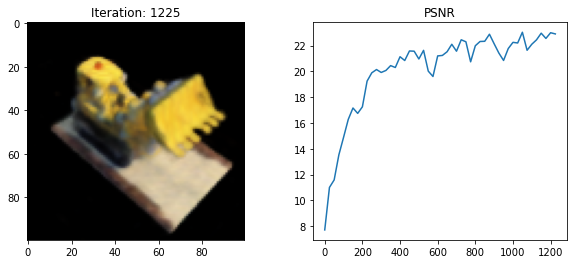

1250 0.38743560791015624 secs per iter


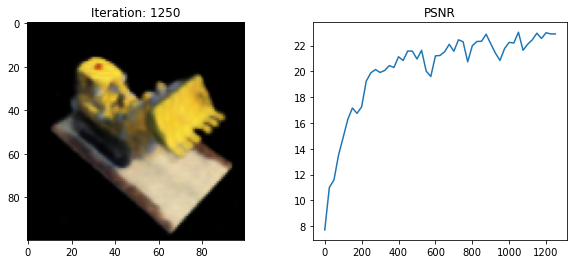

1275 0.3912556743621826 secs per iter


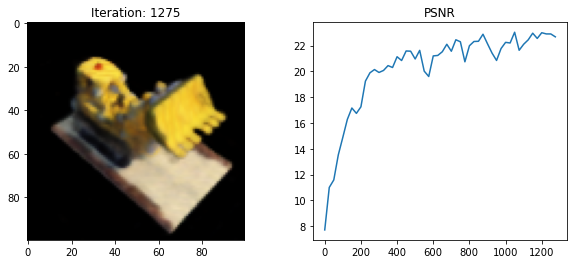

1300 0.3885283088684082 secs per iter


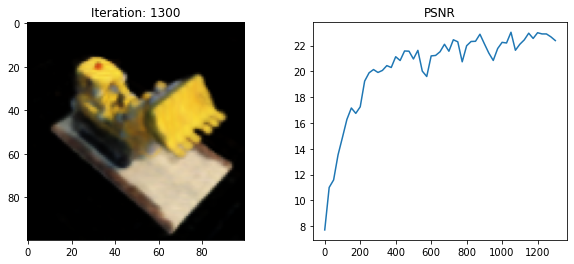

1325 0.38817423820495606 secs per iter


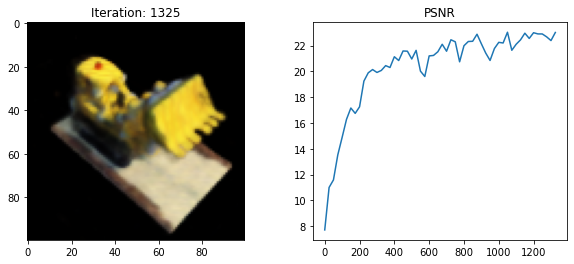

1350 0.38915817260742186 secs per iter


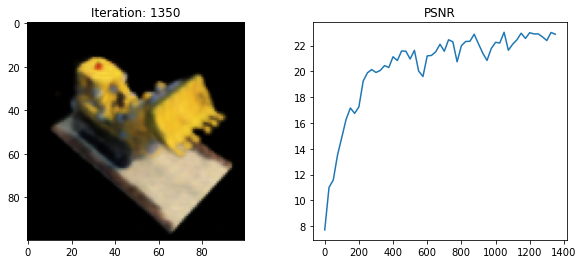

1375 0.3910573673248291 secs per iter


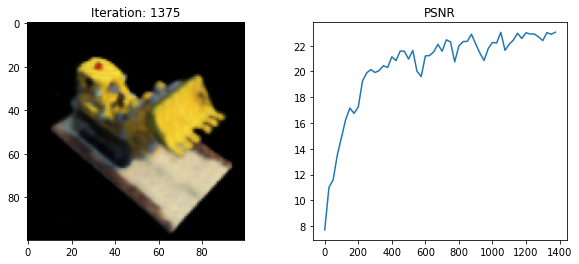

1400 0.387710657119751 secs per iter


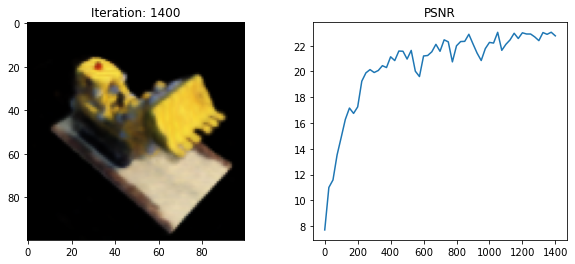

1425 0.3891818618774414 secs per iter


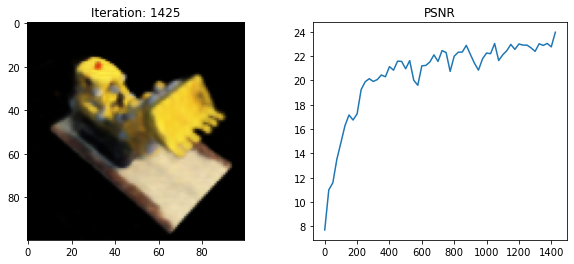

1450 0.3899259090423584 secs per iter


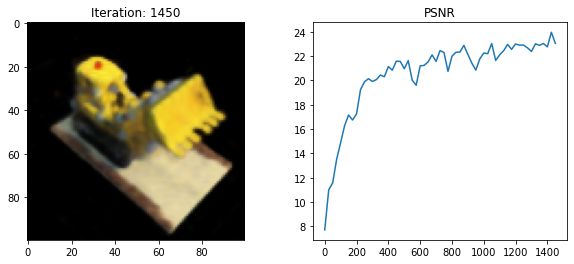

1475 0.39100902557373046 secs per iter


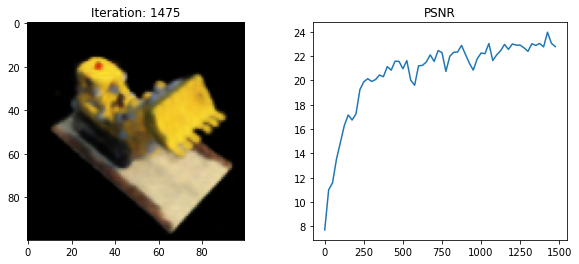

1500 0.3935082721710205 secs per iter


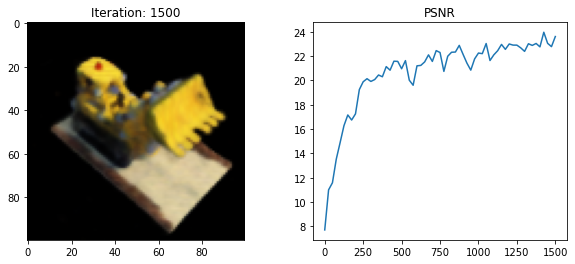

1525 0.3902411937713623 secs per iter


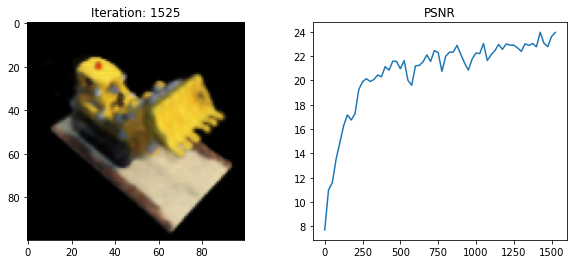

1550 0.39053183555603027 secs per iter


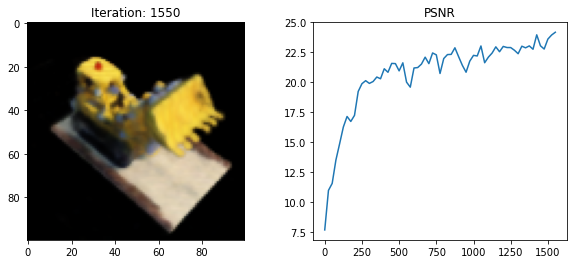

1575 0.39046172142028807 secs per iter


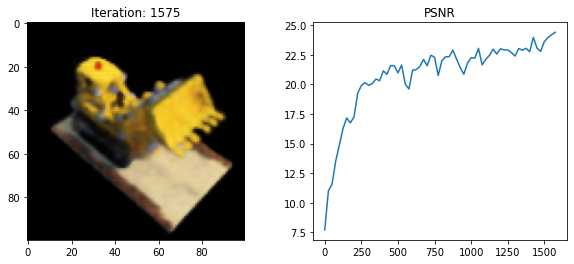

1600 0.3930150318145752 secs per iter


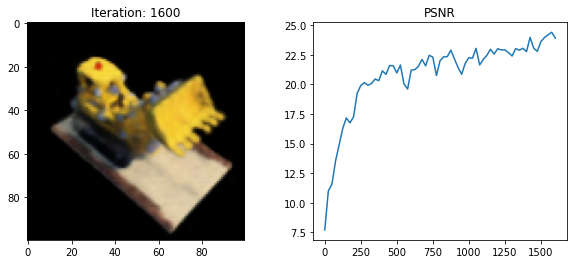

1625 0.3904133701324463 secs per iter


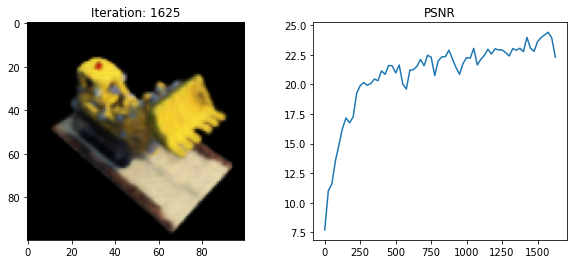

1650 0.39012521743774414 secs per iter


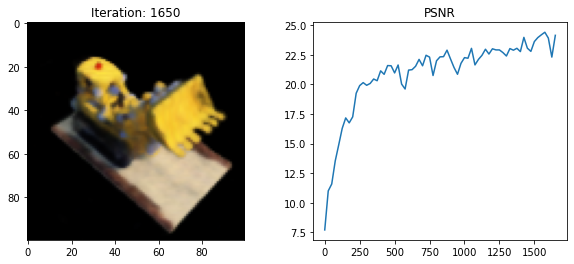

1675 0.38973431587219237 secs per iter


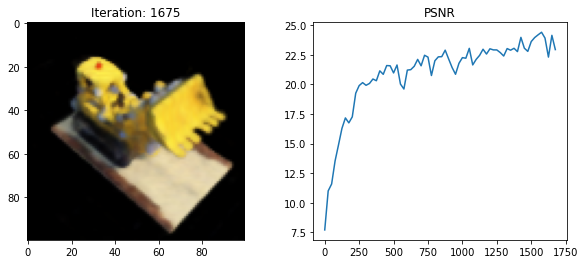

1700 0.39014997482299807 secs per iter


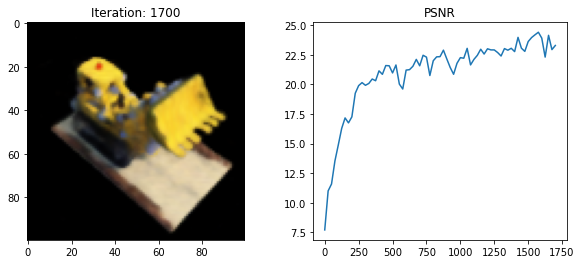

1725 0.3923047065734863 secs per iter


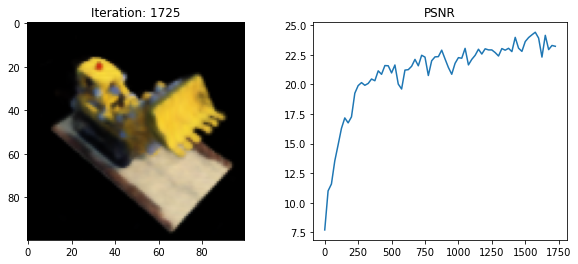

1750 0.3903832054138184 secs per iter


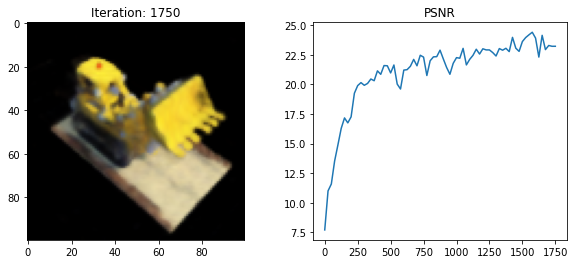

1775 0.3888275241851807 secs per iter


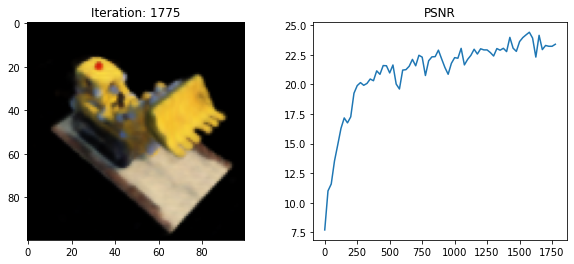

1800 0.3923018836975098 secs per iter


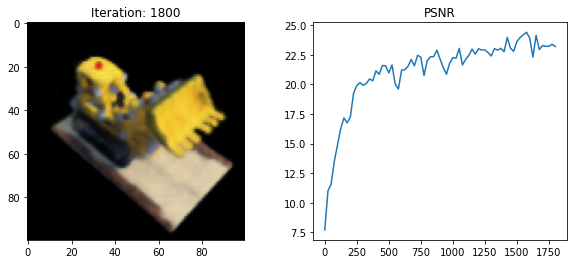

1825 0.3927153205871582 secs per iter


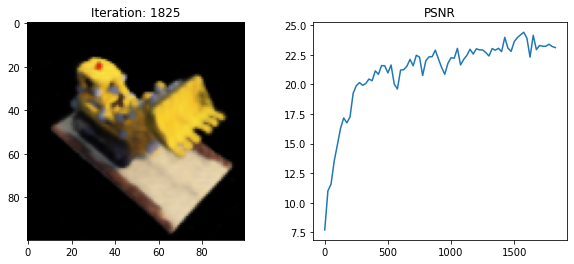

1850 0.3890368938446045 secs per iter


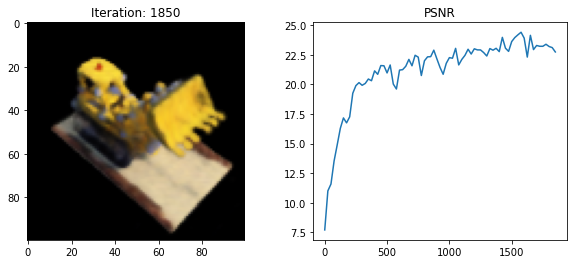

1875 0.38958858489990233 secs per iter


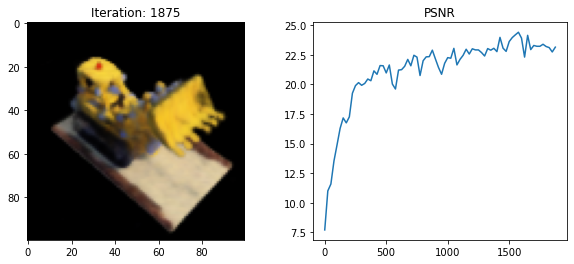

1900 0.389757719039917 secs per iter


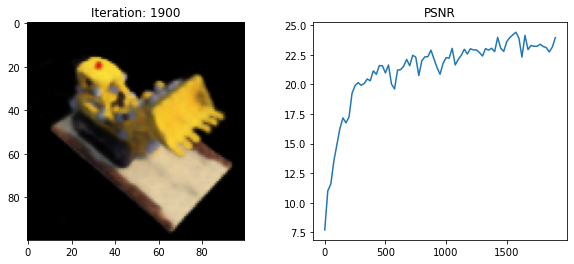

1925 0.3893579864501953 secs per iter


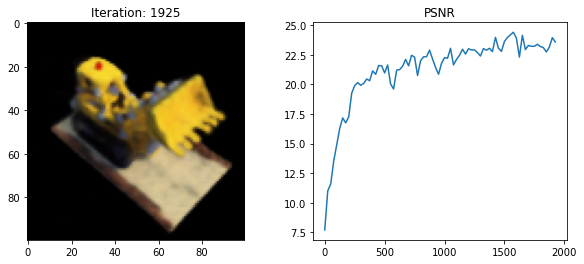

1950 0.39258846282958987 secs per iter


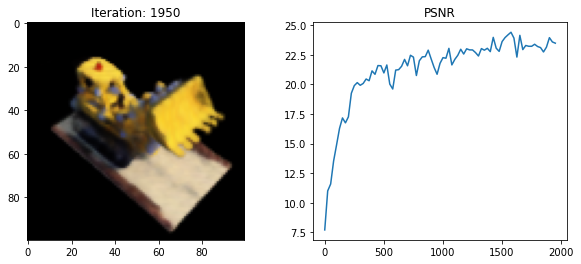

1975 0.39027243614196777 secs per iter


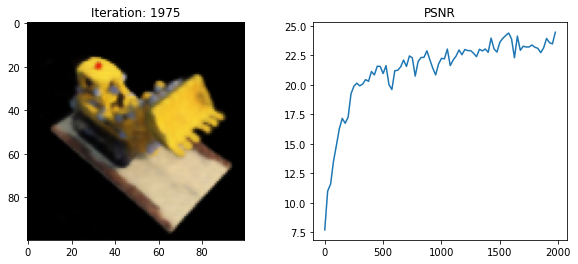

2000 0.3900569725036621 secs per iter


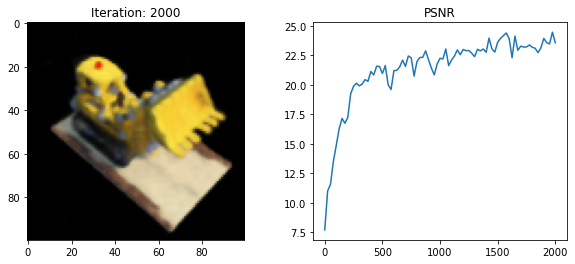

2025 0.39022638320922853 secs per iter


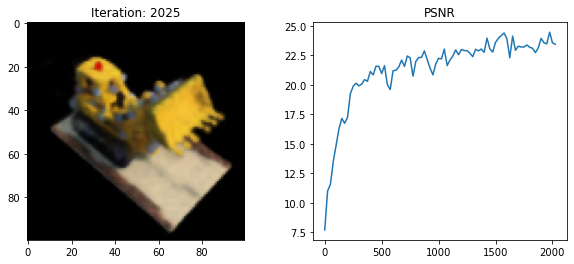

2050 0.39167692184448244 secs per iter


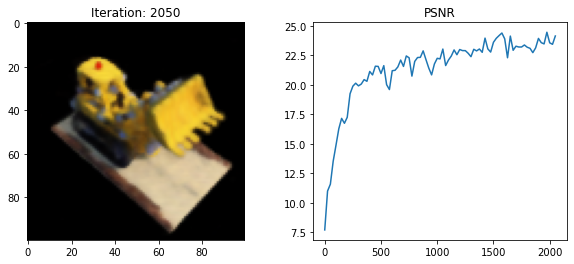

2075 0.39028029441833495 secs per iter


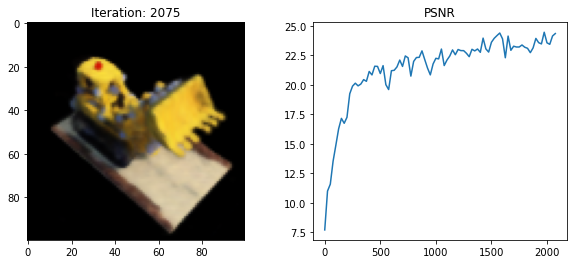

2100 0.391746883392334 secs per iter


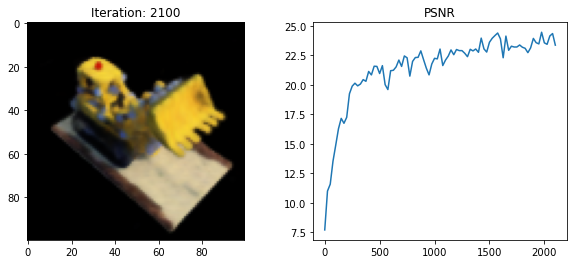

2125 0.39009818077087405 secs per iter


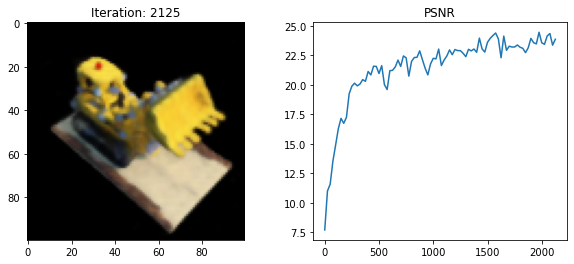

2150 0.3890736198425293 secs per iter


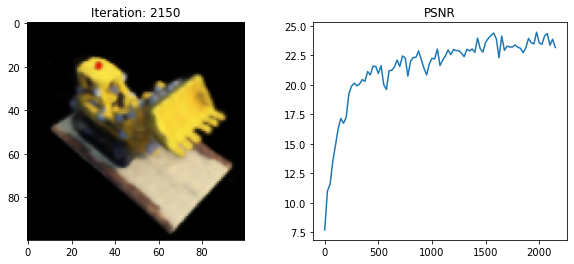

2175 0.3931864833831787 secs per iter


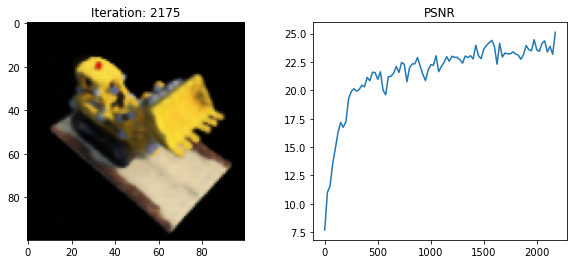

2200 0.3896178150177002 secs per iter


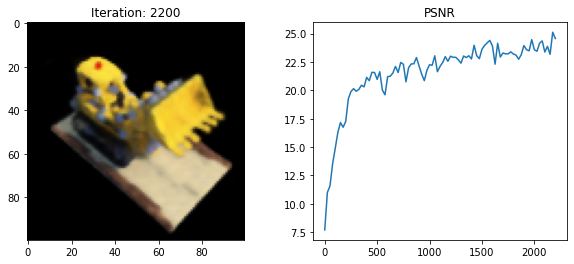

2225 0.3895594024658203 secs per iter


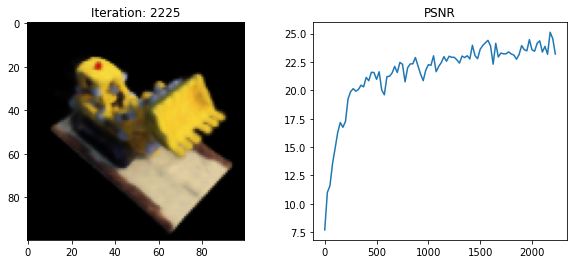

2250 0.3886205577850342 secs per iter


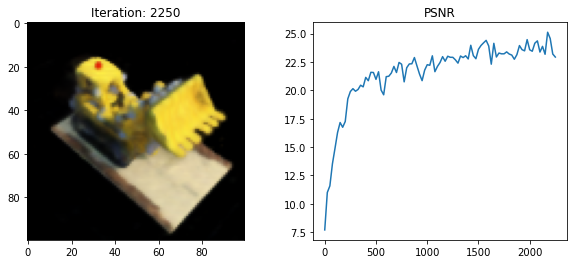

2275 0.3921364402770996 secs per iter


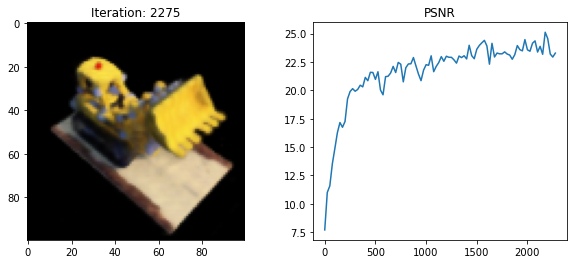

2300 0.39016338348388674 secs per iter


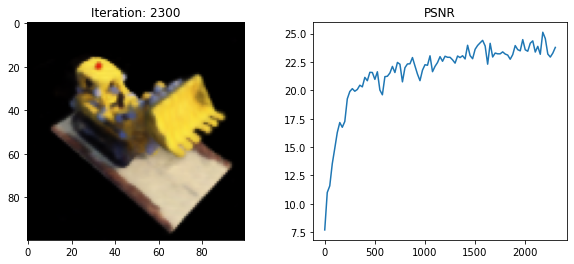

2325 0.3897706604003906 secs per iter


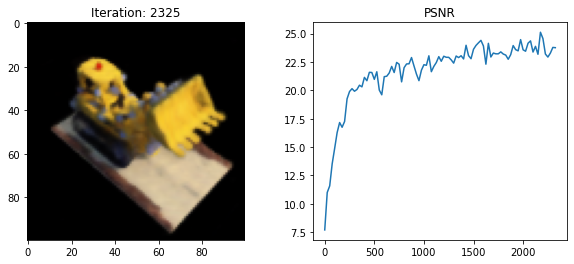

2350 0.39037171363830564 secs per iter


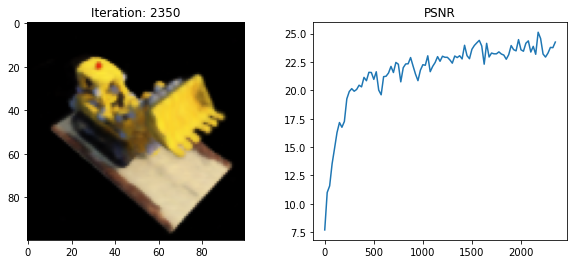

2375 0.38971327781677245 secs per iter


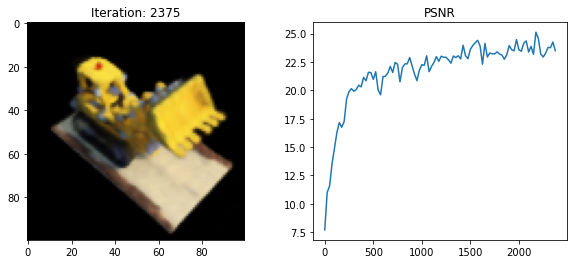

2400 0.3938606834411621 secs per iter


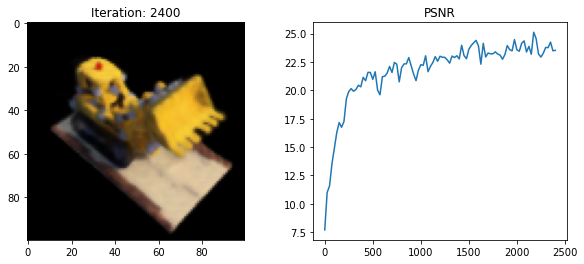

2425 0.39085921287536624 secs per iter


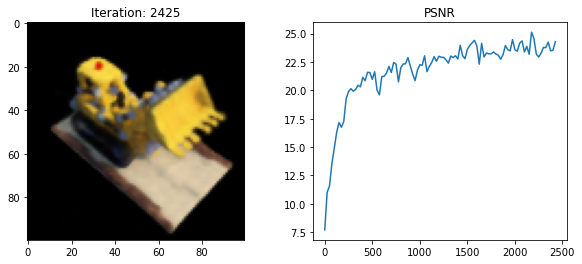

2450 0.390044527053833 secs per iter


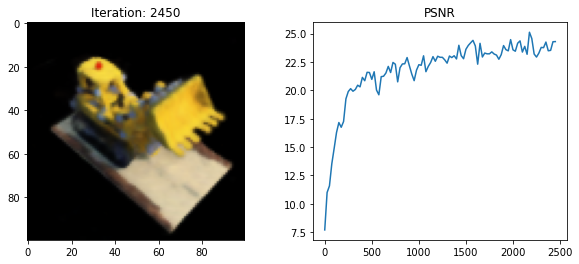

2475 0.3901500701904297 secs per iter


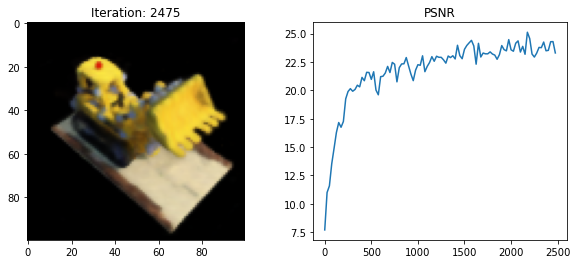

2500 0.3929153060913086 secs per iter


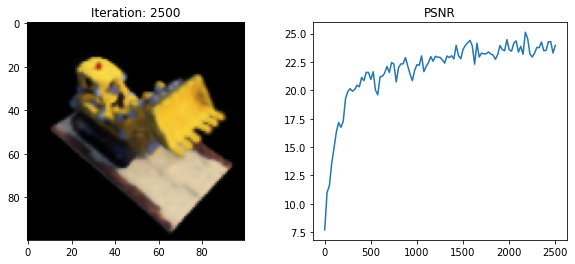

2525 0.3897404193878174 secs per iter


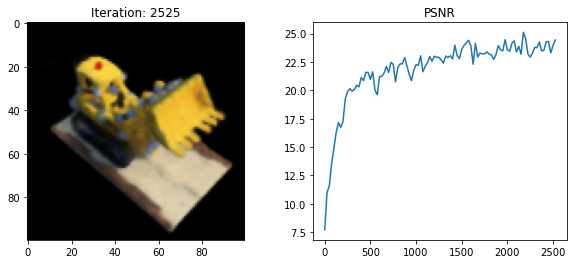

2550 0.3900034999847412 secs per iter


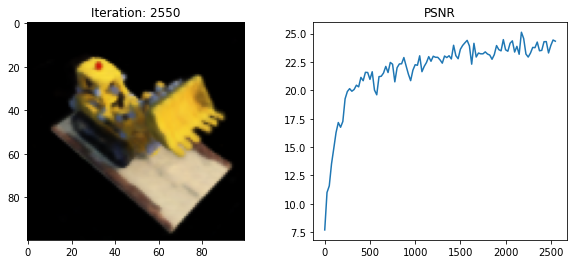

2575 0.38964646339416503 secs per iter


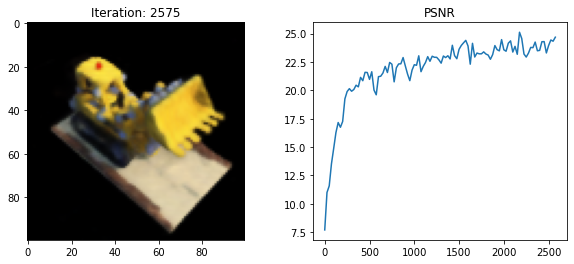

2600 0.3893465137481689 secs per iter


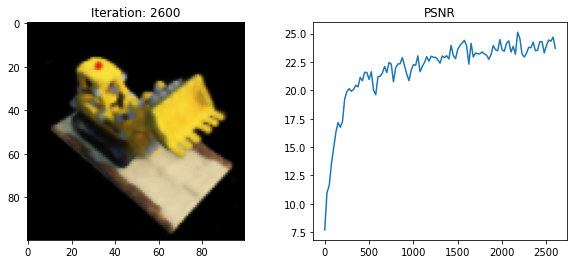

2625 0.39333885192871093 secs per iter


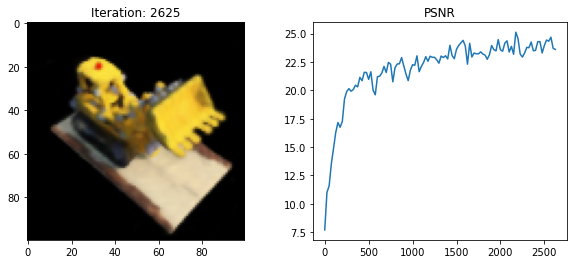

2650 0.38937136650085447 secs per iter


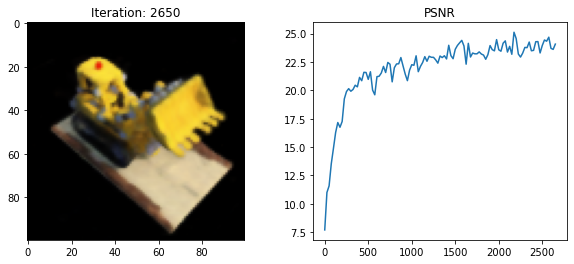

2675 0.3903961086273193 secs per iter


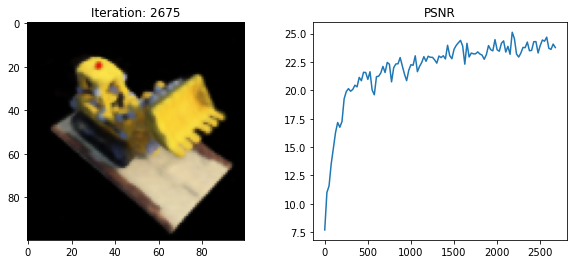

2700 0.3905345344543457 secs per iter


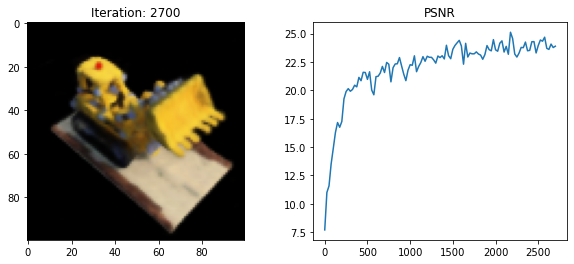

2725 0.39338265419006346 secs per iter


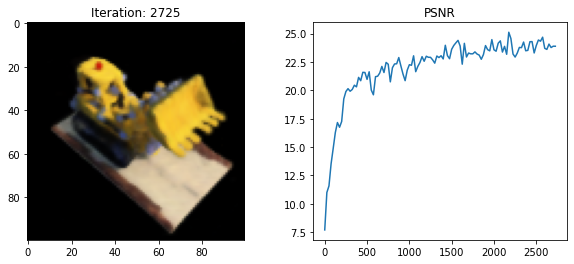

2750 0.39011124610900877 secs per iter


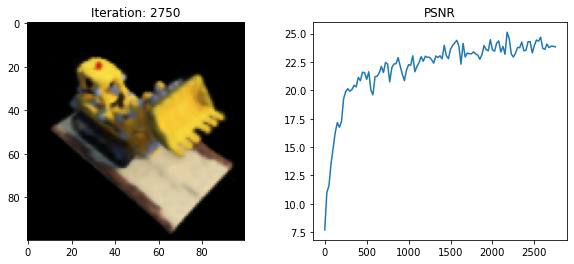

2775 0.3900260066986084 secs per iter


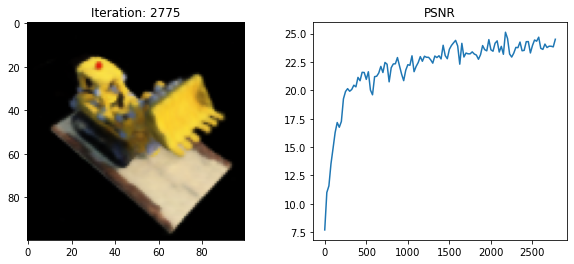

2800 0.3898105812072754 secs per iter


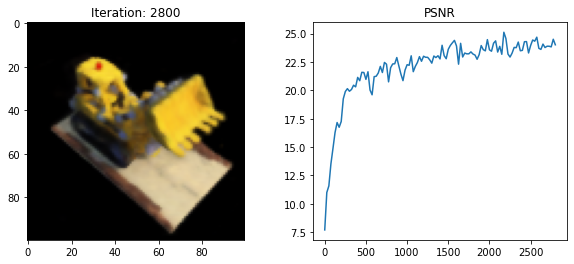

2825 0.39046541213989255 secs per iter


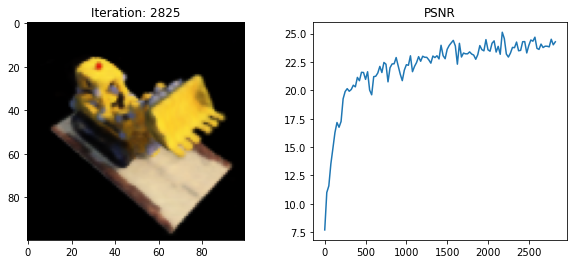

2850 0.39261661529541014 secs per iter


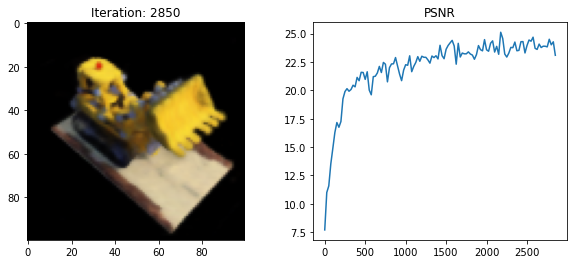

2875 0.3901220989227295 secs per iter


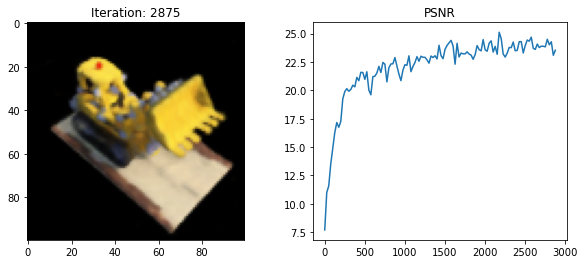

2900 0.39081171989440916 secs per iter


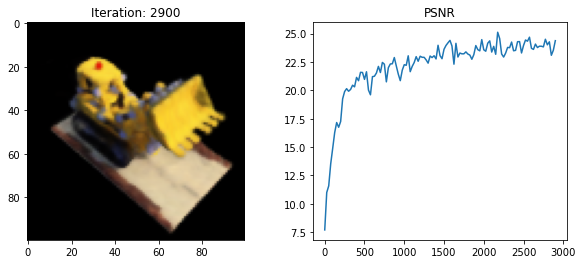

2925 0.39048200607299804 secs per iter


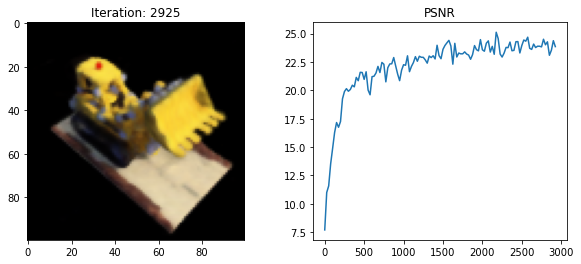

2950 0.39350284576416017 secs per iter


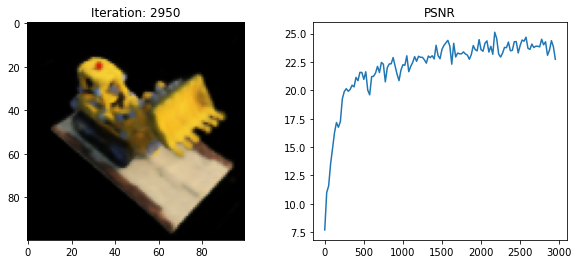

2975 0.3906624031066894 secs per iter


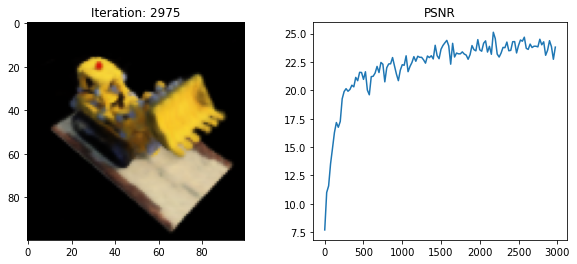

3000 0.39089529037475584 secs per iter


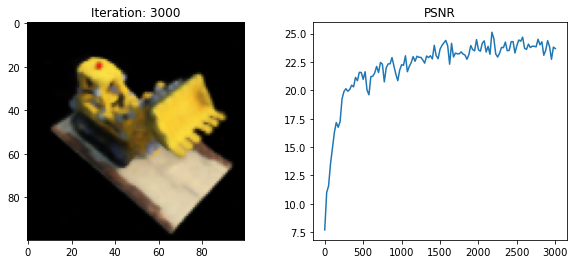

3025 0.3910006332397461 secs per iter


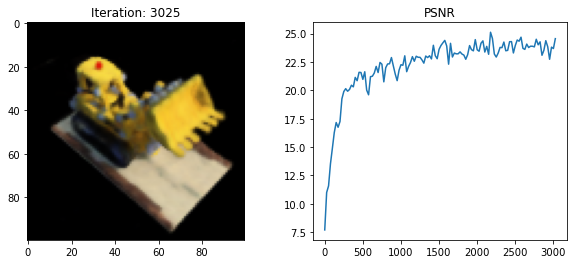

3050 0.39003403663635255 secs per iter


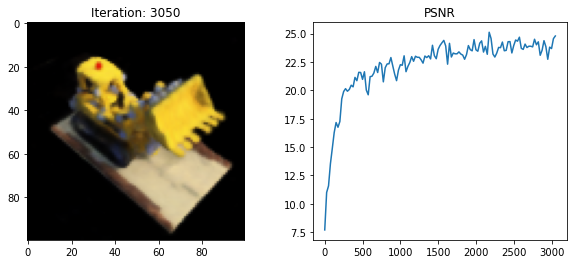

3075 0.3932306098937988 secs per iter


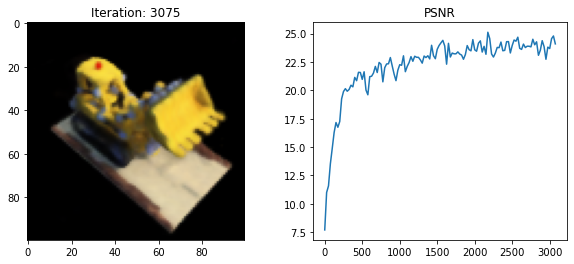

3100 0.3903461742401123 secs per iter


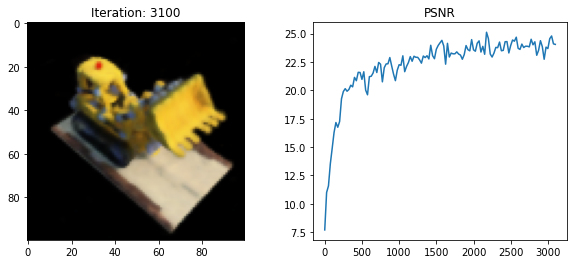

3125 0.389957103729248 secs per iter


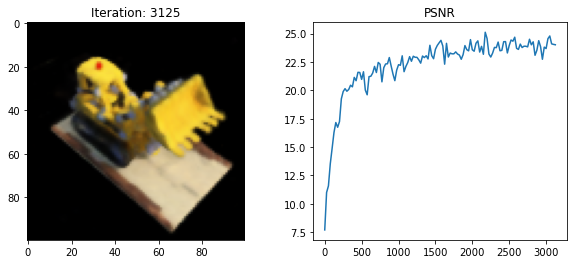

3150 0.39023647308349607 secs per iter


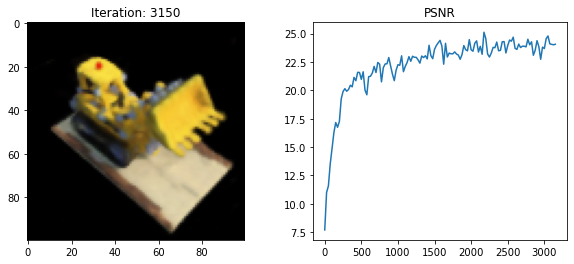

3175 0.3924803066253662 secs per iter


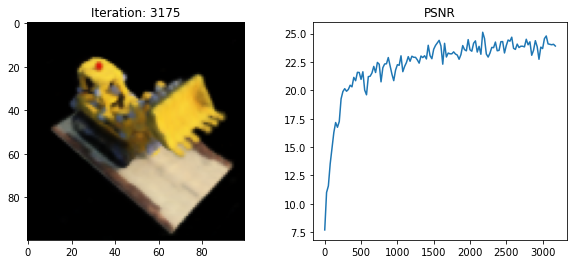

3200 0.3898425960540772 secs per iter


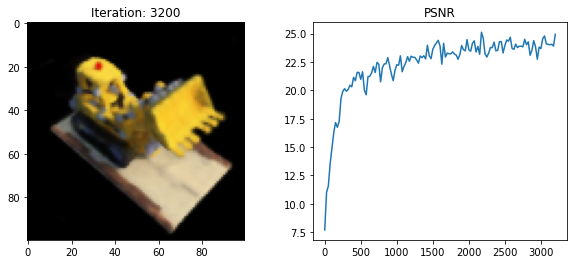

3225 0.3904195022583008 secs per iter


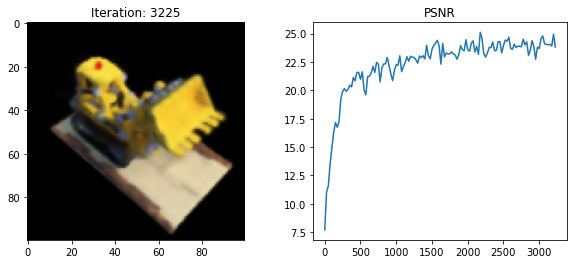

3250 0.3907028865814209 secs per iter


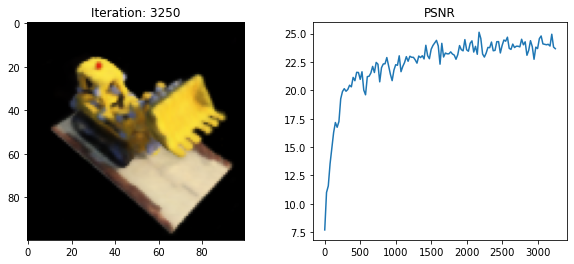

3275 0.38991378784179687 secs per iter


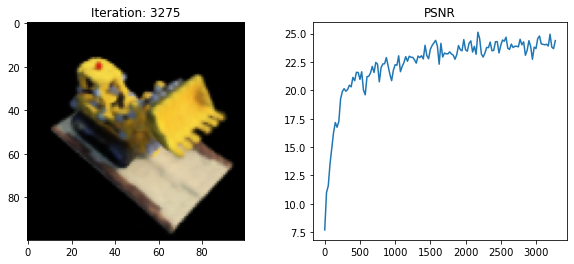

3300 0.39244019508361816 secs per iter


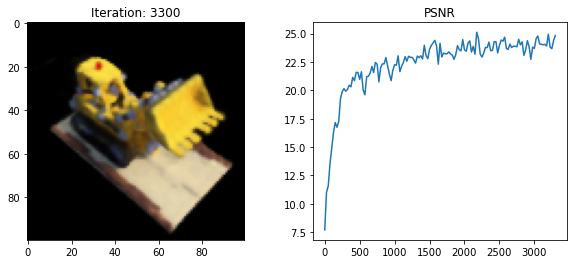

3325 0.3917082405090332 secs per iter


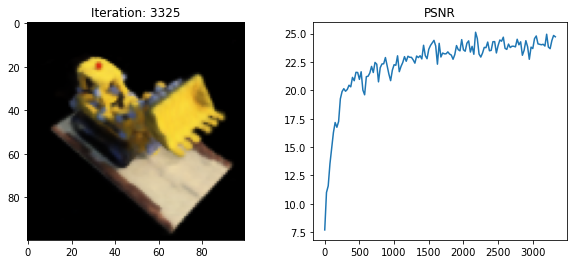

3350 0.3902851009368897 secs per iter


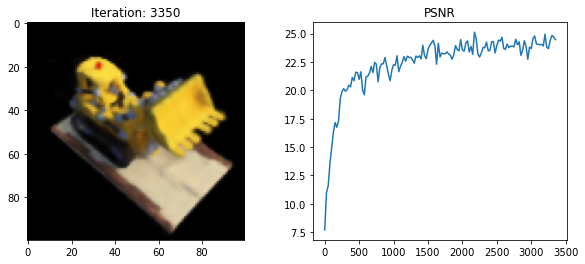

3375 0.3898788642883301 secs per iter


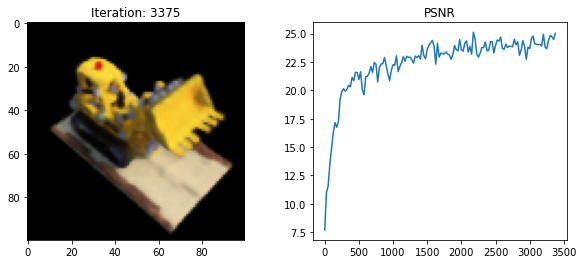

3400 0.3925166988372803 secs per iter


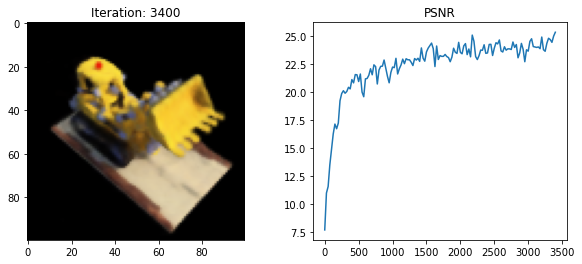

3425 0.39092579841613767 secs per iter


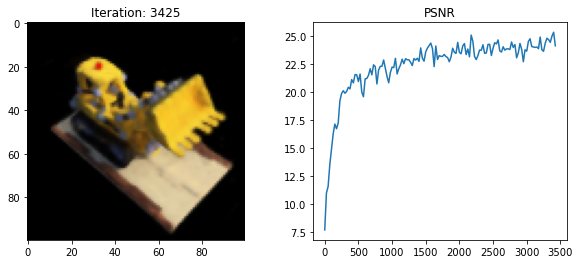

3450 0.38936219215393064 secs per iter


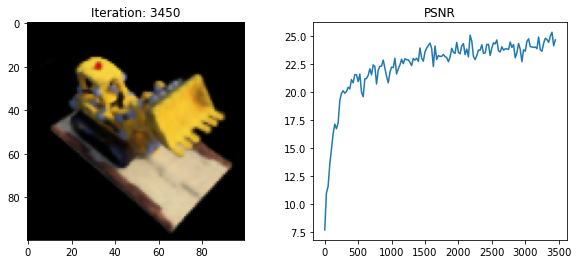

3475 0.3900226306915283 secs per iter


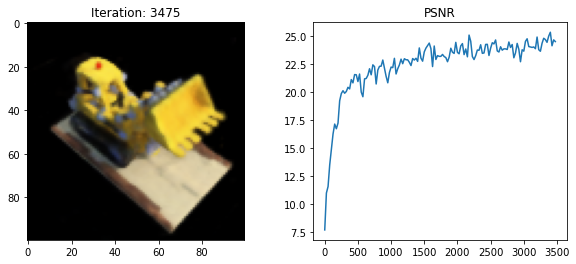

3500 0.3903828716278076 secs per iter


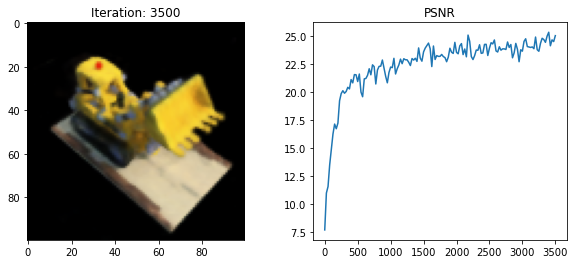

3525 0.39303542137145997 secs per iter


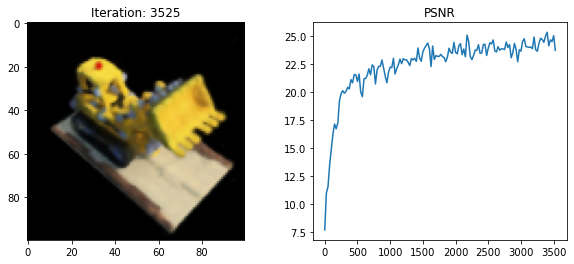

3550 0.39088939666748046 secs per iter


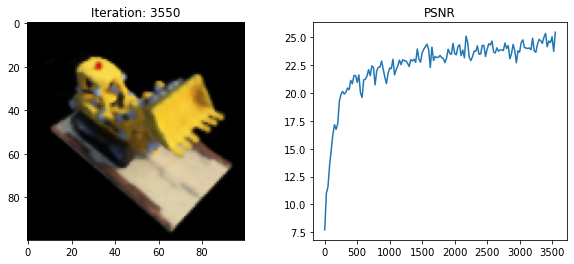

3575 0.39098896980285647 secs per iter


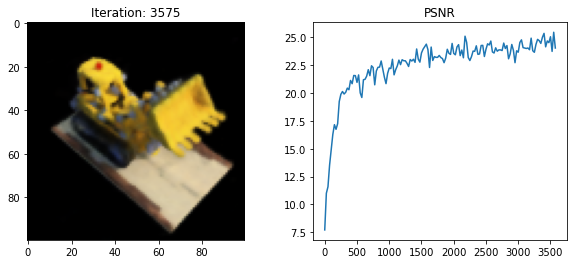

3600 0.39044631004333497 secs per iter


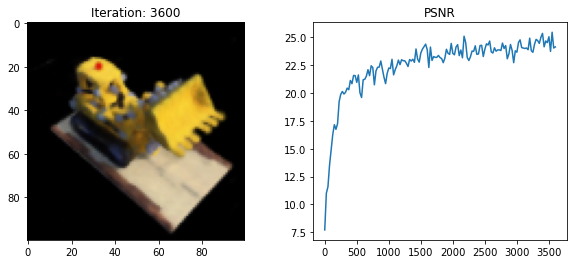

3625 0.39423815727233885 secs per iter


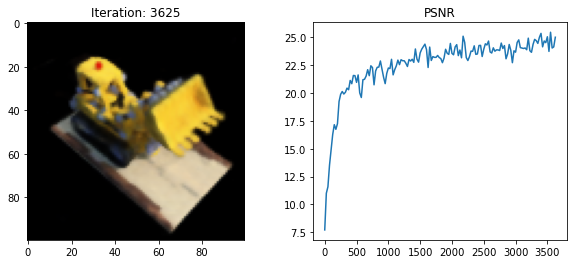

3650 0.3908901596069336 secs per iter


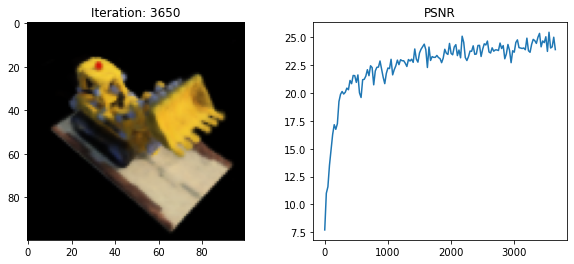

3675 0.3897856330871582 secs per iter


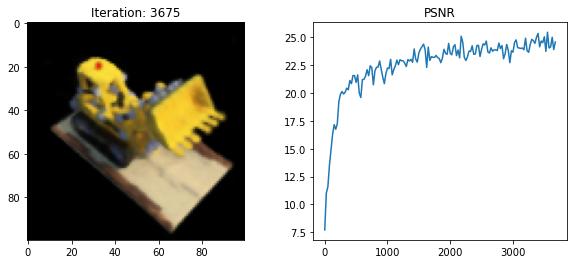

3700 0.3901287364959717 secs per iter


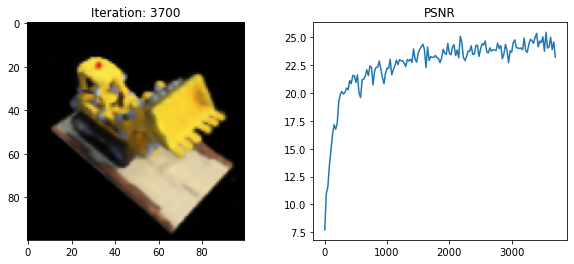

3725 0.3897910785675049 secs per iter


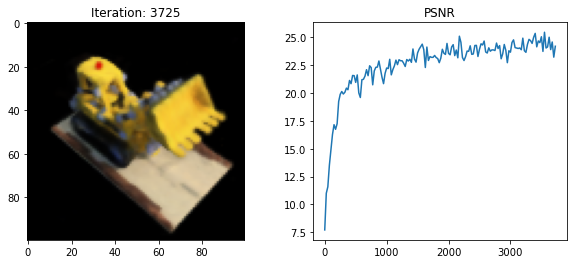

3750 0.39252243041992185 secs per iter


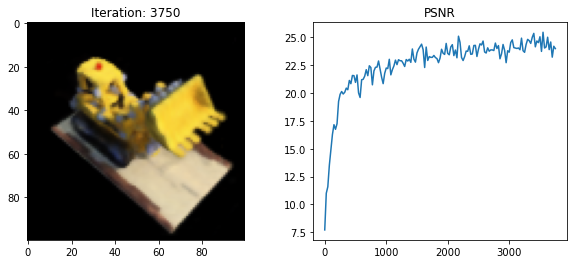

3775 0.39001477241516114 secs per iter


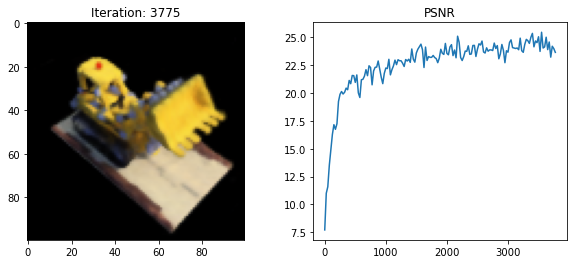

3800 0.3896208477020264 secs per iter


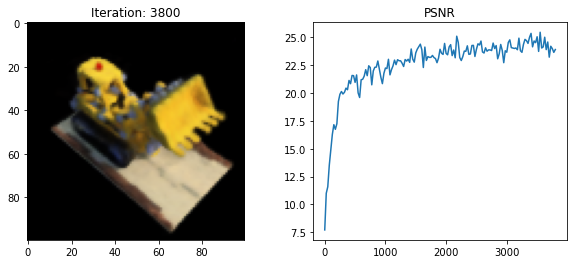

3825 0.38937700271606446 secs per iter


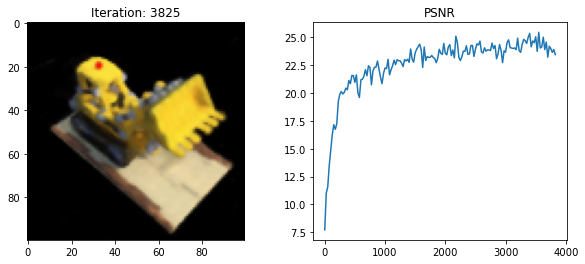

3850 0.39218563079833985 secs per iter


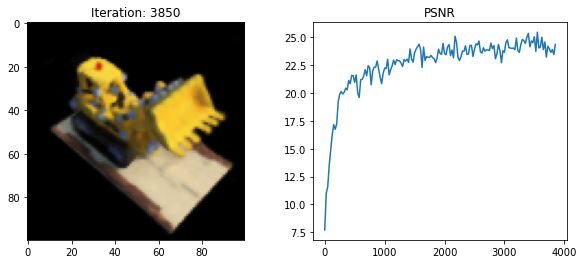

3875 0.39010507583618165 secs per iter


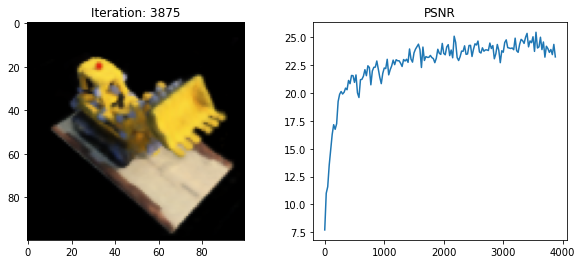

3900 0.3897313117980957 secs per iter


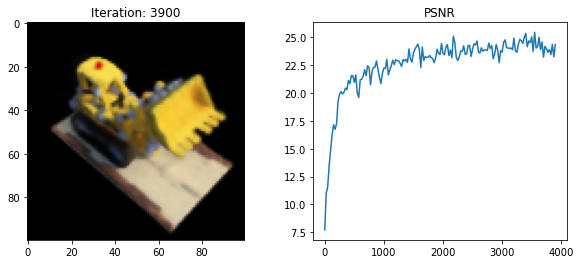

3925 0.38936389923095704 secs per iter


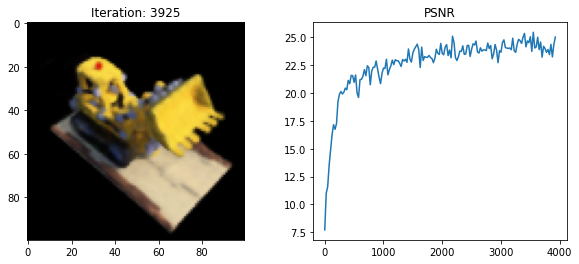

3950 0.39184444427490234 secs per iter


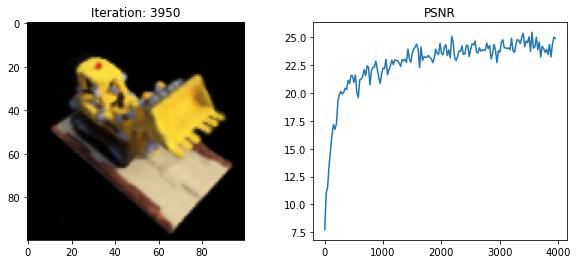

3975 0.3925387954711914 secs per iter


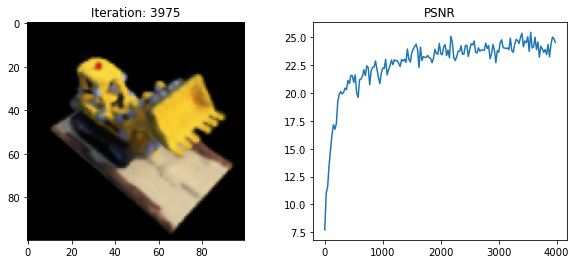

4000 0.38899858474731447 secs per iter


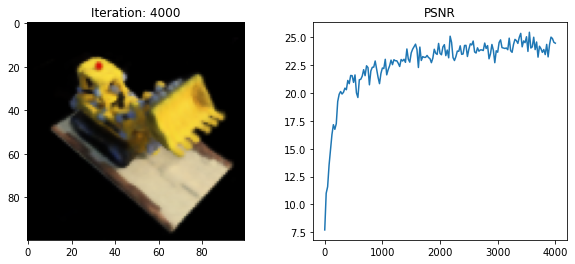

4025 0.3908458518981934 secs per iter


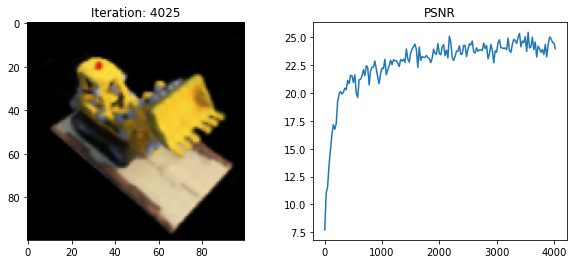

4050 0.3894146823883057 secs per iter


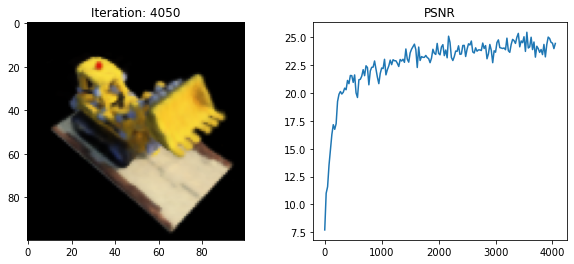

4075 0.39103269577026367 secs per iter


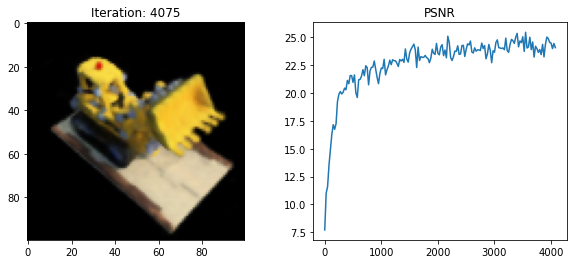

4100 0.3899843406677246 secs per iter


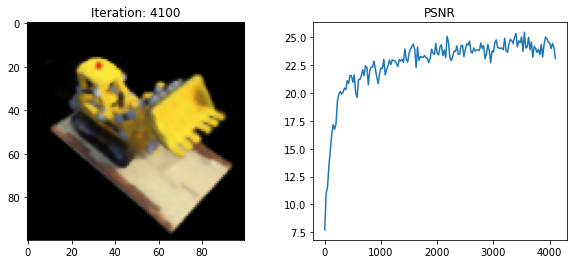

4125 0.3902114200592041 secs per iter


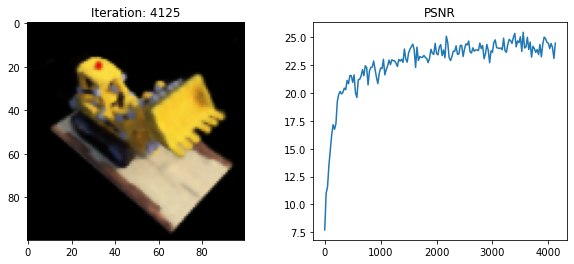

4150 0.38919434547424314 secs per iter


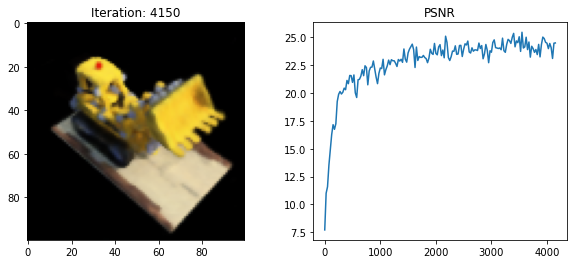

4175 0.39054226875305176 secs per iter


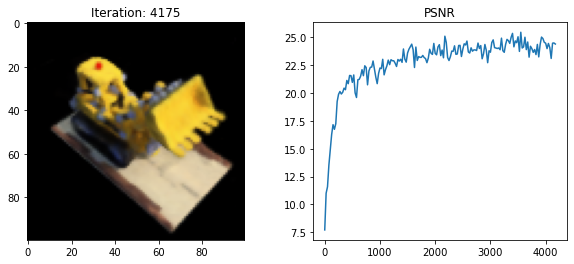

4200 0.3921979522705078 secs per iter


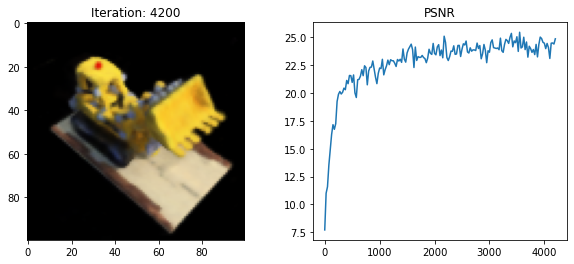

4225 0.38977168083190916 secs per iter


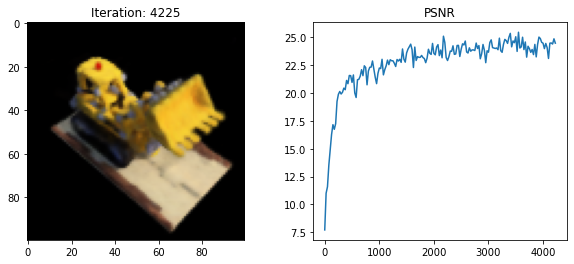

4250 0.39170132637023924 secs per iter


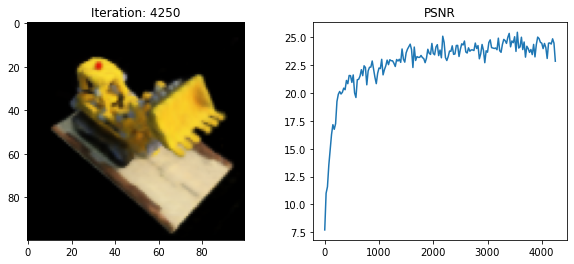

4275 0.3901648426055908 secs per iter


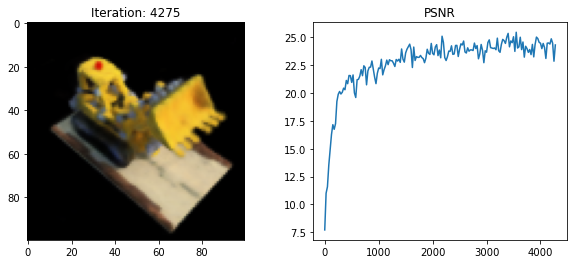

4300 0.3926223659515381 secs per iter


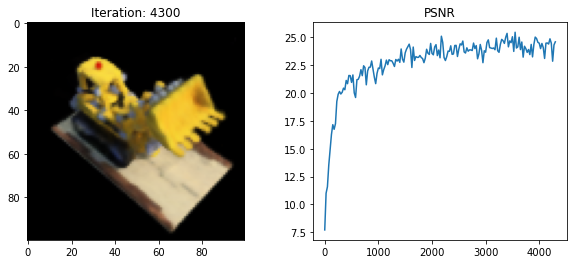

4325 0.3899825382232666 secs per iter


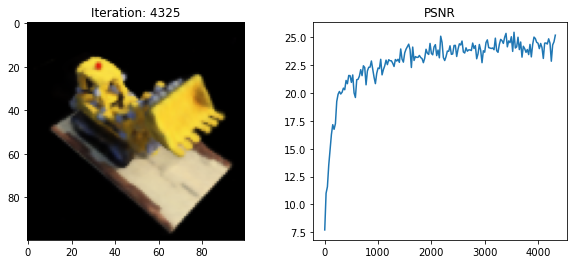

4350 0.39026230812072754 secs per iter


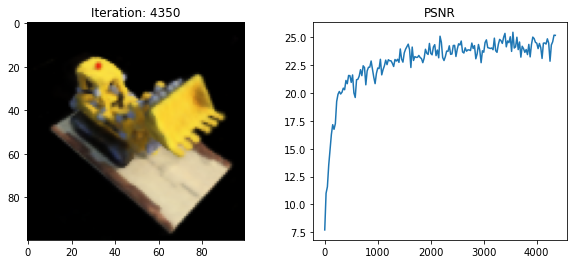

4375 0.38936491012573243 secs per iter


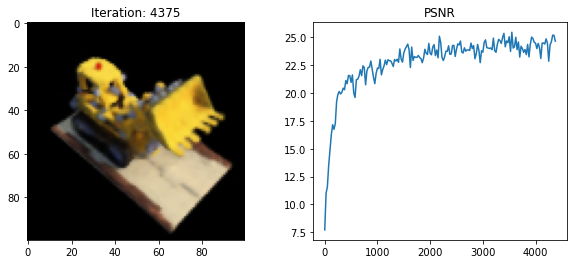

4400 0.3897279453277588 secs per iter


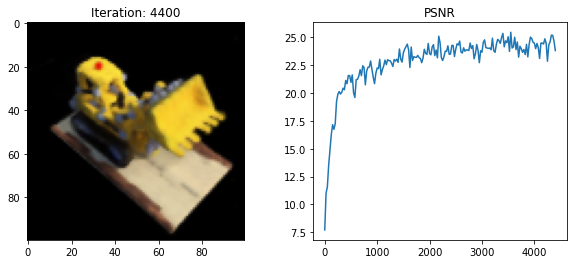

4425 0.392142972946167 secs per iter


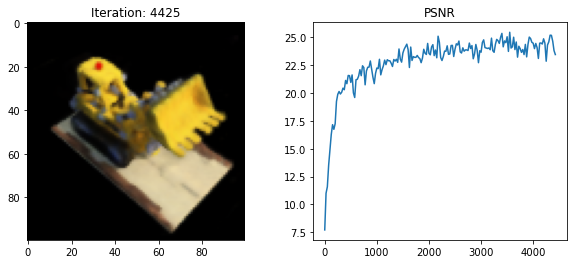

4450 0.3901508903503418 secs per iter


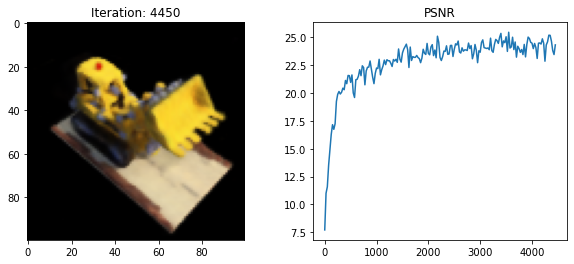

4475 0.3901554298400879 secs per iter


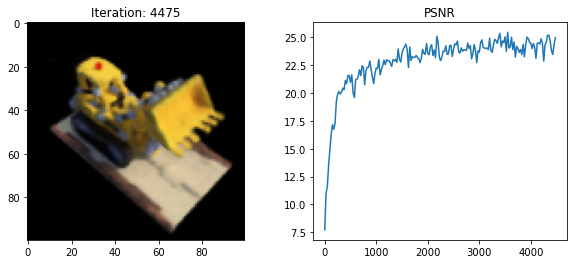

4500 0.3896790027618408 secs per iter


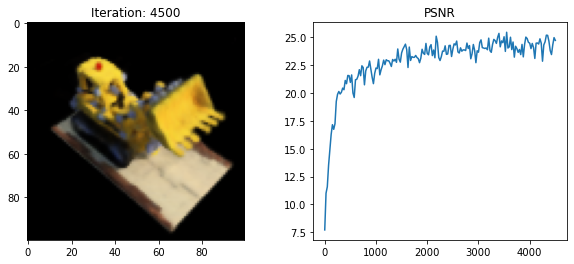

4525 0.3917313861846924 secs per iter


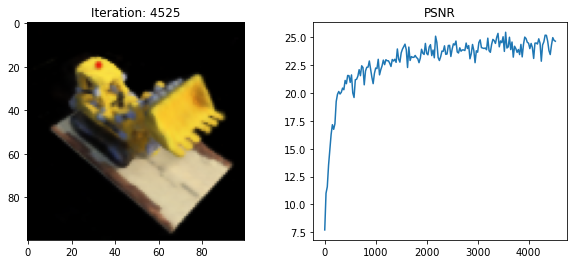

4550 0.39146052360534667 secs per iter


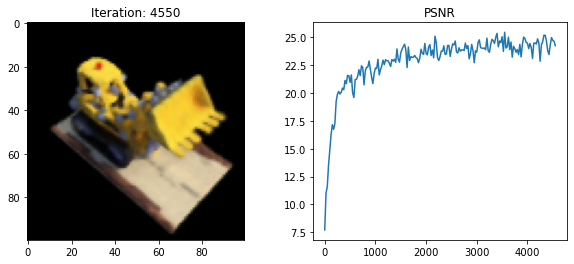

4575 0.3907822895050049 secs per iter


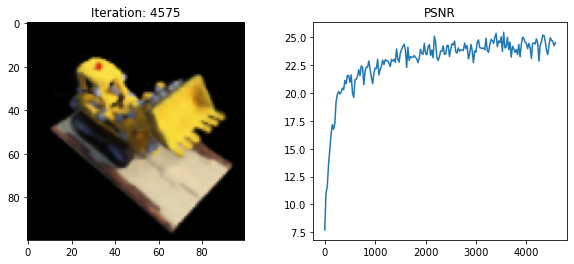

4600 0.38910508155822754 secs per iter


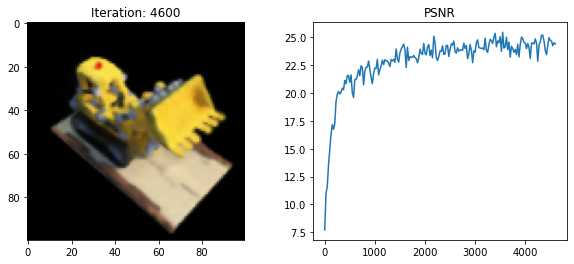

4625 0.39060388565063475 secs per iter


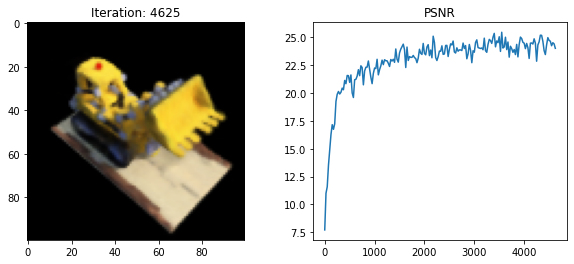

4650 0.39255706787109373 secs per iter


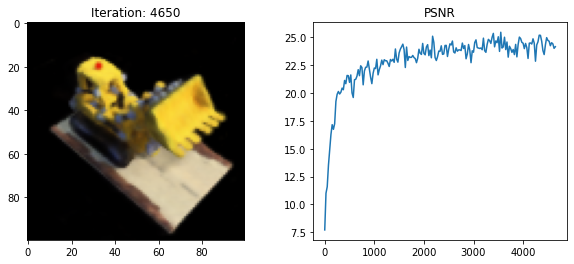

4675 0.3904716110229492 secs per iter


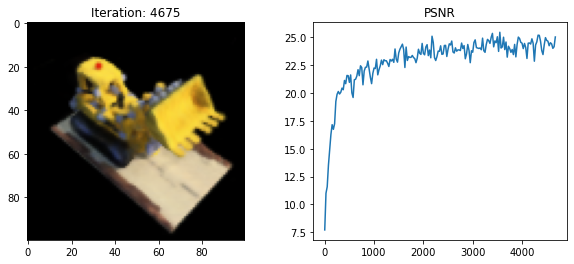

4700 0.3889393615722656 secs per iter


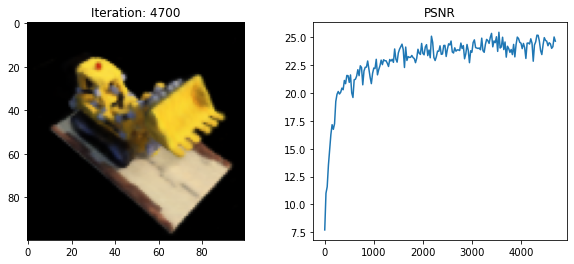

4725 0.38930502891540525 secs per iter


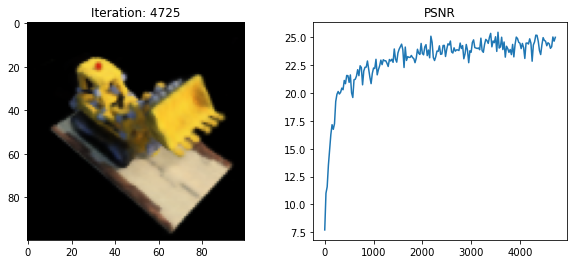

4750 0.3920054626464844 secs per iter


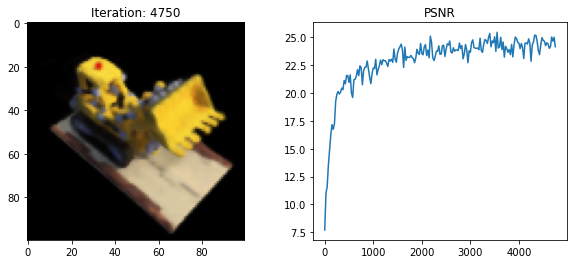

4775 0.38980324745178224 secs per iter


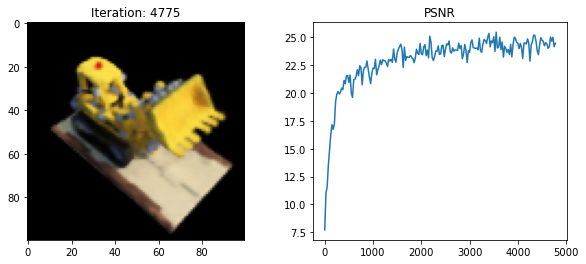

4800 0.3900006866455078 secs per iter


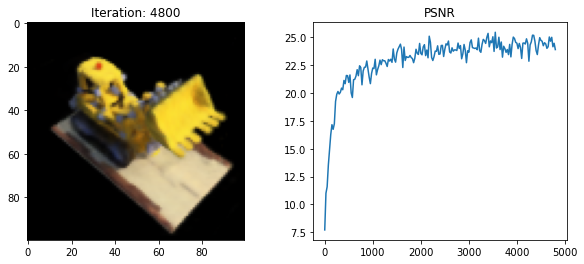

4825 0.39012099266052247 secs per iter


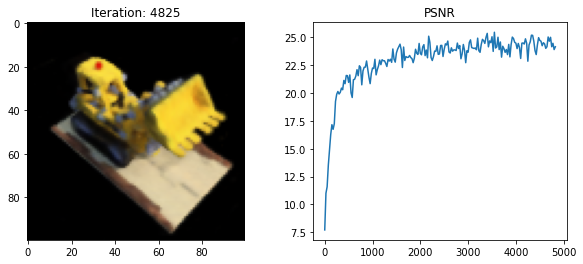

4850 0.39087903022766113 secs per iter


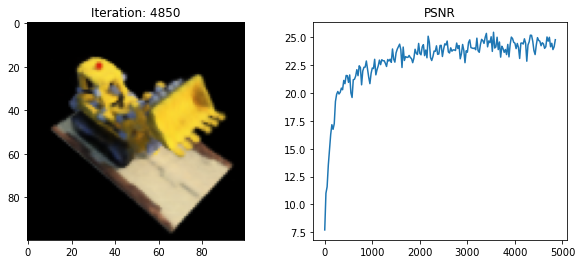

4875 0.39303504943847656 secs per iter


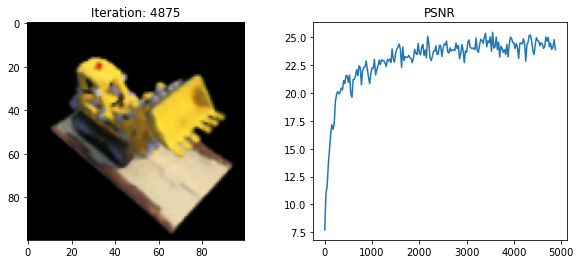

4900 0.3901403617858887 secs per iter


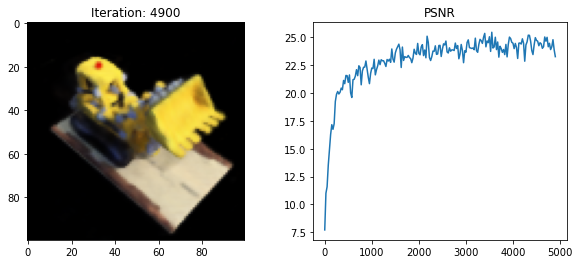

4925 0.3901687240600586 secs per iter


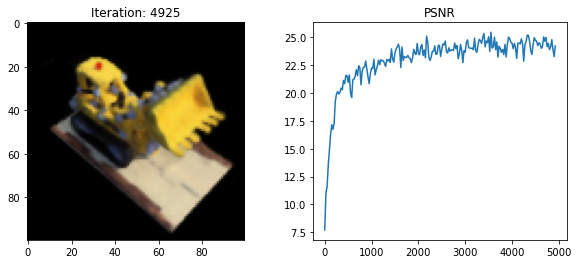

4950 0.39046029090881346 secs per iter


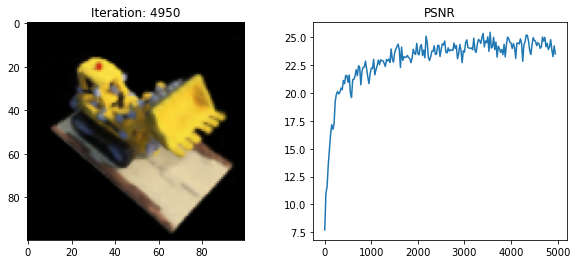

4975 0.39282341957092287 secs per iter


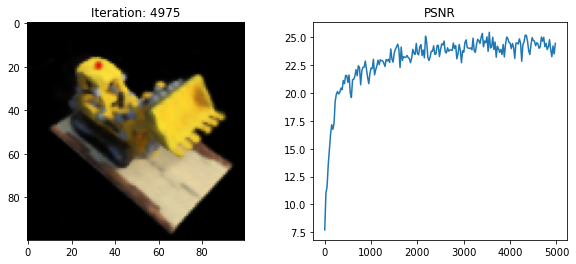

5000 0.39006977081298827 secs per iter


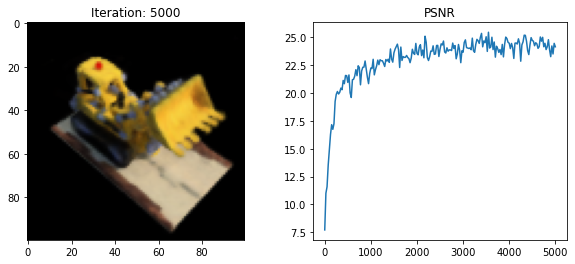

5025 0.3890593147277832 secs per iter


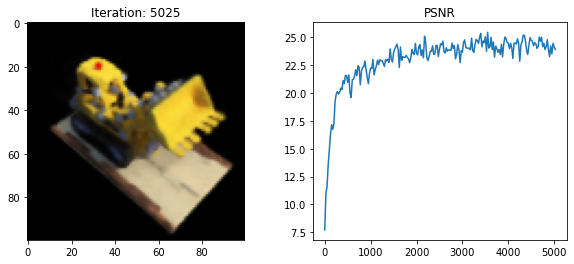

5050 0.3903649139404297 secs per iter


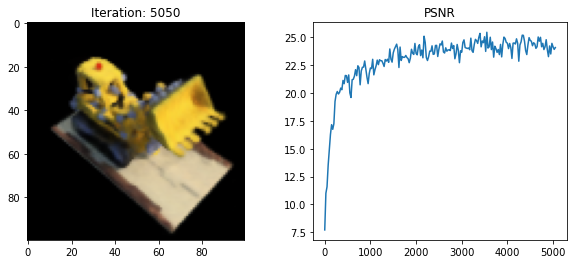

5075 0.38935318946838376 secs per iter


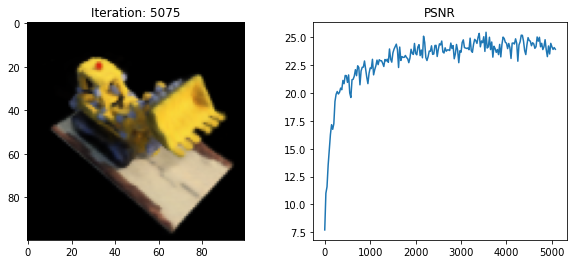

5100 0.3924033069610596 secs per iter


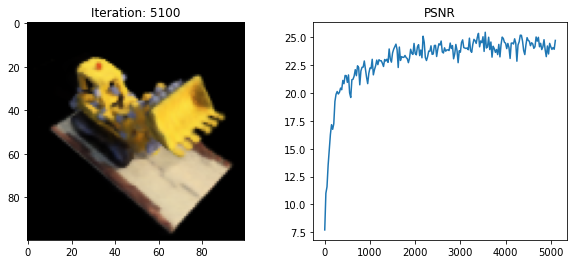

5125 0.38960474014282226 secs per iter


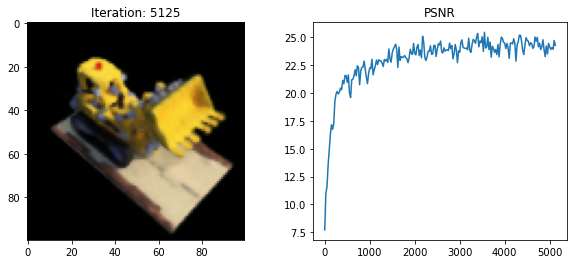

5150 0.38983731269836425 secs per iter


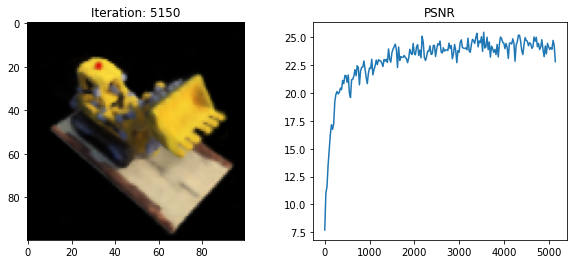

5175 0.3919190311431885 secs per iter


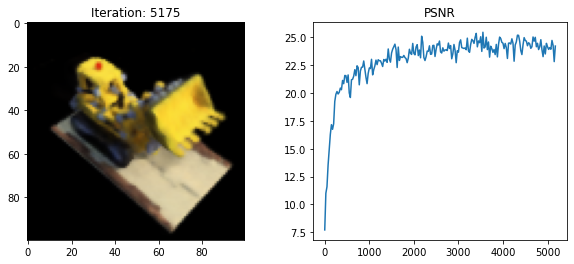

5200 0.3920314979553223 secs per iter


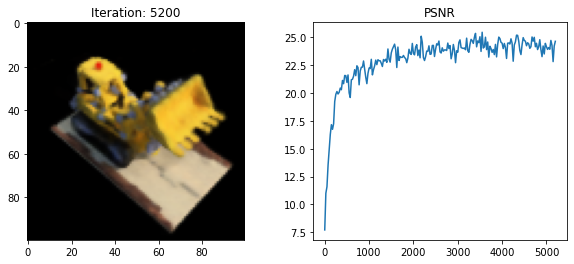

5225 0.38945075035095217 secs per iter


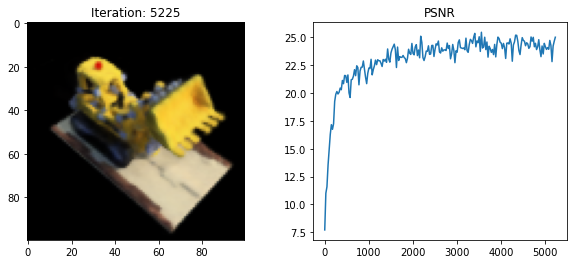

5250 0.39032448768615724 secs per iter


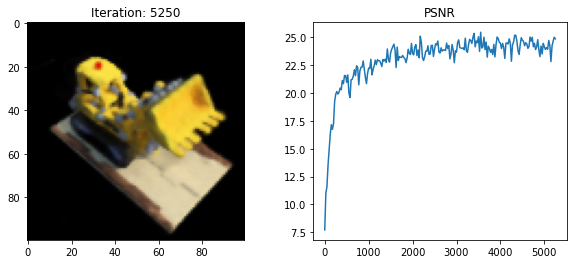

5275 0.3896323204040527 secs per iter


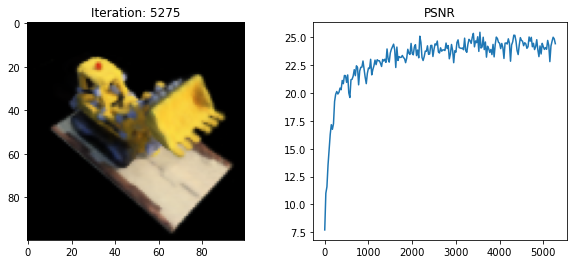

5300 0.38972628593444825 secs per iter


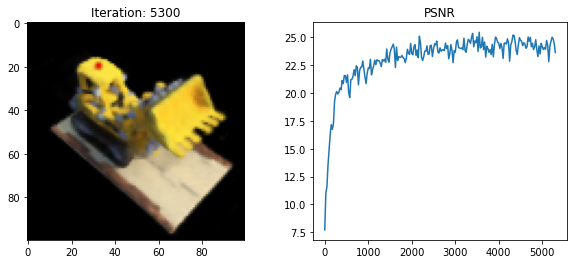

5325 0.3926506900787354 secs per iter


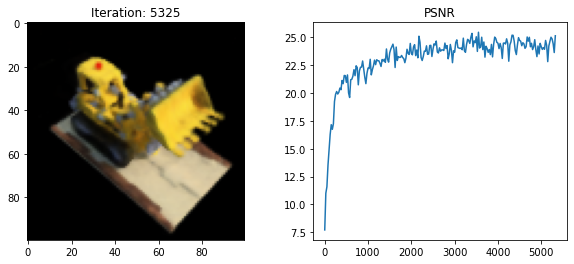

5350 0.38987939834594726 secs per iter


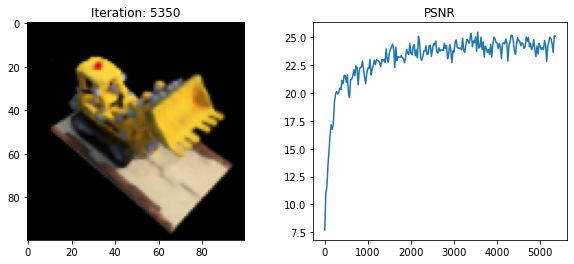

5375 0.39057230949401855 secs per iter


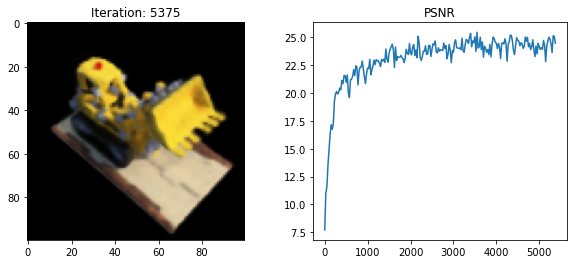

5400 0.38971336364746095 secs per iter


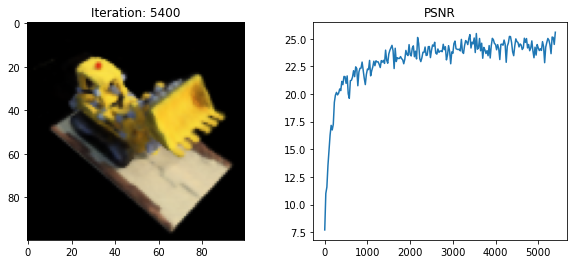

5425 0.39174469947814944 secs per iter


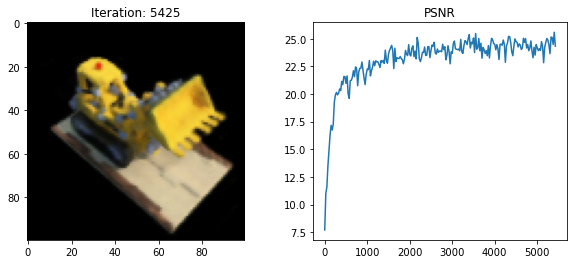

5450 0.38981167793273924 secs per iter


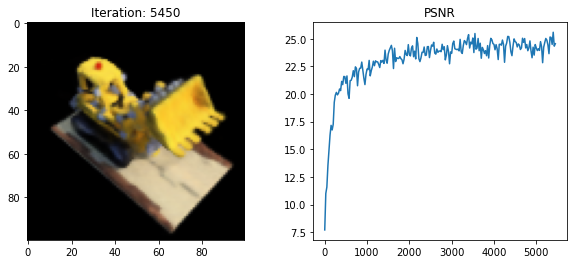

5475 0.3919240570068359 secs per iter


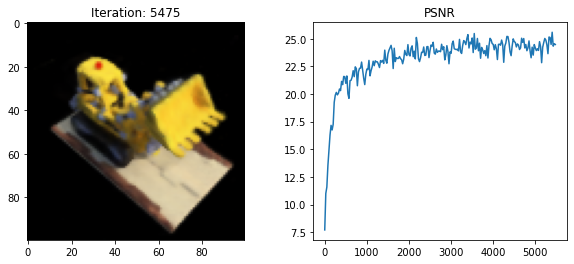

5500 0.39069352149963377 secs per iter


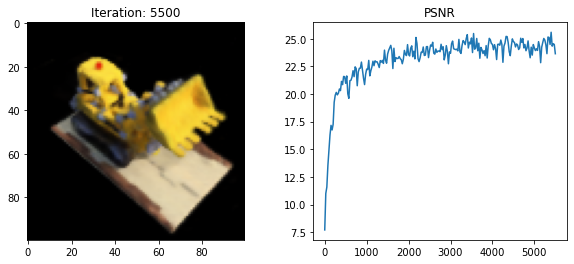

5525 0.3903854942321777 secs per iter


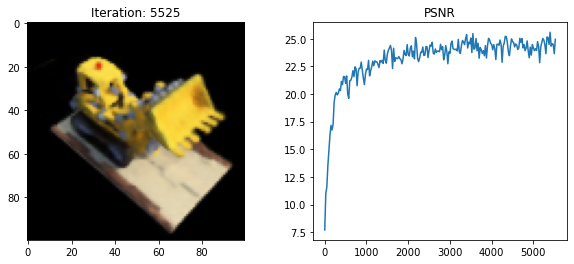

5550 0.3925142669677734 secs per iter


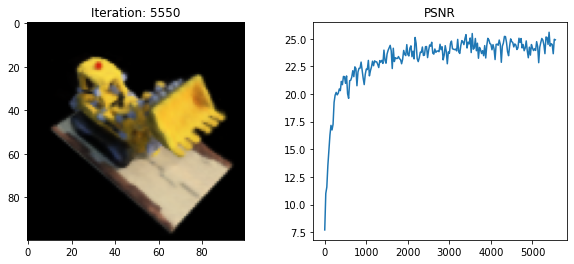

5575 0.3900996494293213 secs per iter


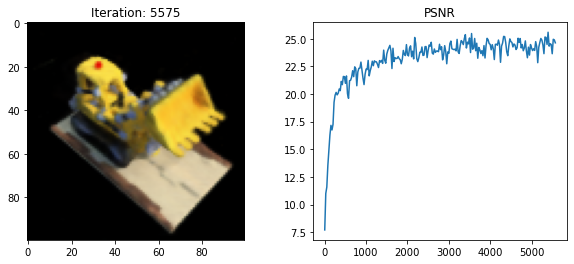

5600 0.389756441116333 secs per iter


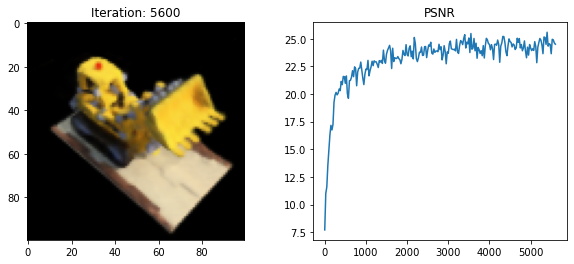

5625 0.39003633499145507 secs per iter


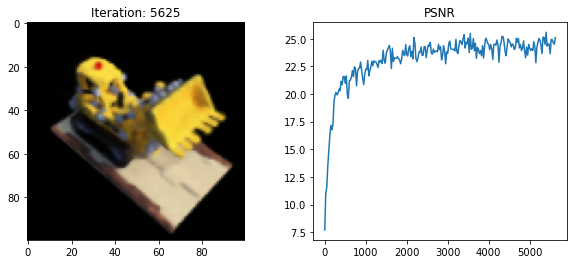

5650 0.3921064853668213 secs per iter


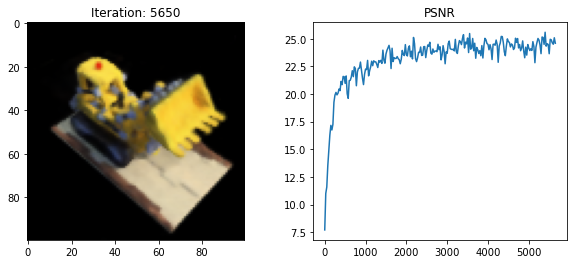

5675 0.390180139541626 secs per iter


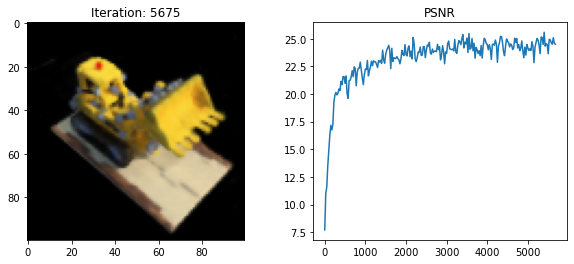

5700 0.39045178413391113 secs per iter


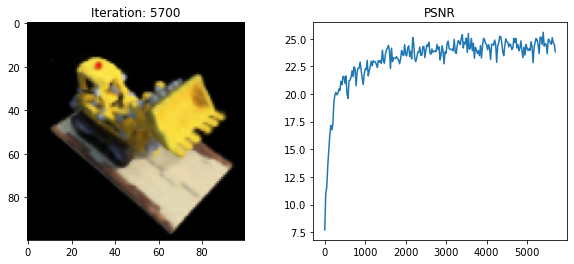

5725 0.3903072738647461 secs per iter


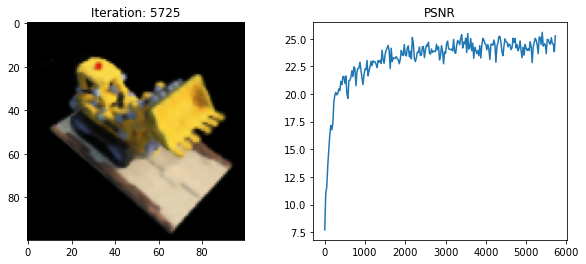

5750 0.38997328758239747 secs per iter


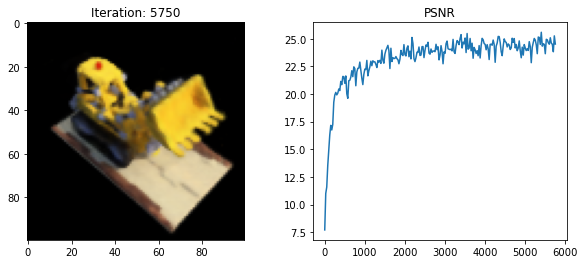

5775 0.3935356521606445 secs per iter


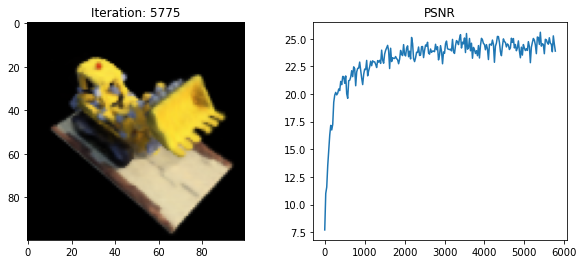

5800 0.3910576343536377 secs per iter


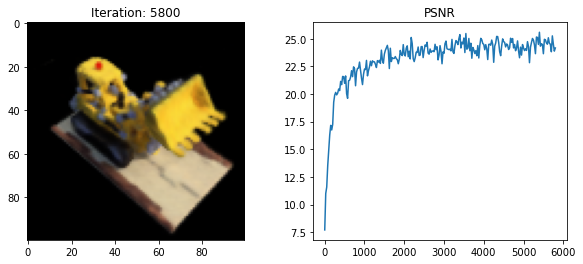

5825 0.3901845550537109 secs per iter


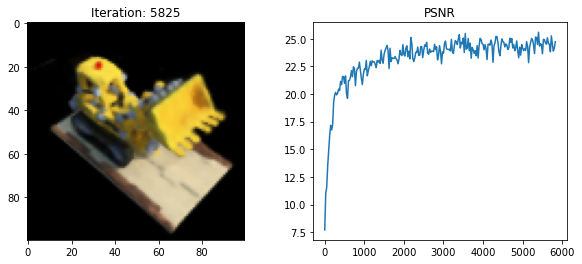

5850 0.3899246597290039 secs per iter


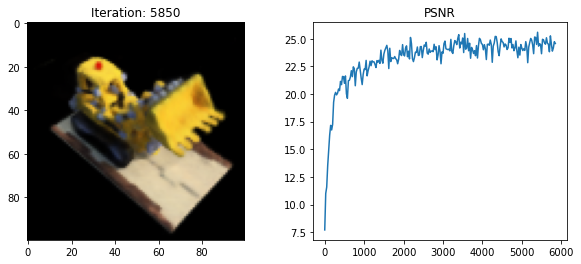

5875 0.39206955909729 secs per iter


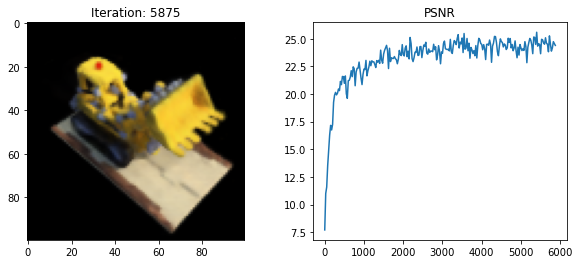

5900 0.39020888328552245 secs per iter


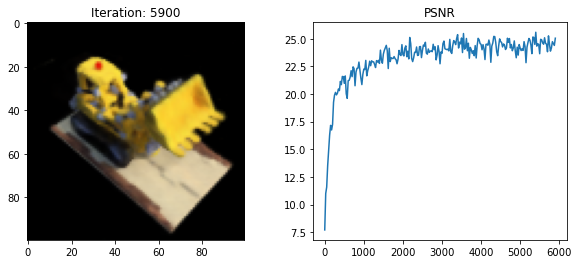

5925 0.3900264644622803 secs per iter


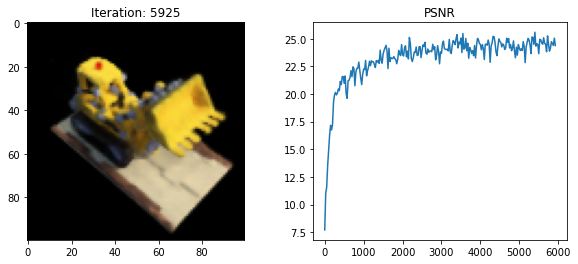

5950 0.38984777450561525 secs per iter


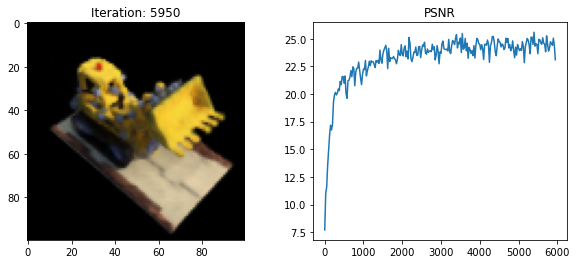

5975 0.3896958827972412 secs per iter


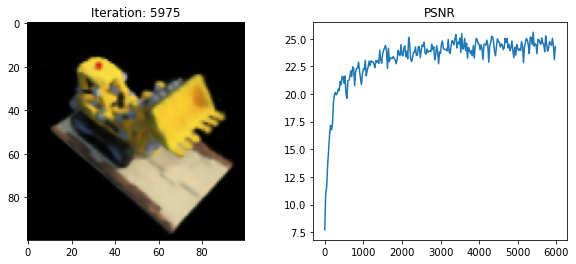

6000 0.3929450035095215 secs per iter


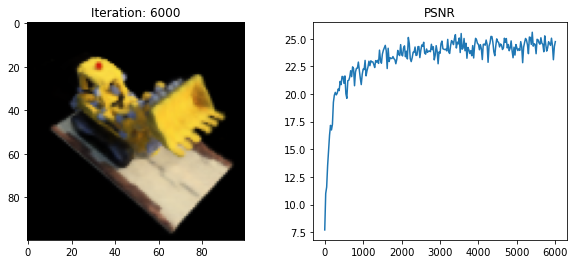

6025 0.3907309150695801 secs per iter


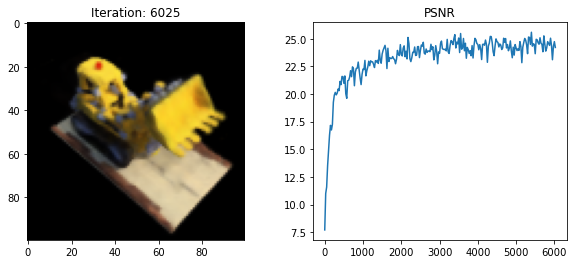

6050 0.38992613792419434 secs per iter


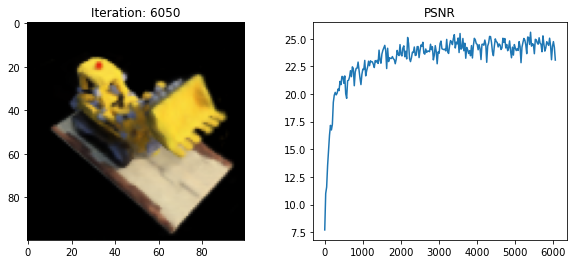

6075 0.39014527320861814 secs per iter


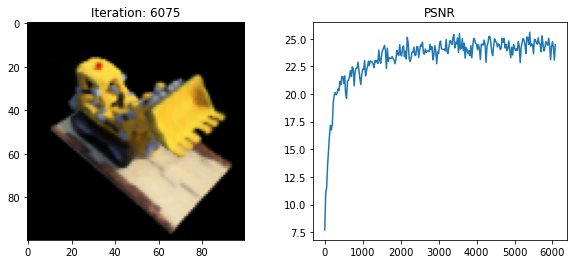

6100 0.39449300765991213 secs per iter


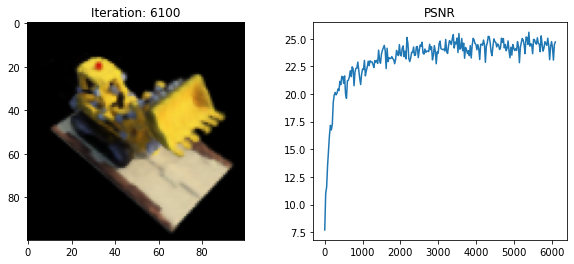

6125 0.39005987167358397 secs per iter


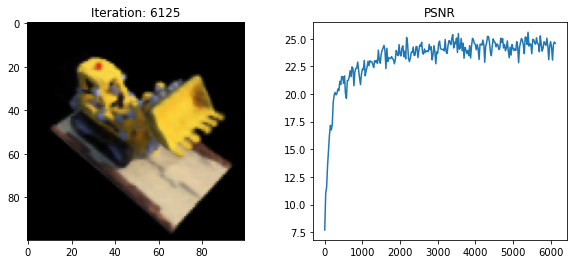

6150 0.39000118255615235 secs per iter


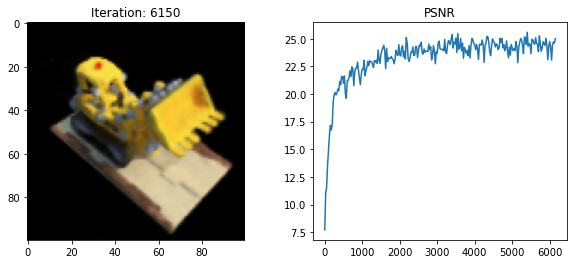

6175 0.3901554679870605 secs per iter


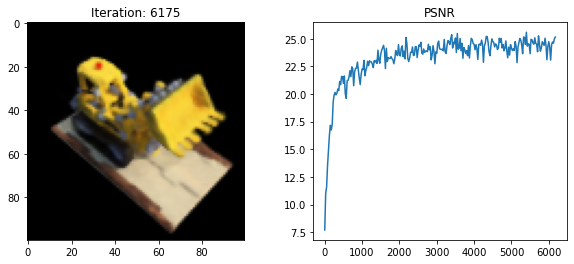

6200 0.3901631641387939 secs per iter


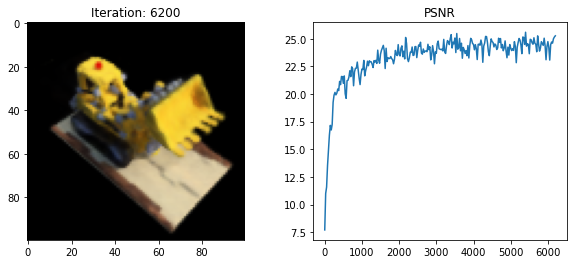

6225 0.39313486099243167 secs per iter


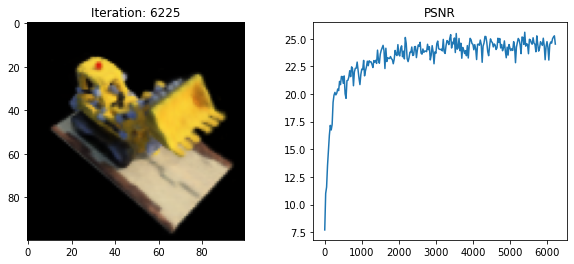

6250 0.38960780143737794 secs per iter


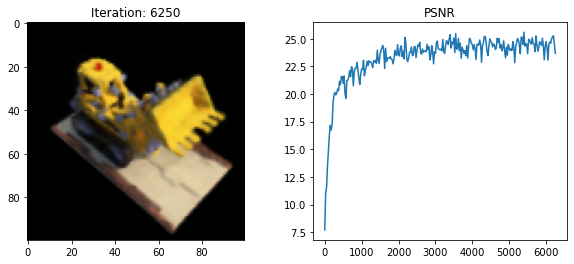

6275 0.38958502769470216 secs per iter


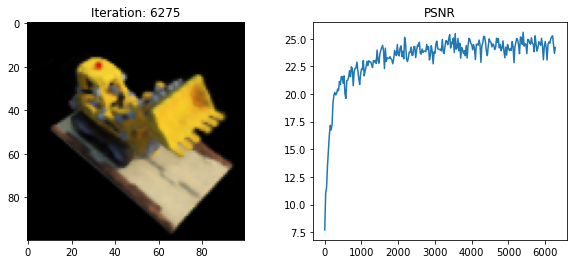

6300 0.3902161693572998 secs per iter


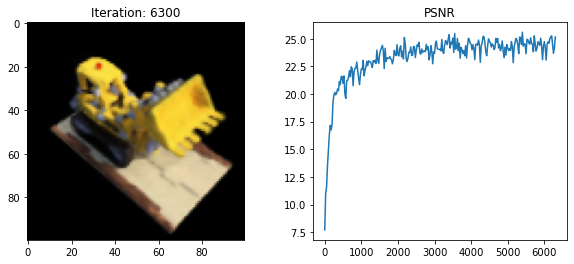

6325 0.3926451873779297 secs per iter


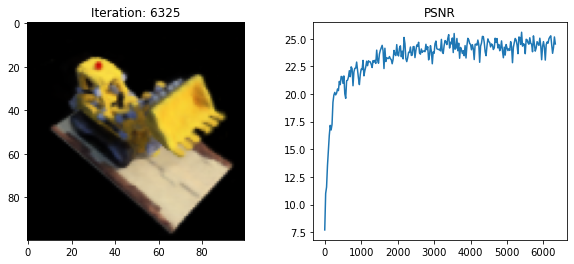

6350 0.3899828910827637 secs per iter


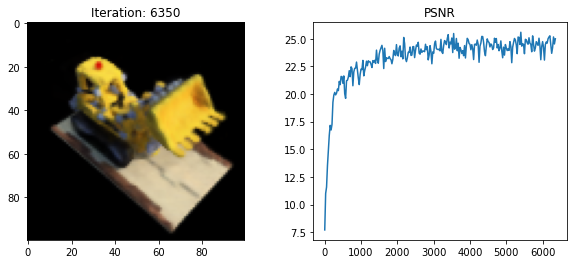

6375 0.3895102310180664 secs per iter


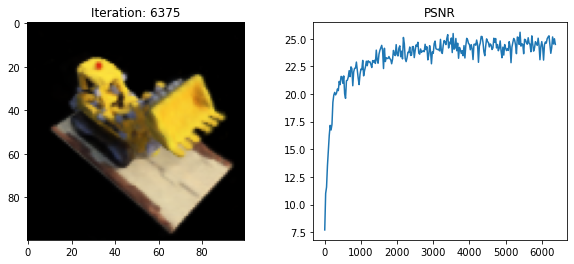

6400 0.3918160533905029 secs per iter


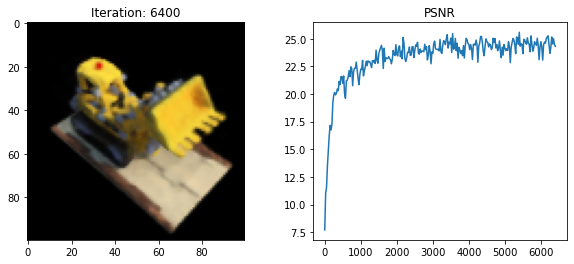

6425 0.390067777633667 secs per iter


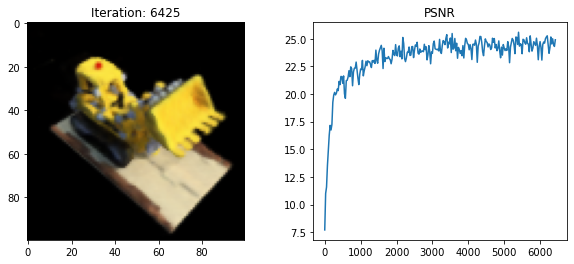

6450 0.39349897384643556 secs per iter


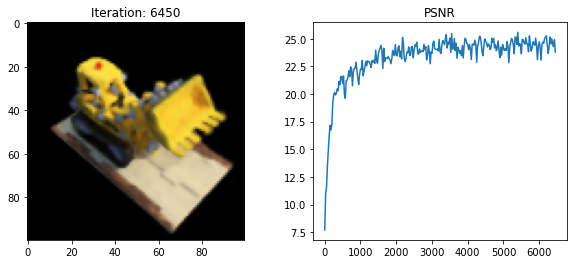

6475 0.3902108573913574 secs per iter


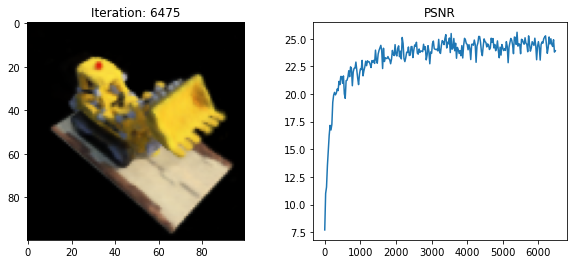

6500 0.389618501663208 secs per iter


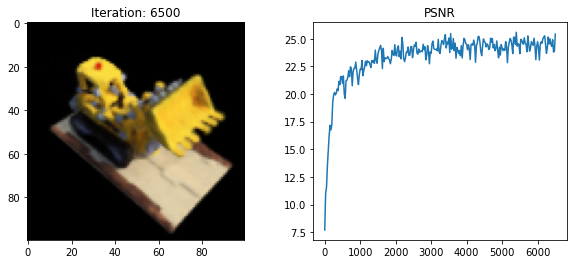

6525 0.3889035320281982 secs per iter


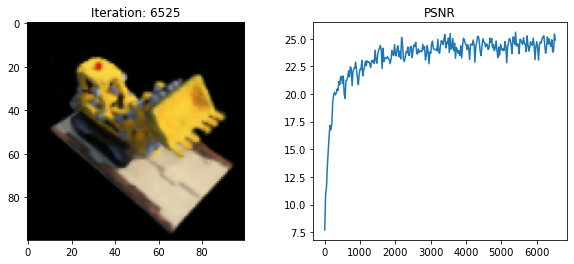

6550 0.3925523281097412 secs per iter


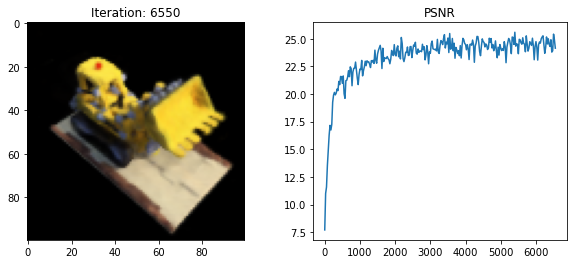

6575 0.39006072998046876 secs per iter


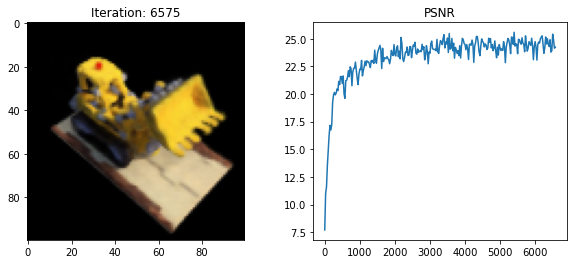

6600 0.38961196899414063 secs per iter


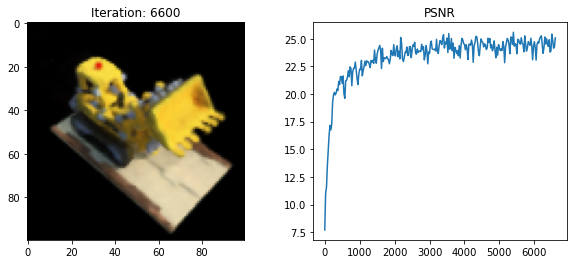

6625 0.3901730728149414 secs per iter


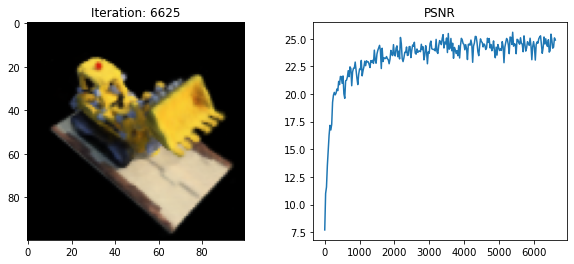

6650 0.3892808246612549 secs per iter


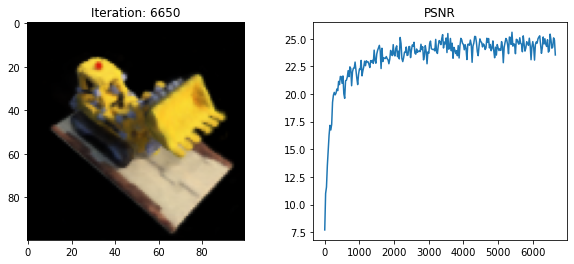

6675 0.3929083728790283 secs per iter


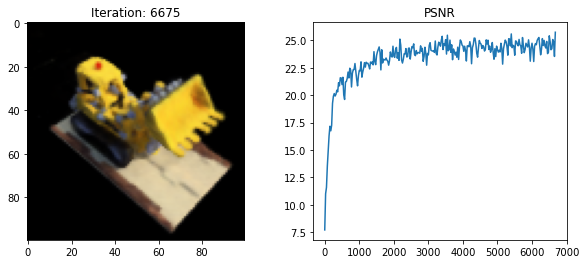

6700 0.39049941062927246 secs per iter


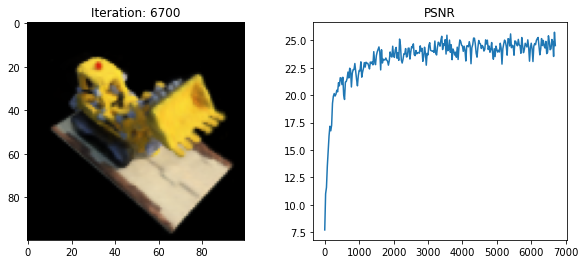

6725 0.39013474464416503 secs per iter


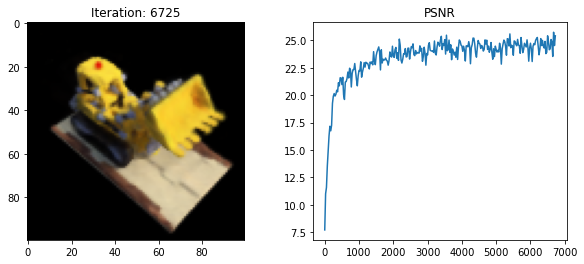

6750 0.39089122772216794 secs per iter


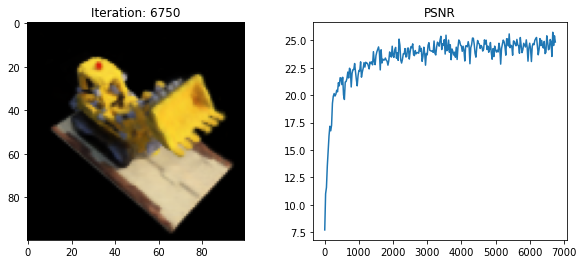

6775 0.3924644088745117 secs per iter


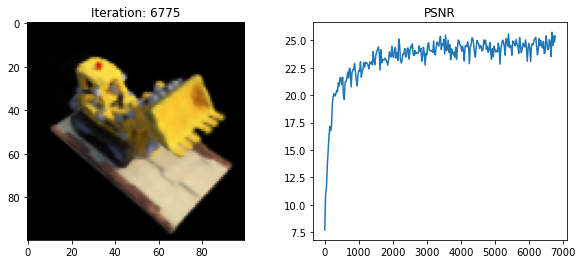

6800 0.3905246925354004 secs per iter


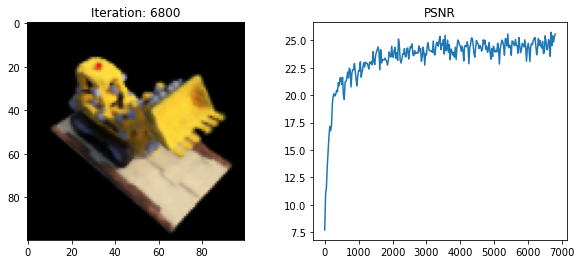

6825 0.3904816913604736 secs per iter


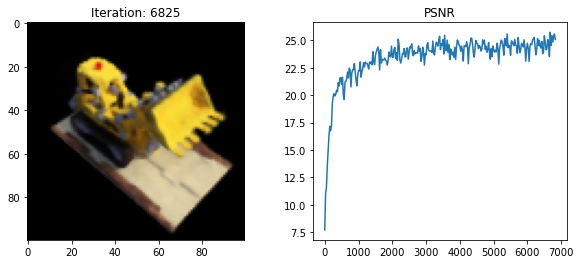

6850 0.39032787322998047 secs per iter


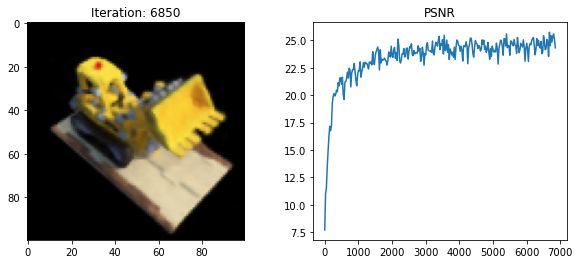

6875 0.39011606216430667 secs per iter


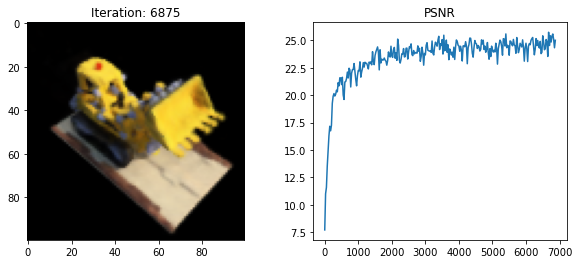

6900 0.39293225288391115 secs per iter


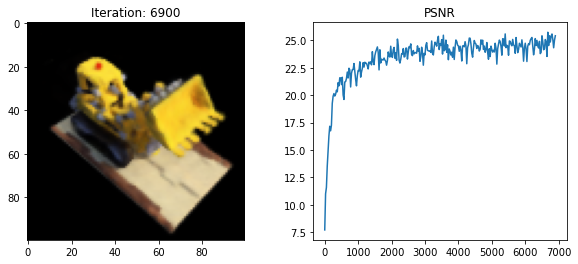

6925 0.38978835105896 secs per iter


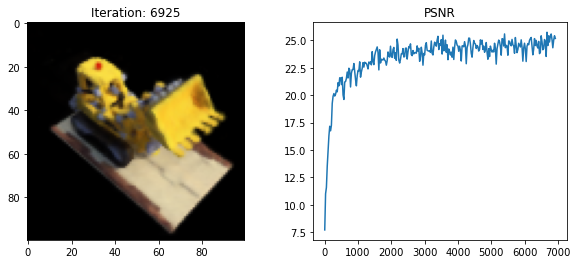

6950 0.390135612487793 secs per iter


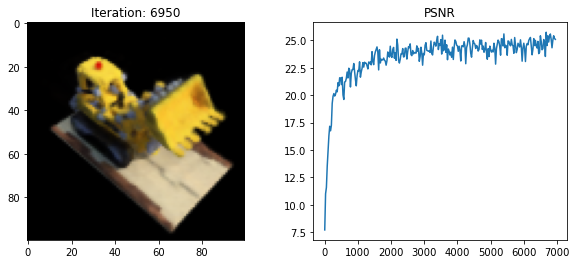

6975 0.3909169101715088 secs per iter


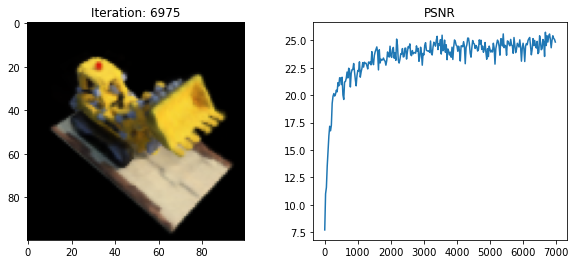

7000 0.39288466453552245 secs per iter


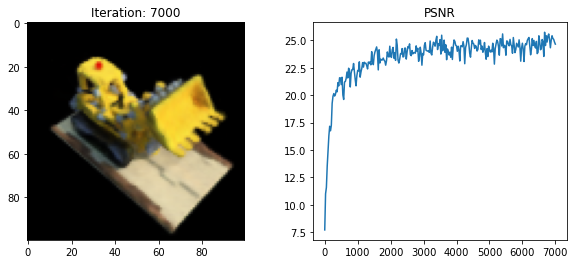

7025 0.3908130741119385 secs per iter


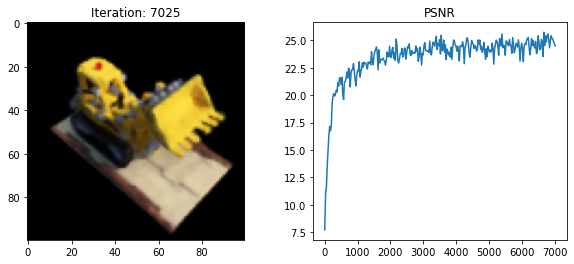

7050 0.3901477146148682 secs per iter


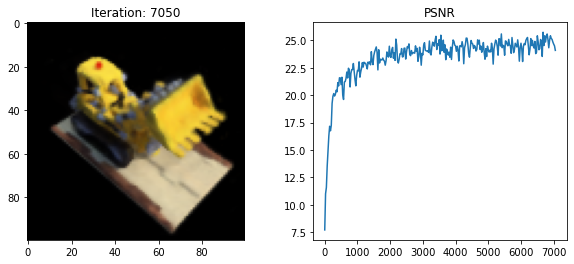

7075 0.38971283912658694 secs per iter


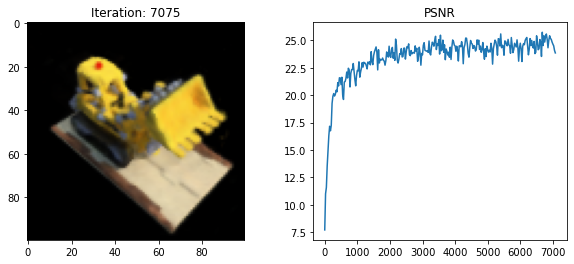

7100 0.39019376754760743 secs per iter


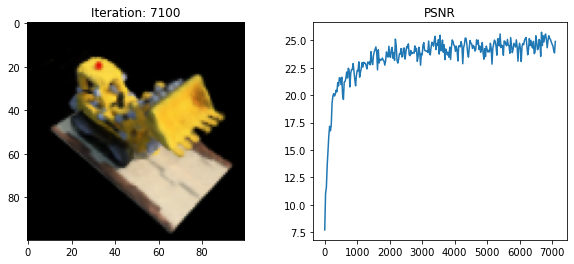

7125 0.39312225341796875 secs per iter


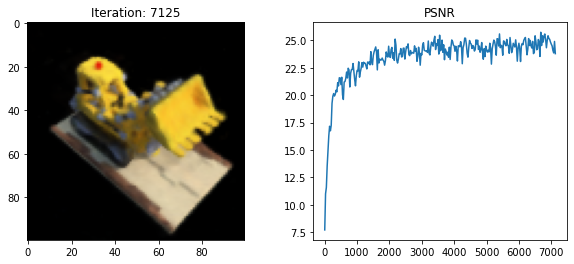

7150 0.3904572582244873 secs per iter


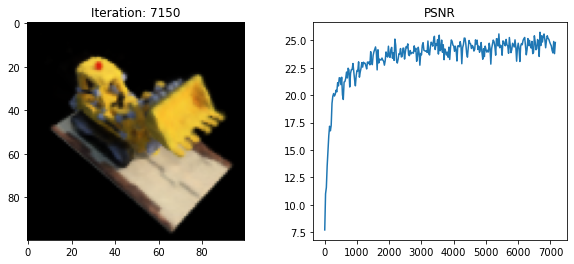

7175 0.3904400157928467 secs per iter


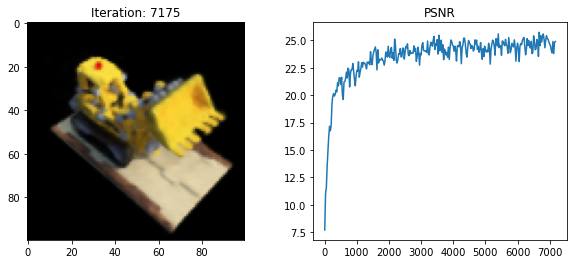

7200 0.39055643081665037 secs per iter


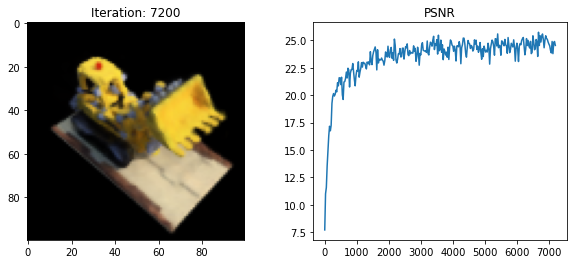

7225 0.3936489772796631 secs per iter


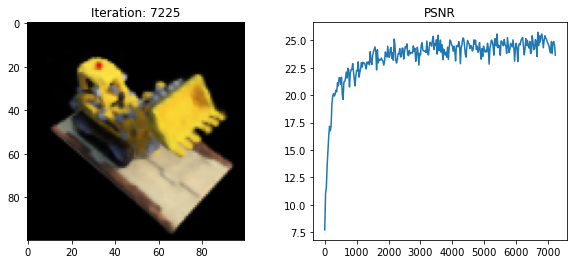

7250 0.39041044235229494 secs per iter


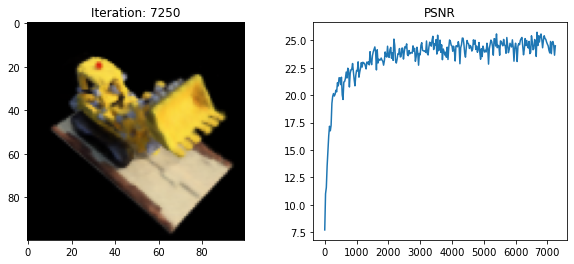

7275 0.39008268356323245 secs per iter


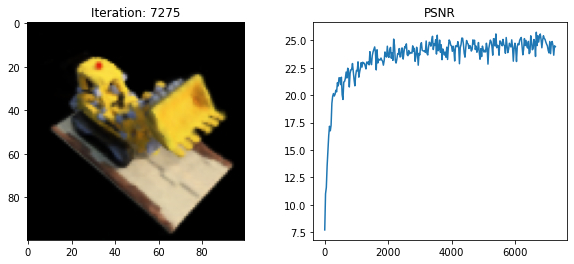

7300 0.3894918346405029 secs per iter


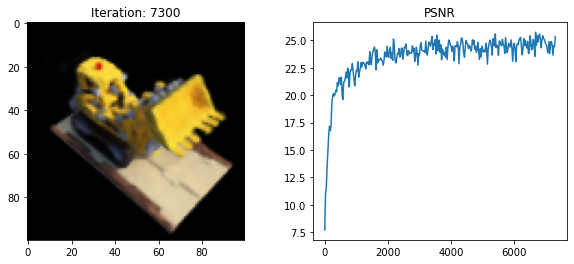

7325 0.39020824432373047 secs per iter


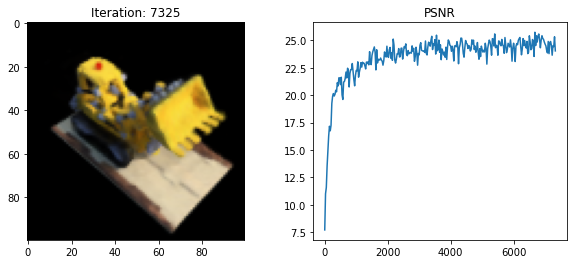

7350 0.3925034046173096 secs per iter


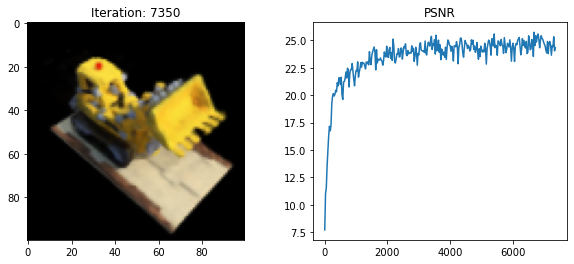

7375 0.3893674182891846 secs per iter


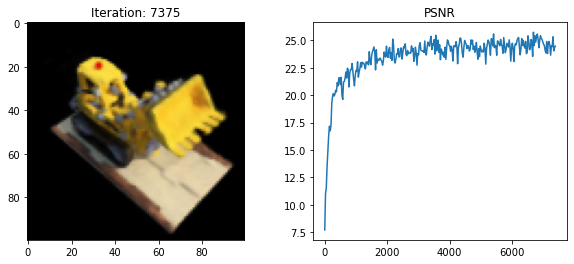

7400 0.38968729972839355 secs per iter


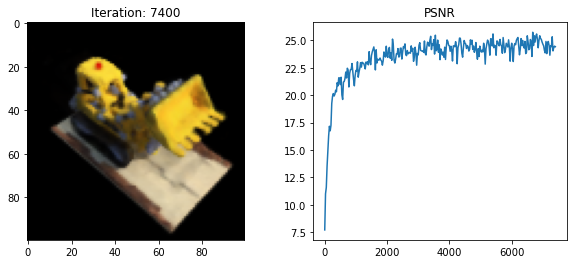

7425 0.3895968246459961 secs per iter


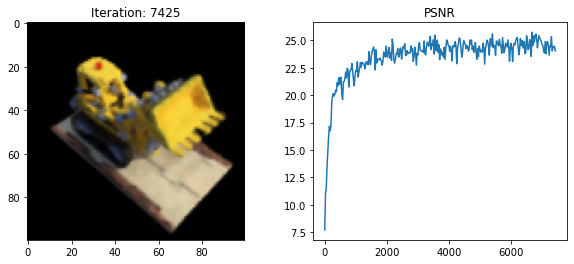

7450 0.3917384147644043 secs per iter


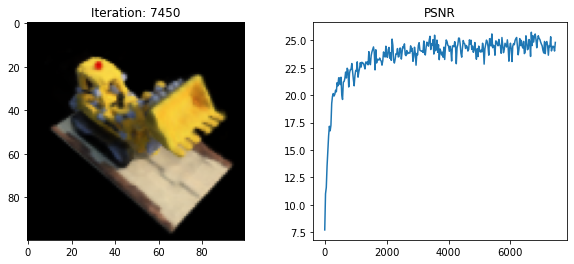

7475 0.38978339195251466 secs per iter


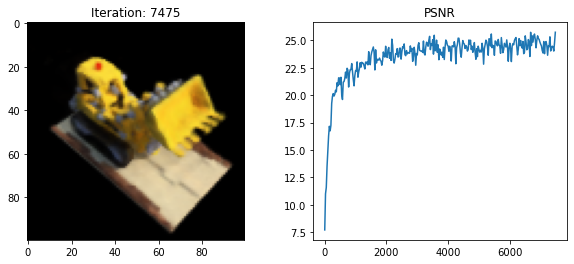

7500 0.3911225414276123 secs per iter


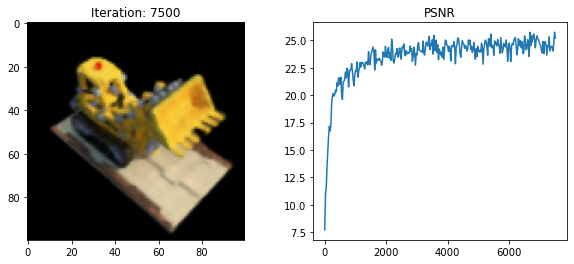

7525 0.3887776279449463 secs per iter


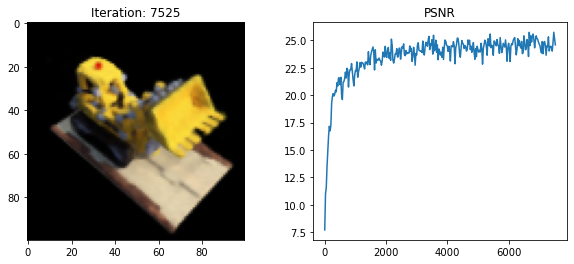

7550 0.3894270610809326 secs per iter


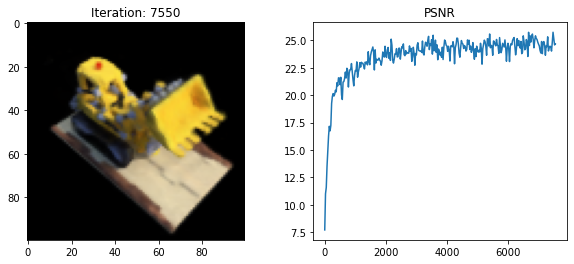

7575 0.3926339912414551 secs per iter


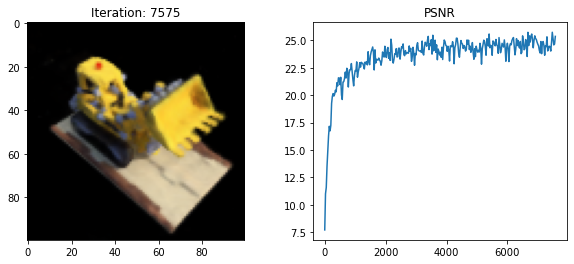

7600 0.39003796577453614 secs per iter


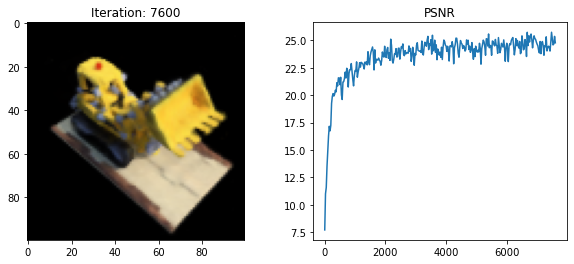

7625 0.3914089870452881 secs per iter


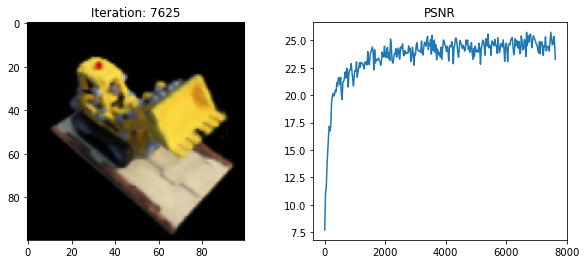

7650 0.3905753231048584 secs per iter


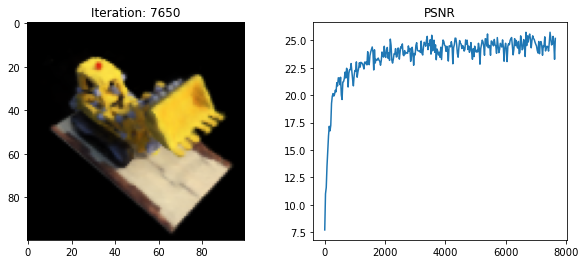

7675 0.3896504306793213 secs per iter


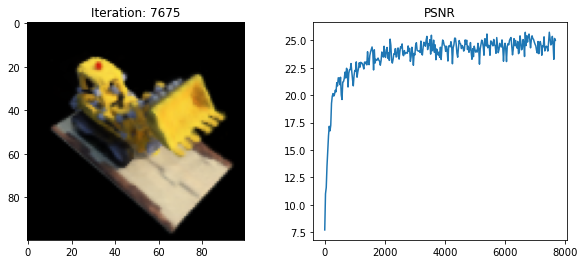

7700 0.3917169761657715 secs per iter


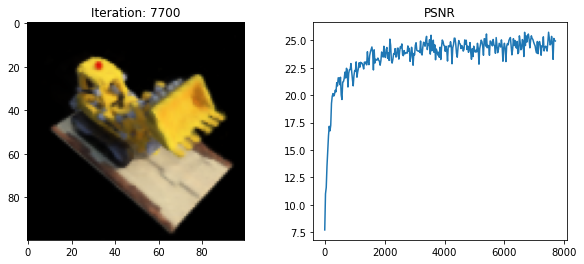

7725 0.3893143272399902 secs per iter


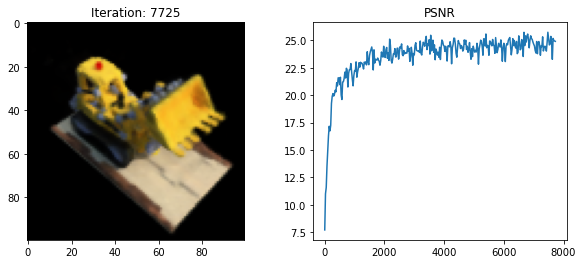

7750 0.38727030754089353 secs per iter


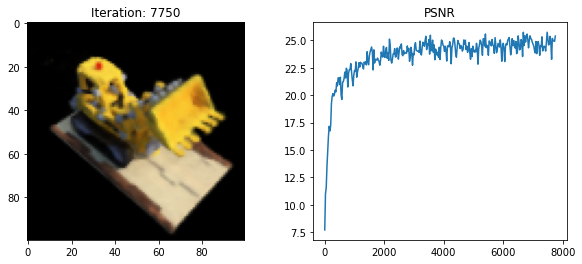

7775 0.39003443717956543 secs per iter


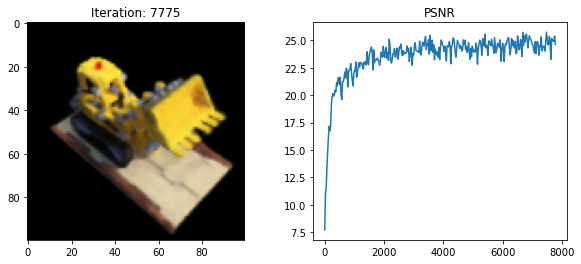

7800 0.39215978622436526 secs per iter


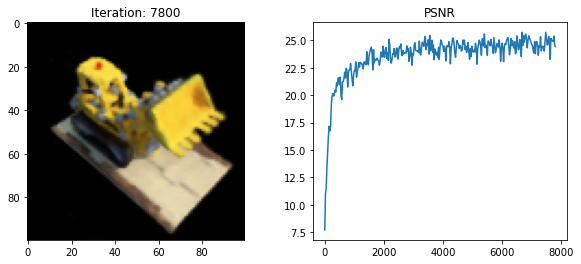

7825 0.38918381690979004 secs per iter


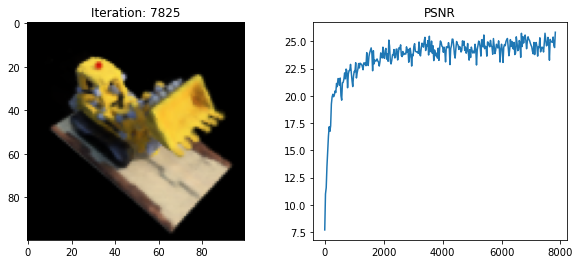

7850 0.38936360359191896 secs per iter


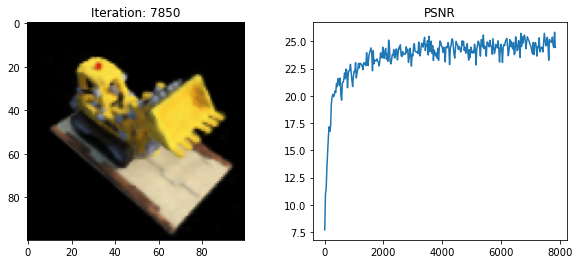

7875 0.38930288314819333 secs per iter


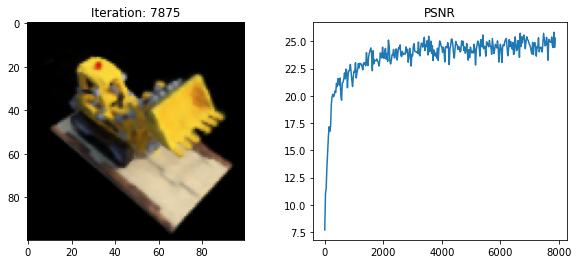

7900 0.38964133262634276 secs per iter


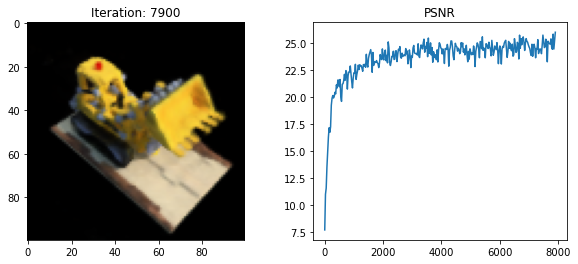

7925 0.39452362060546875 secs per iter


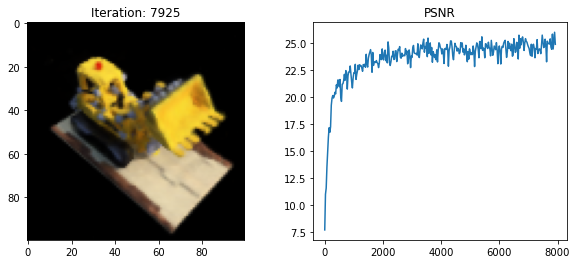

7950 0.39130000114440916 secs per iter


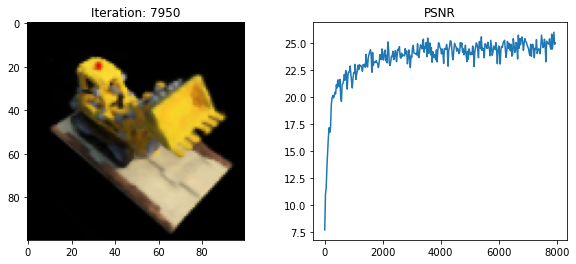

7975 0.3897965717315674 secs per iter


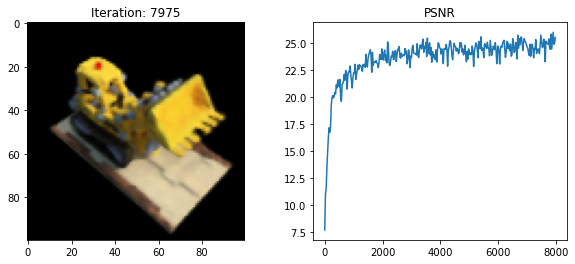

8000 0.3905068111419678 secs per iter


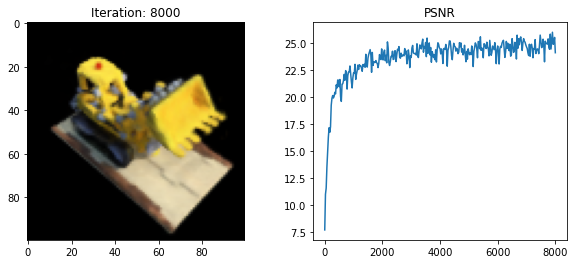

8025 0.39246469497680664 secs per iter


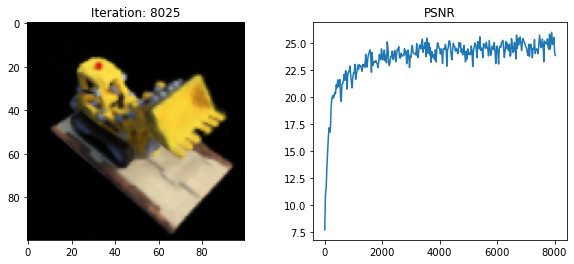

8050 0.39011778831481936 secs per iter


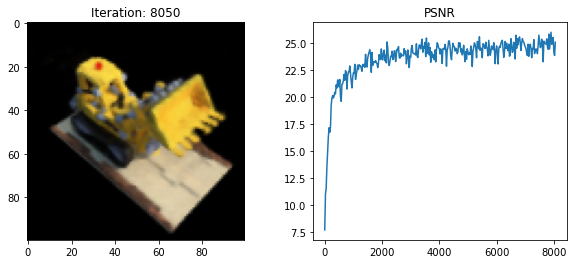

8075 0.38976582527160647 secs per iter


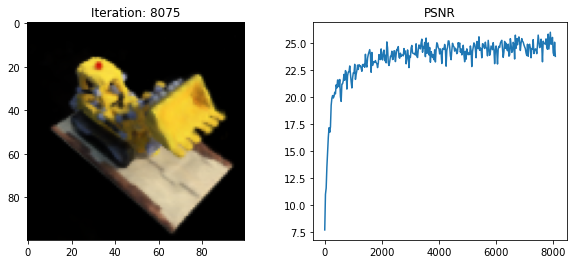

8100 0.3900032043457031 secs per iter


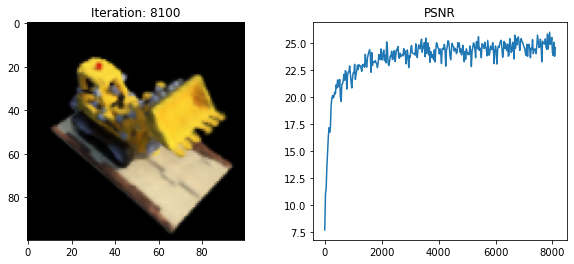

8125 0.38958905220031737 secs per iter


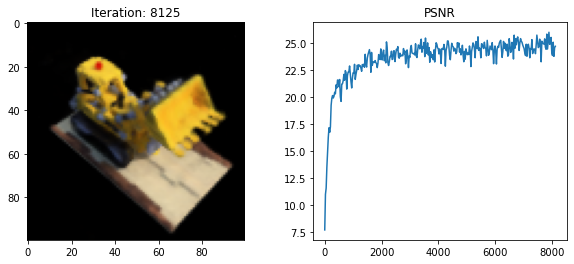

8150 0.3907983016967773 secs per iter


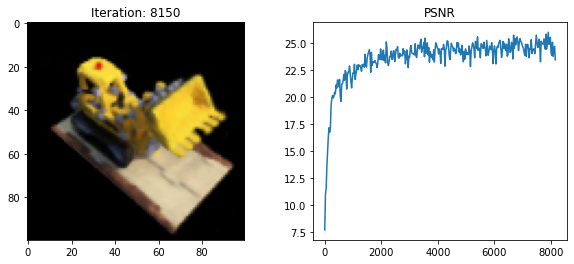

8175 0.3900683307647705 secs per iter


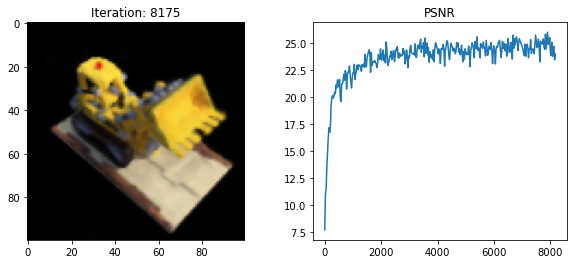

8200 0.3897198581695557 secs per iter


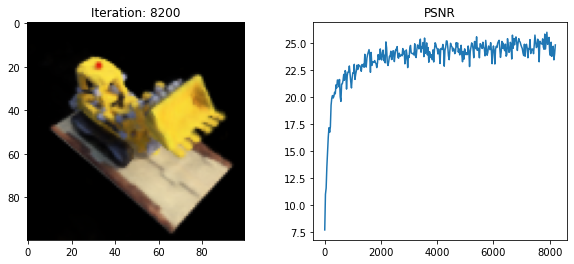

8225 0.39015296936035154 secs per iter


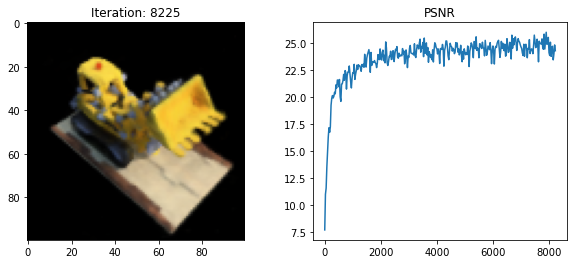

8250 0.39445473670959474 secs per iter


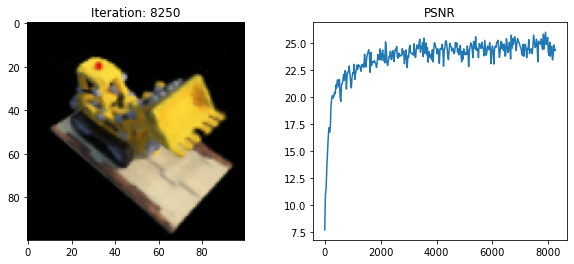

8275 0.3898440647125244 secs per iter


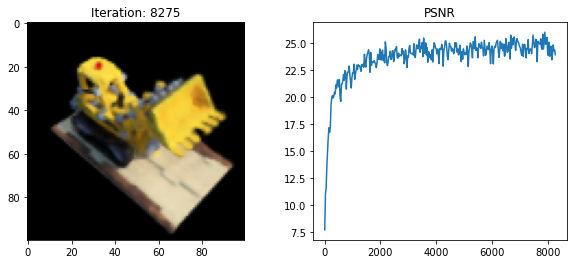

8300 0.3899093818664551 secs per iter


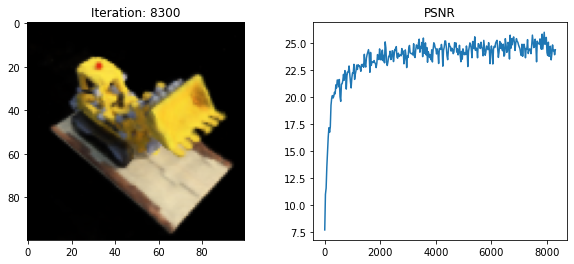

8325 0.39010416984558105 secs per iter


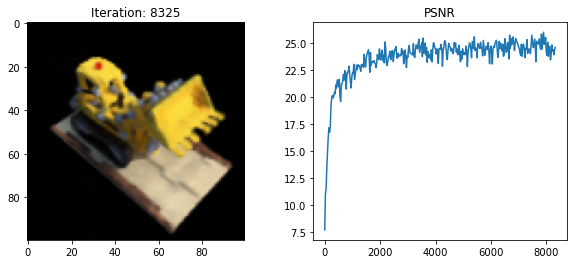

8350 0.3900498008728027 secs per iter


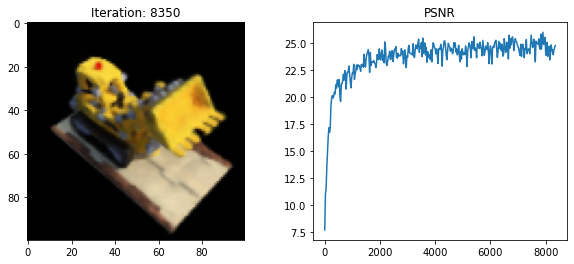

8375 0.3921228885650635 secs per iter


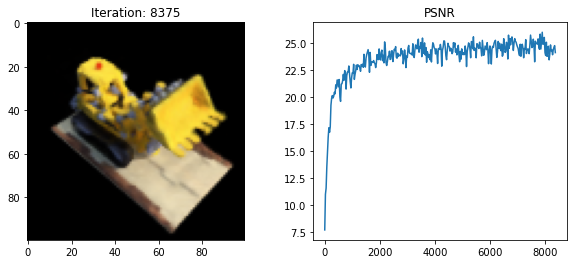

8400 0.3890501403808594 secs per iter


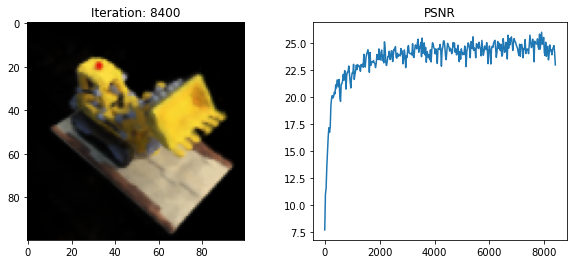

8425 0.3899675178527832 secs per iter


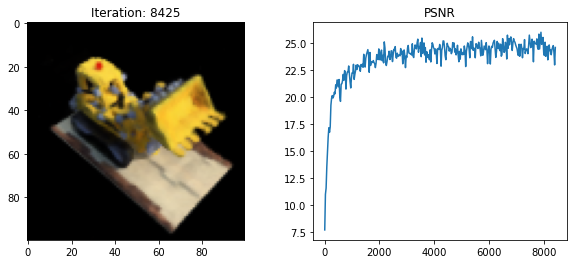

8450 0.38932026863098146 secs per iter


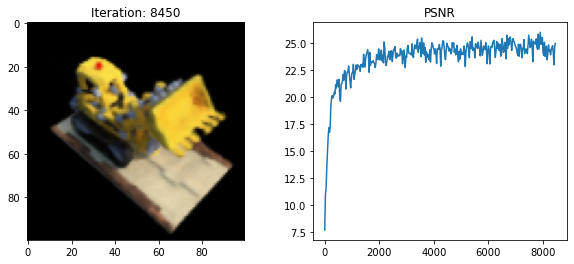

8475 0.3929758644104004 secs per iter


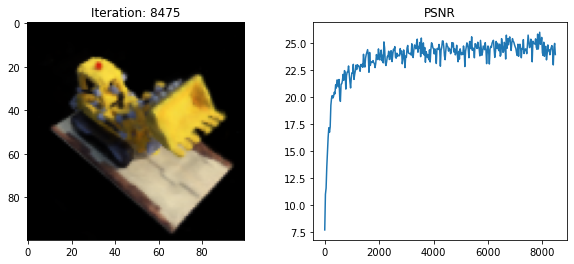

8500 0.3904084491729736 secs per iter


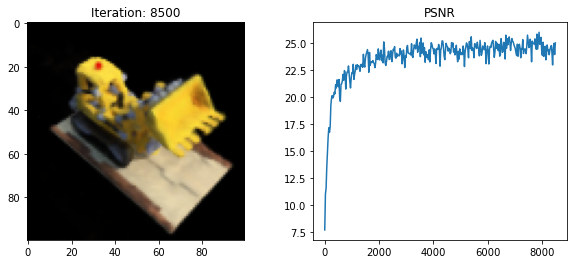

8525 0.3901059627532959 secs per iter


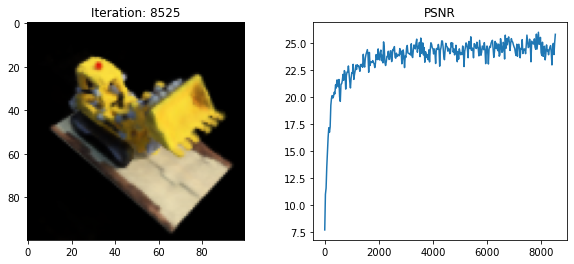

8550 0.3913337421417236 secs per iter


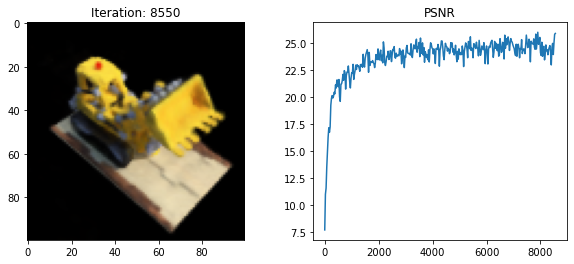

8575 0.3904386520385742 secs per iter


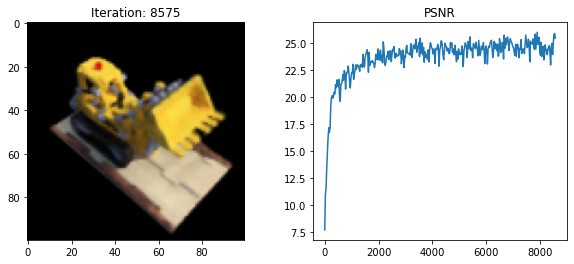

8600 0.39201839447021486 secs per iter


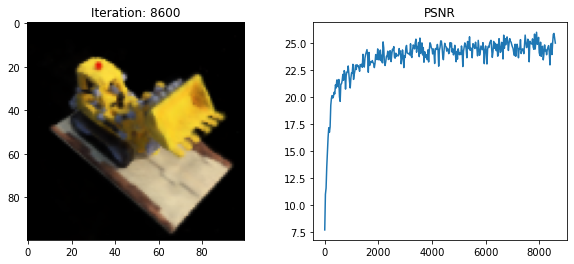

8625 0.3898084926605225 secs per iter


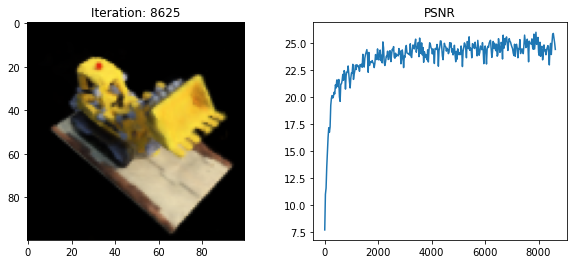

8650 0.3899568748474121 secs per iter


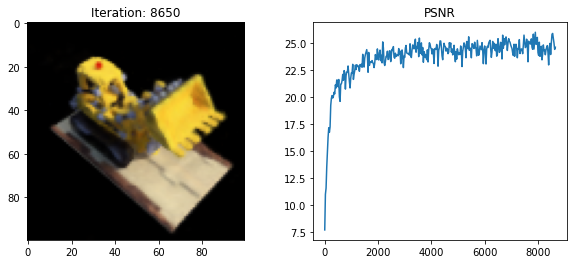

8675 0.3893560218811035 secs per iter


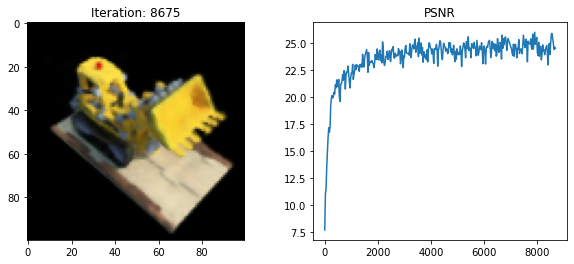

8700 0.39090261459350584 secs per iter


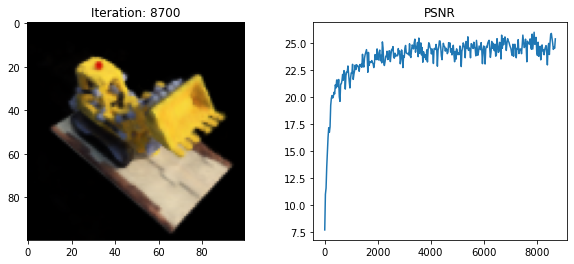

8725 0.38917959213256836 secs per iter


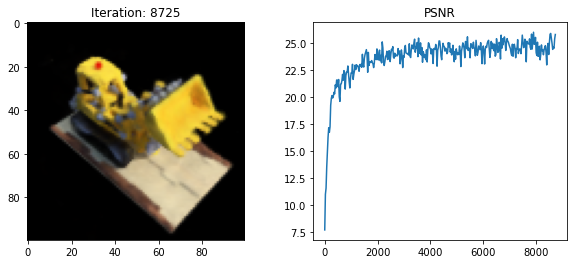

8750 0.38895517349243164 secs per iter


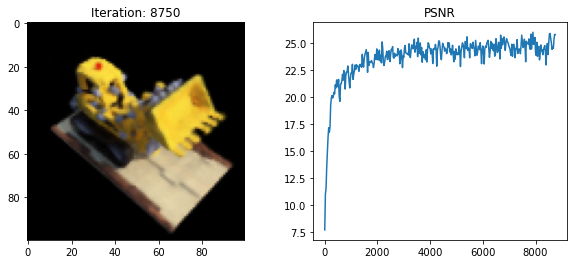

8775 0.38927239418029785 secs per iter


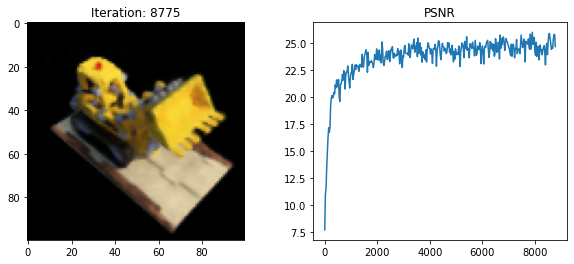

8800 0.3897498607635498 secs per iter


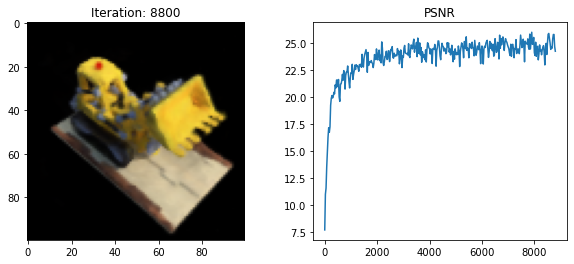

8825 0.3913321685791016 secs per iter


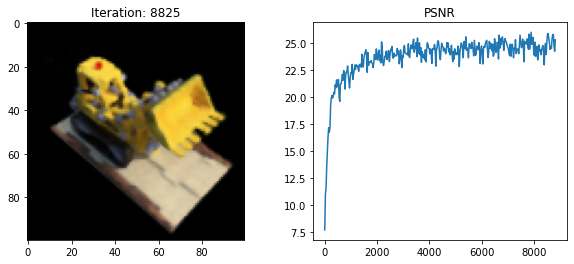

8850 0.39094886779785154 secs per iter


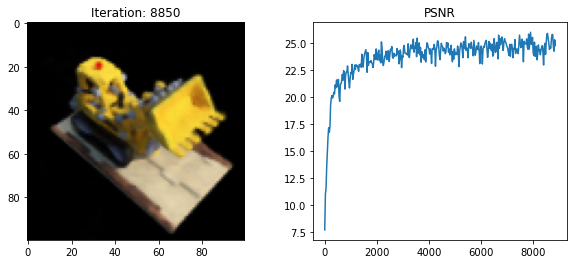

8875 0.39080779075622557 secs per iter


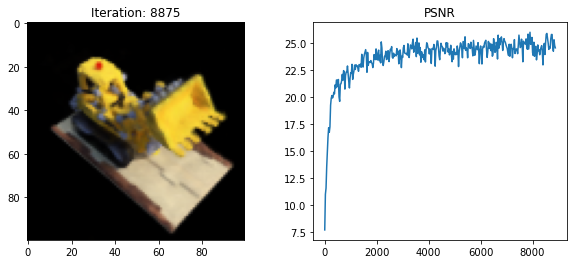

8900 0.3885194492340088 secs per iter


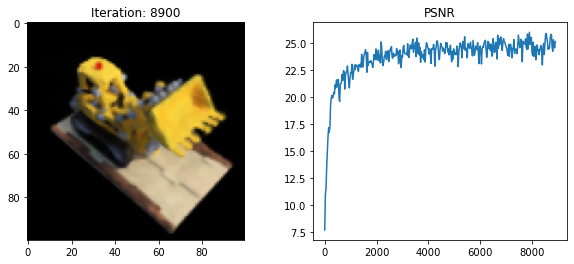

8925 0.392176456451416 secs per iter


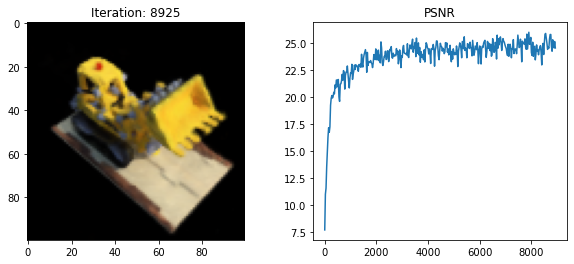

8950 0.3896919822692871 secs per iter


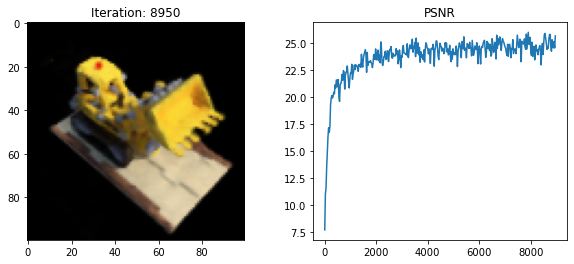

8975 0.38935921669006346 secs per iter


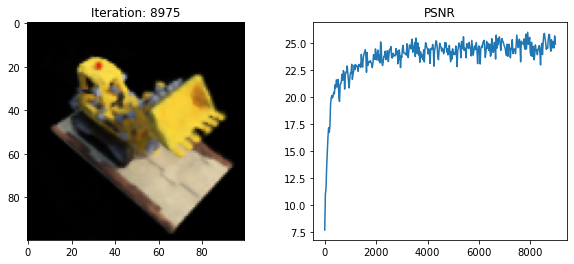

9000 0.38979473114013674 secs per iter


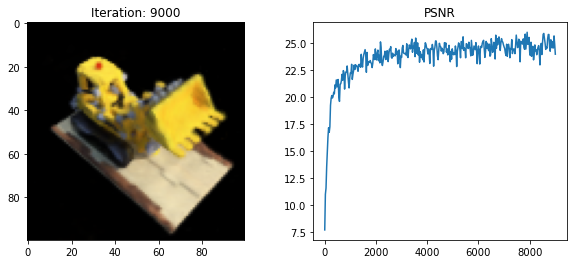

9025 0.3904326152801514 secs per iter


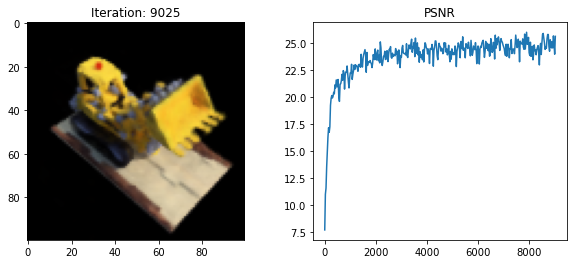

9050 0.39287724494934084 secs per iter


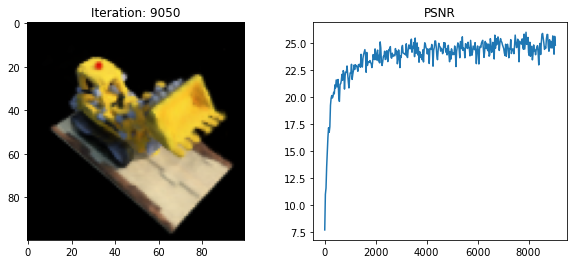

9075 0.39004175186157225 secs per iter


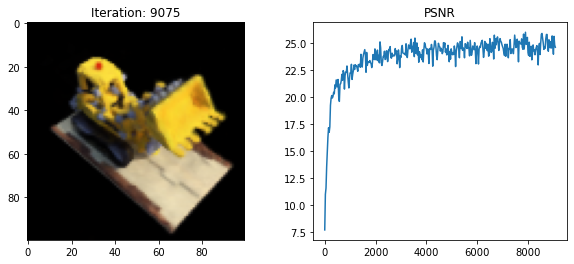

9100 0.38953346252441406 secs per iter


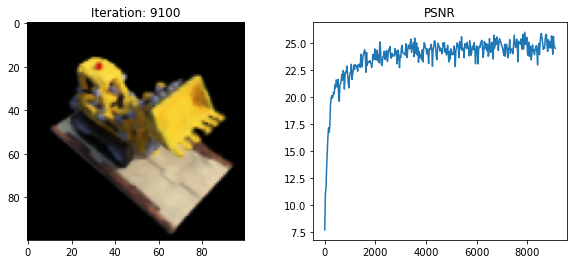

9125 0.3899563407897949 secs per iter


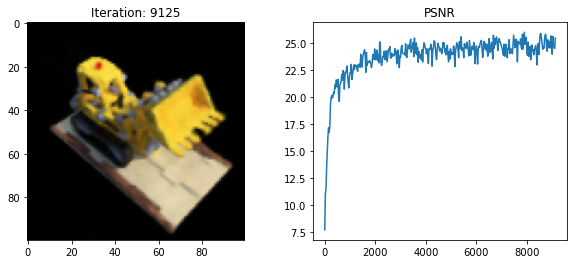

9150 0.39247145652771 secs per iter


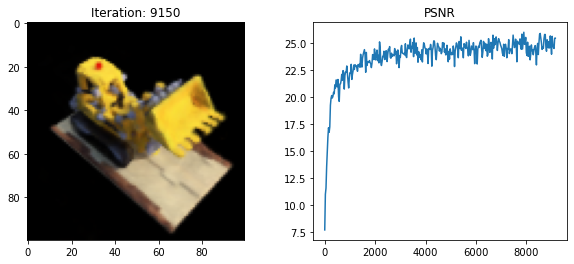

9175 0.39222317695617676 secs per iter


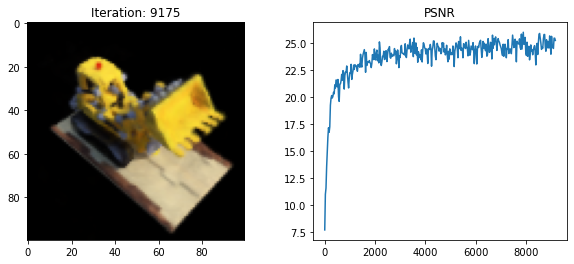

9200 0.3901473045349121 secs per iter


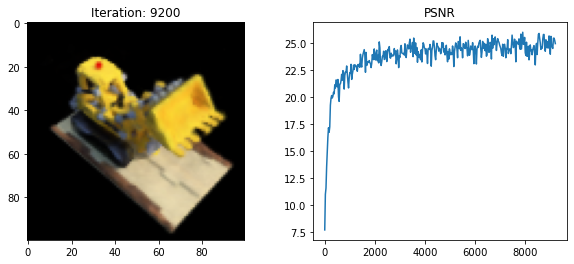

9225 0.39018424034118654 secs per iter


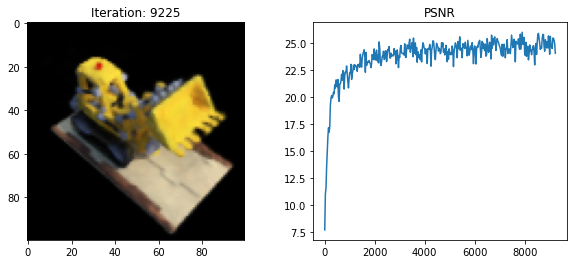

9250 0.39002142906188964 secs per iter


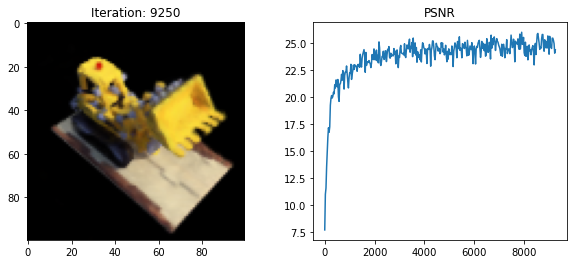

9275 0.39176772117614744 secs per iter


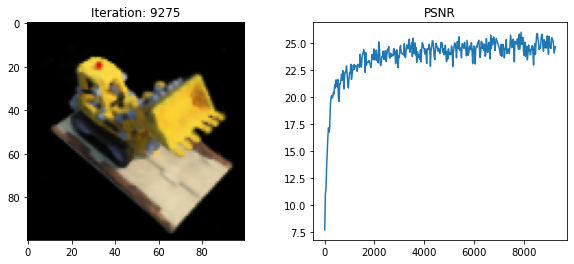

9300 0.38941428184509275 secs per iter


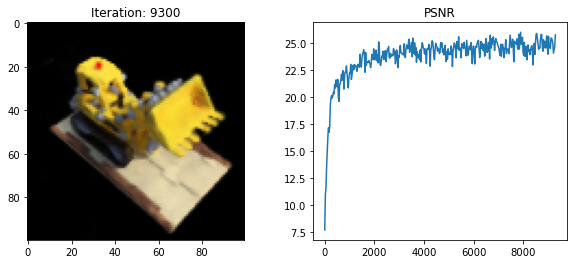

9325 0.390062894821167 secs per iter


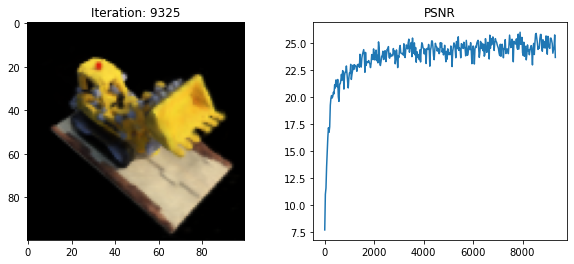

9350 0.3901042938232422 secs per iter


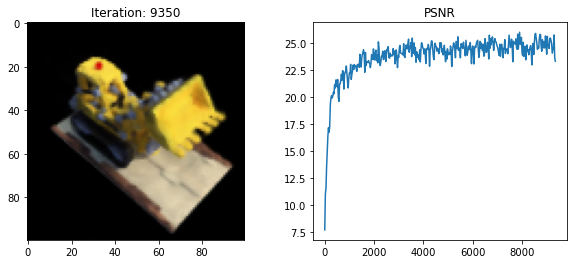

9375 0.39213803291320803 secs per iter


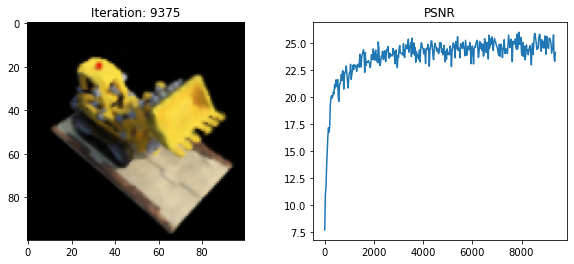

9400 0.390542631149292 secs per iter


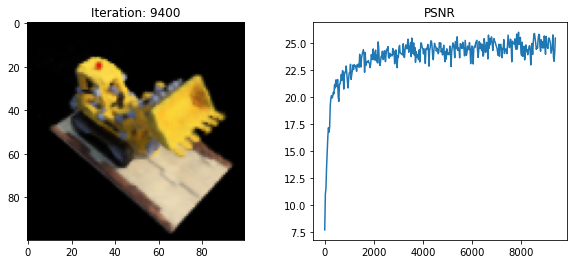

9425 0.3897189426422119 secs per iter


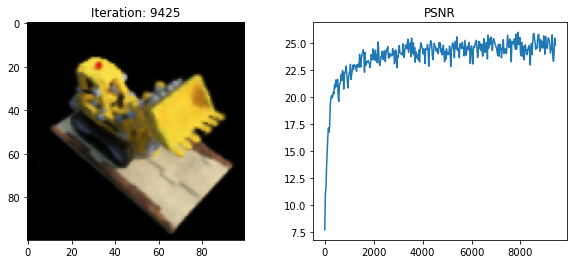

9450 0.389917163848877 secs per iter


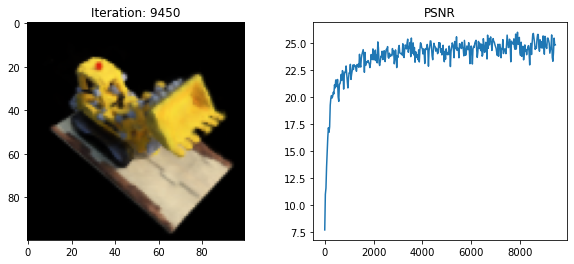

9475 0.3917510509490967 secs per iter


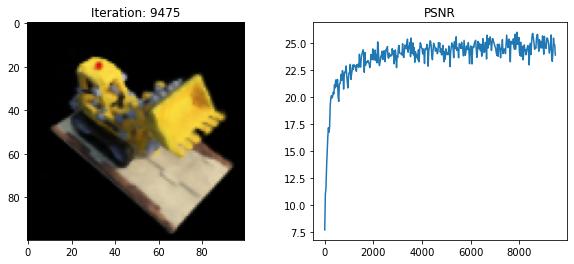

9500 0.3914045524597168 secs per iter


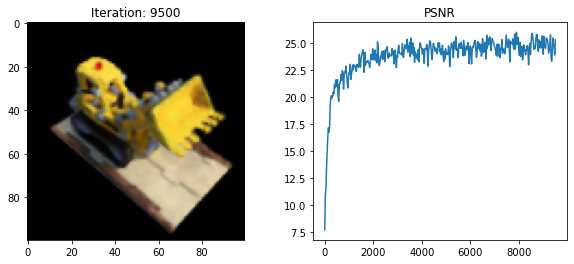

9525 0.3887924289703369 secs per iter


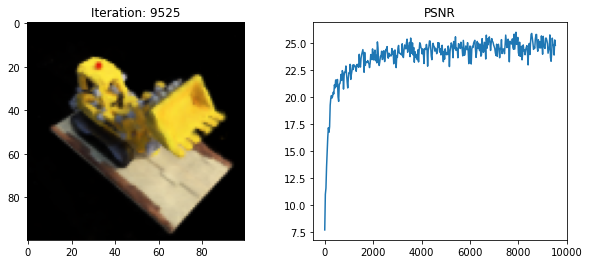

9550 0.3905211162567139 secs per iter


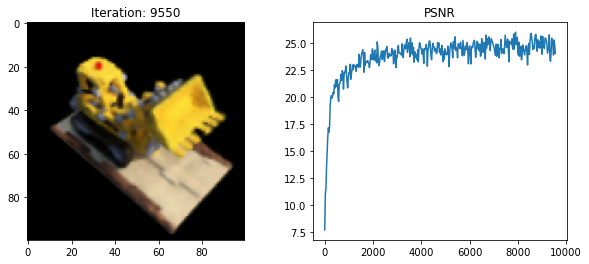

9575 0.3897493839263916 secs per iter


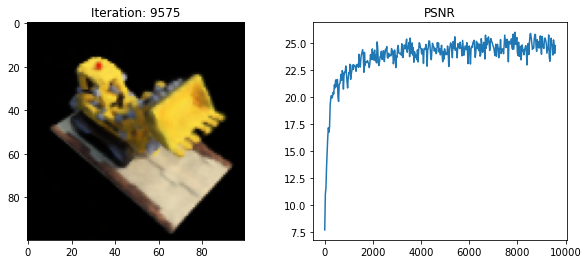

9600 0.39088963508605956 secs per iter


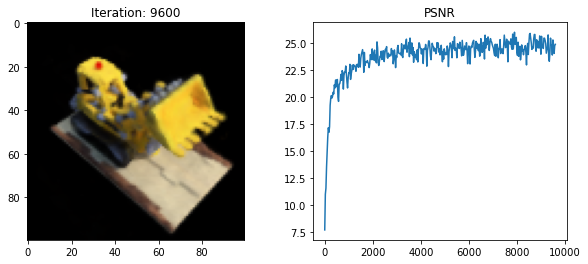

9625 0.3904985809326172 secs per iter


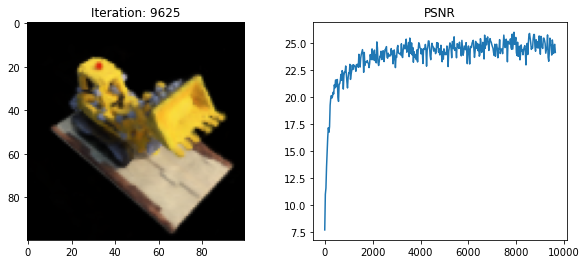

9650 0.38991710662841794 secs per iter


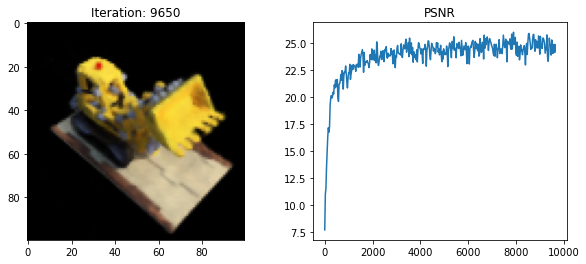

9675 0.3902558612823486 secs per iter


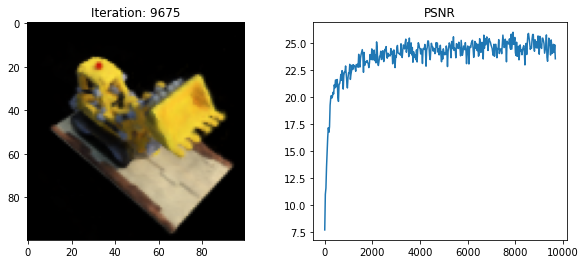

9700 0.3900485134124756 secs per iter


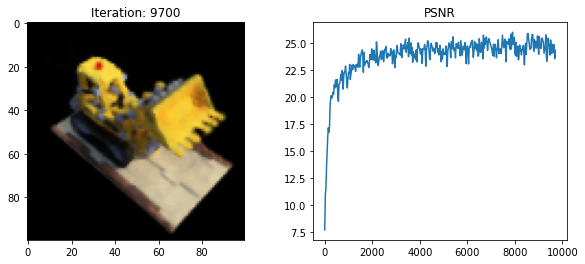

9725 0.3917751121520996 secs per iter


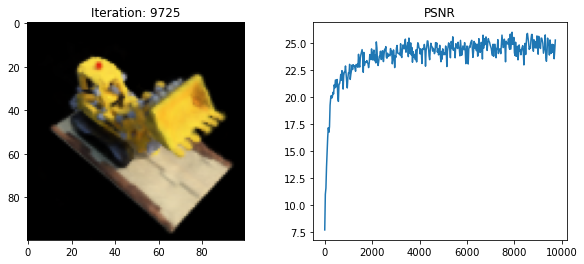

9750 0.3891106033325195 secs per iter


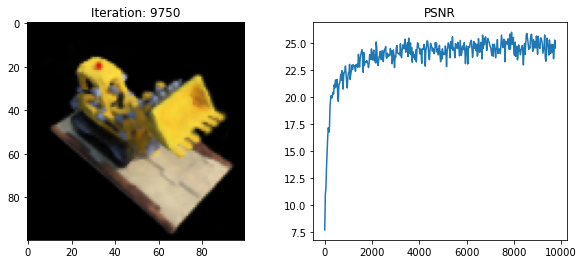

9775 0.39051132202148436 secs per iter


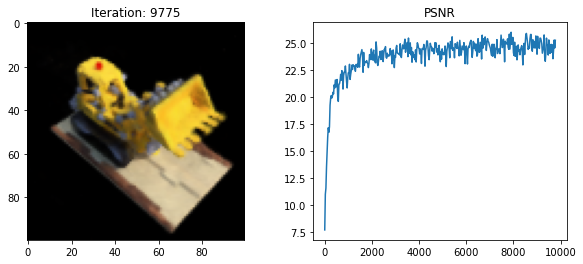

9800 0.39101214408874513 secs per iter


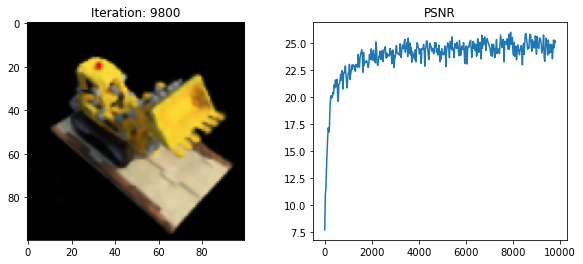

9825 0.3931754112243652 secs per iter


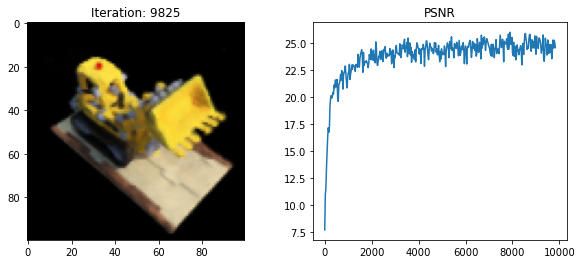

9850 0.39074920654296874 secs per iter


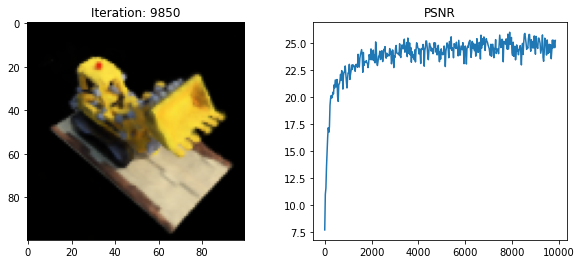

9875 0.39045674324035645 secs per iter


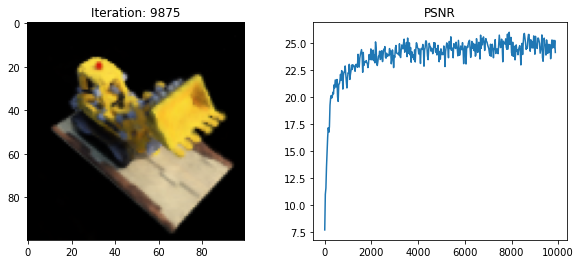

9900 0.38996923446655274 secs per iter


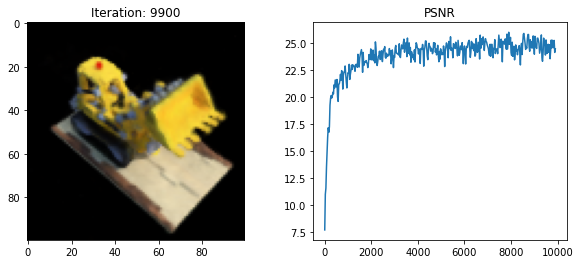

9925 0.38991986274719237 secs per iter


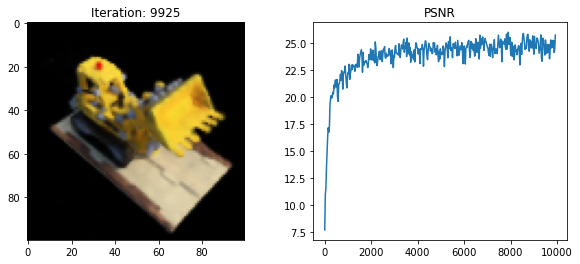

9950 0.39290532112121584 secs per iter


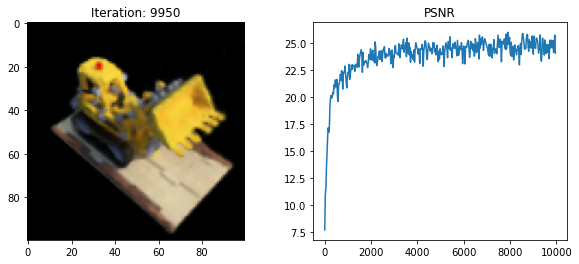

9975 0.3908738803863525 secs per iter


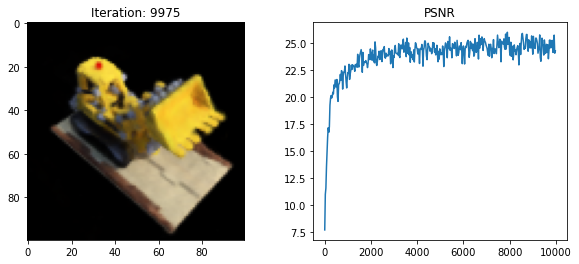

10000 0.3905149459838867 secs per iter


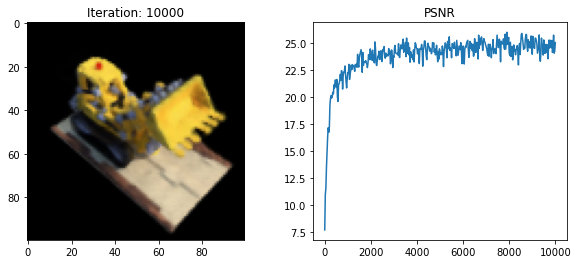

10025 0.38976478576660156 secs per iter


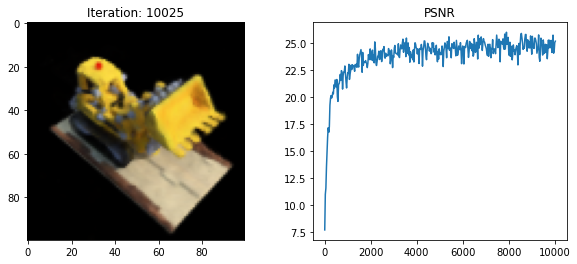

10050 0.3937675380706787 secs per iter


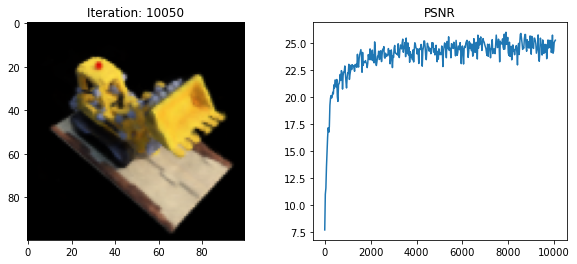

10075 0.3910050392150879 secs per iter


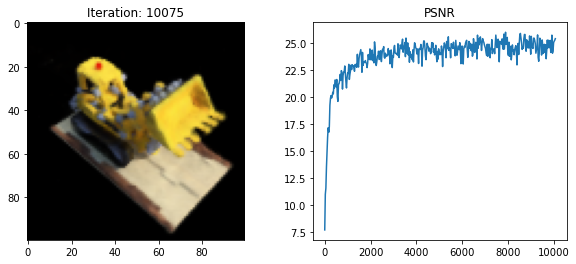

10100 0.3917268466949463 secs per iter


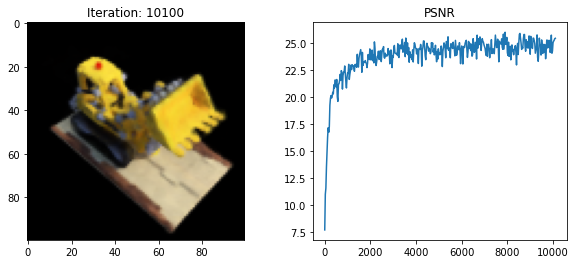

10125 0.3904483032226562 secs per iter


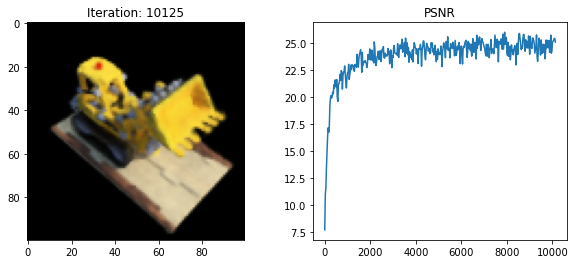

10150 0.38972824096679687 secs per iter


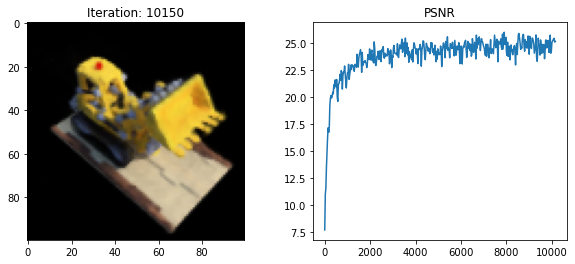

10175 0.3926180553436279 secs per iter


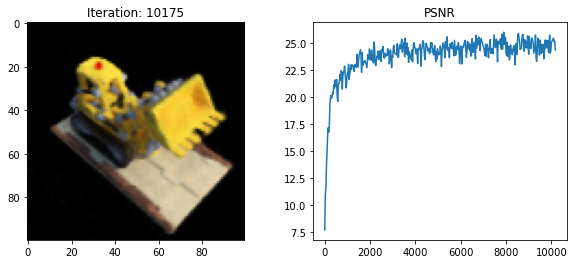

10200 0.3900939655303955 secs per iter


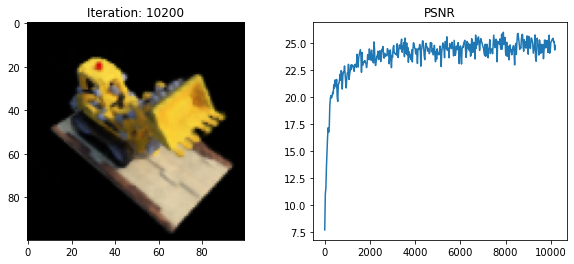

10225 0.3898495769500732 secs per iter


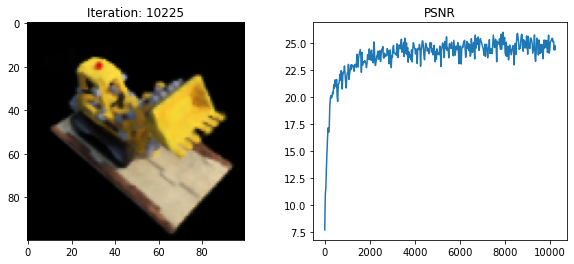

10250 0.39033223152160645 secs per iter


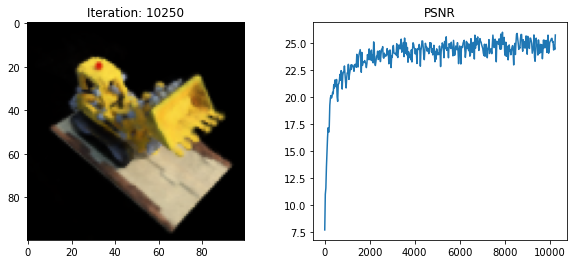

10275 0.39219594955444337 secs per iter


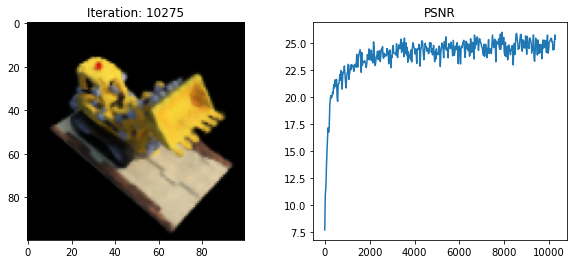

10300 0.3907721519470215 secs per iter


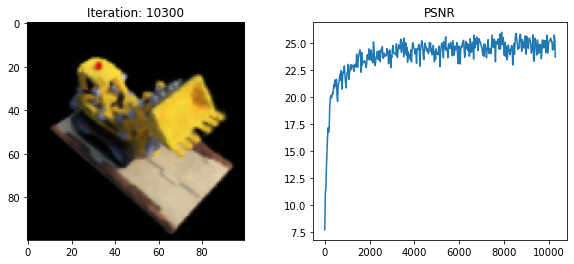

10325 0.39055480003356935 secs per iter


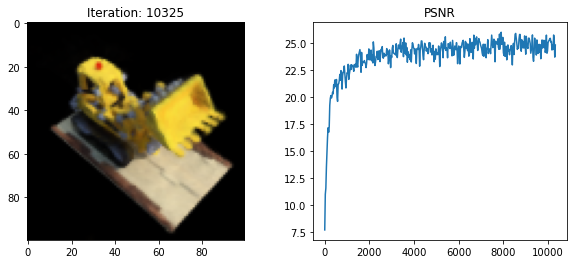

10350 0.3896788215637207 secs per iter


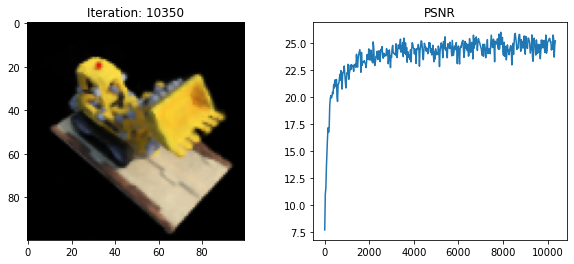

10375 0.38971183776855467 secs per iter


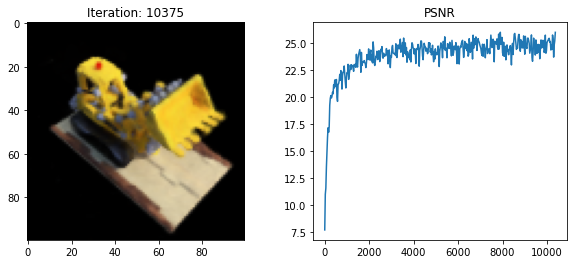

10400 0.3949143981933594 secs per iter


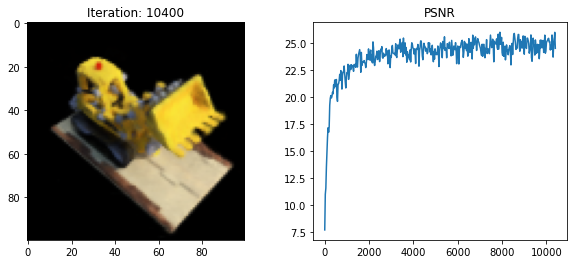

10425 0.39058455467224124 secs per iter


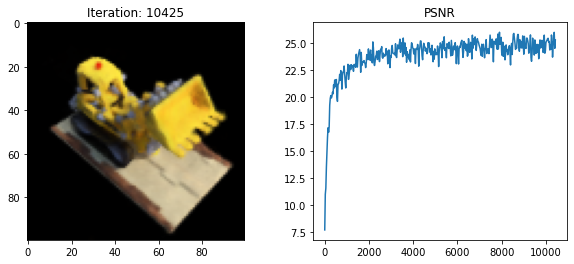

10450 0.3904529571533203 secs per iter


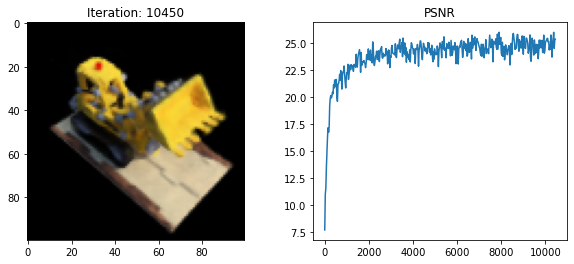

10475 0.39011785507202146 secs per iter


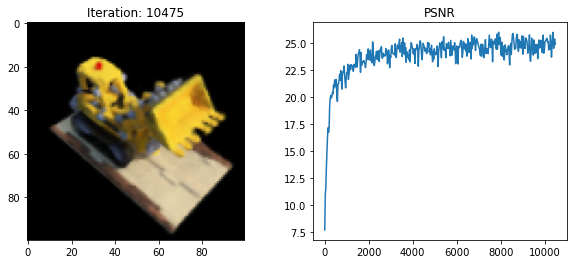

10500 0.3924490165710449 secs per iter


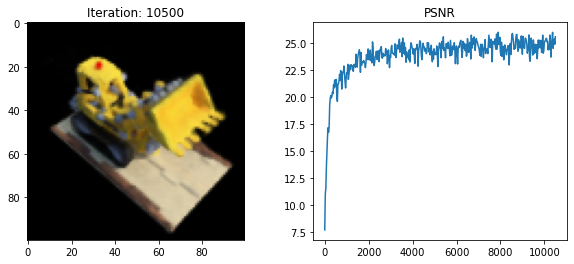

10525 0.3911867046356201 secs per iter


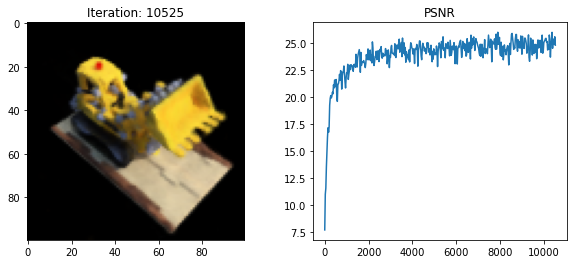

10550 0.39040139198303225 secs per iter


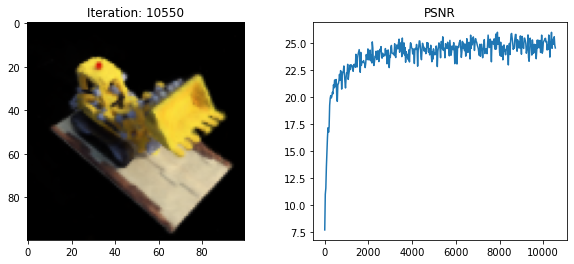

10575 0.39073542594909666 secs per iter


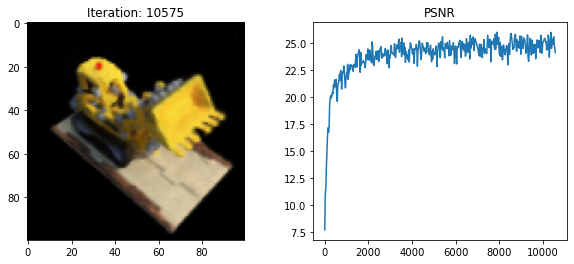

10600 0.39027392387390136 secs per iter


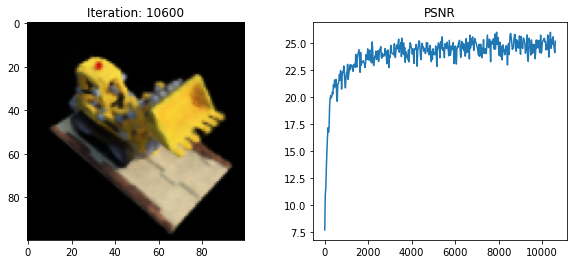

10625 0.3924036407470703 secs per iter


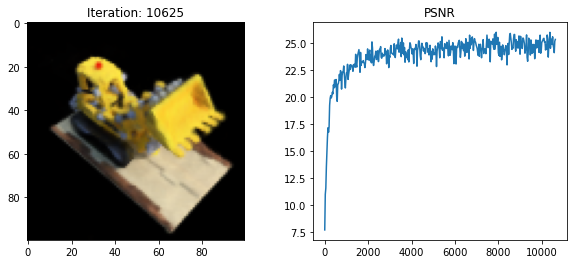

10650 0.3906144332885742 secs per iter


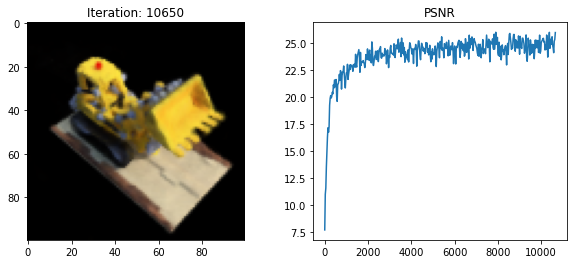

10675 0.3898487091064453 secs per iter


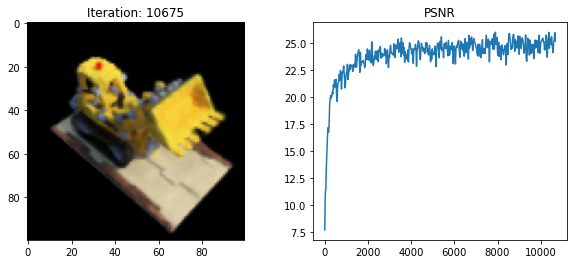

10700 0.39239882469177245 secs per iter


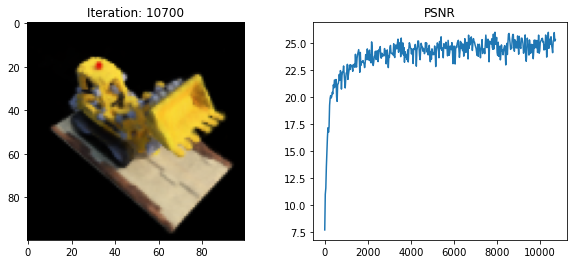

10725 0.39368706703186035 secs per iter


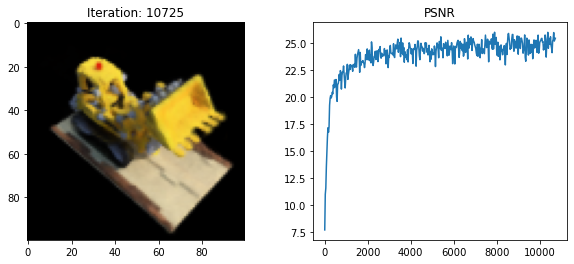

10750 0.3905099010467529 secs per iter


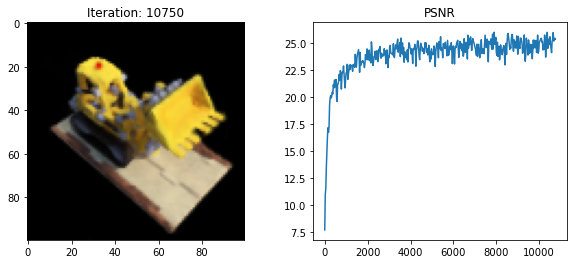

10775 0.39057332038879394 secs per iter


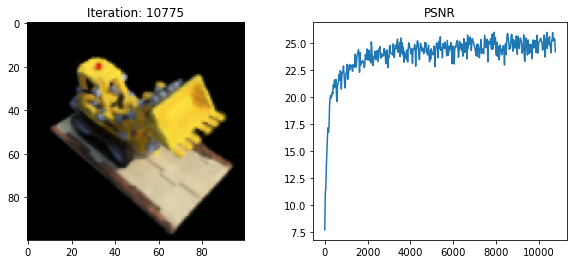

10800 0.39044883728027346 secs per iter


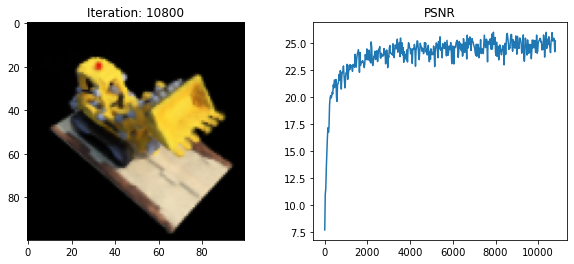

10825 0.38987298965454104 secs per iter


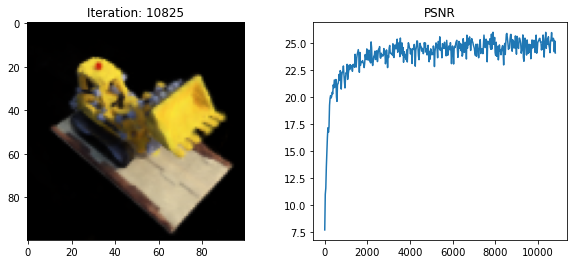

10850 0.3924696445465088 secs per iter


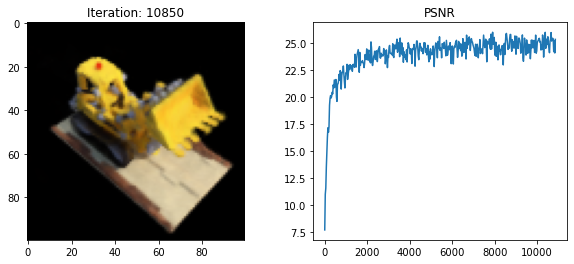

10875 0.3897412872314453 secs per iter


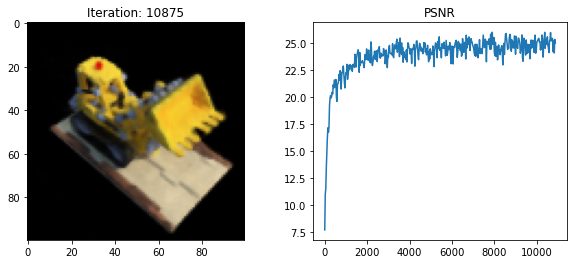

10900 0.3900224781036377 secs per iter


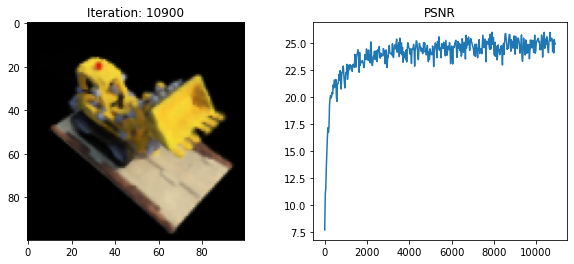

10925 0.39069022178649904 secs per iter


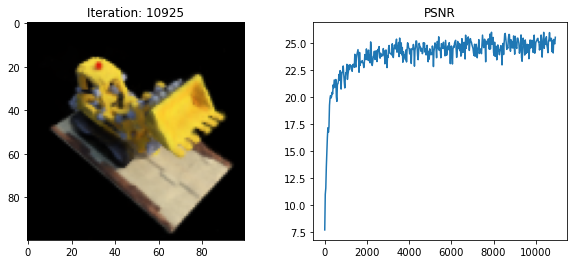

10950 0.39280554771423337 secs per iter


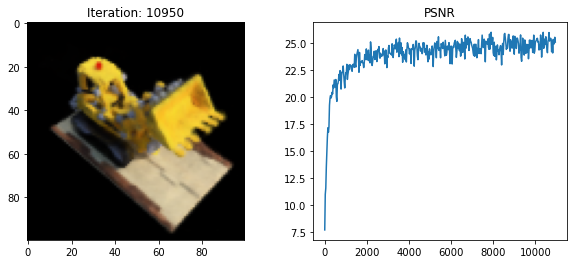

10975 0.38965908050537107 secs per iter


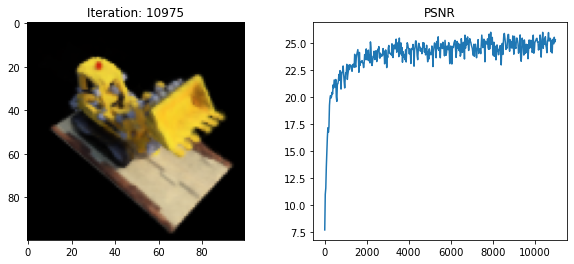

11000 0.39023480415344236 secs per iter


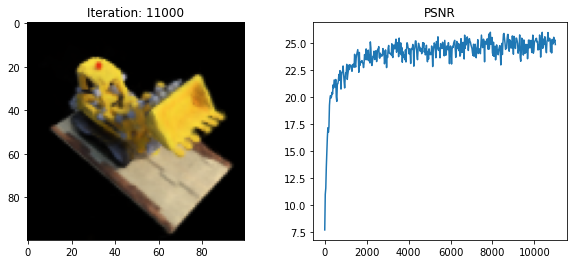

11025 0.3915865993499756 secs per iter


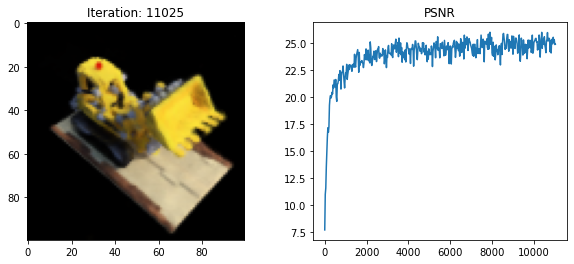

11050 0.3905350780487061 secs per iter


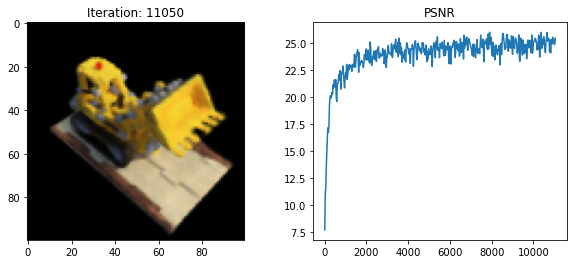

11075 0.39175588607788087 secs per iter


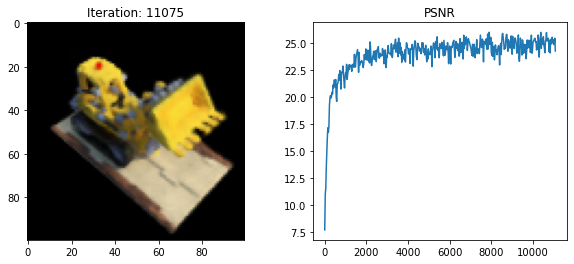

11100 0.3905944347381592 secs per iter


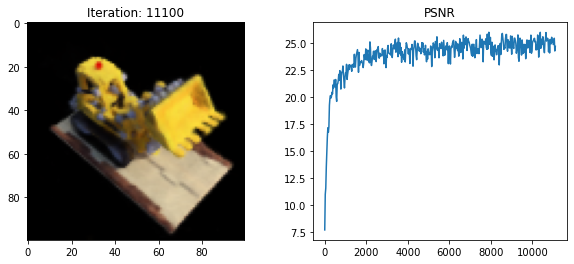

11125 0.39089749336242674 secs per iter


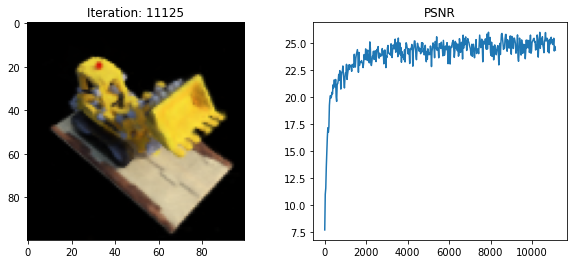

11150 0.3905048847198486 secs per iter


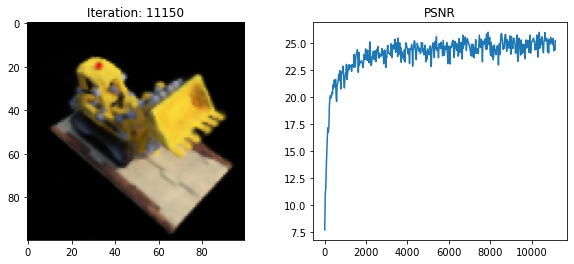

11175 0.3929870986938477 secs per iter


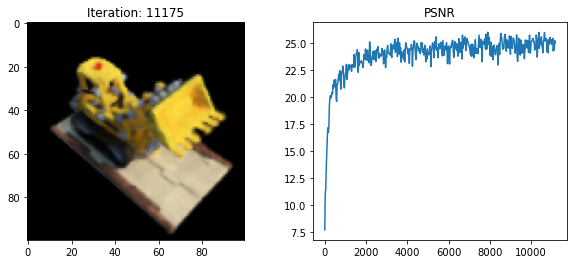

11200 0.39133248329162595 secs per iter


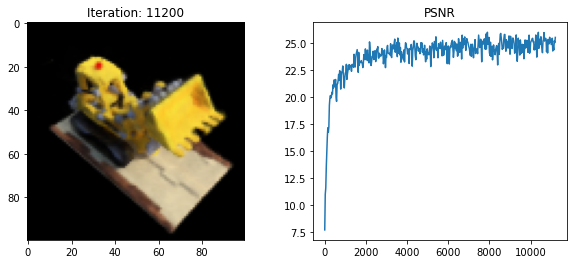

11225 0.39075159072875976 secs per iter


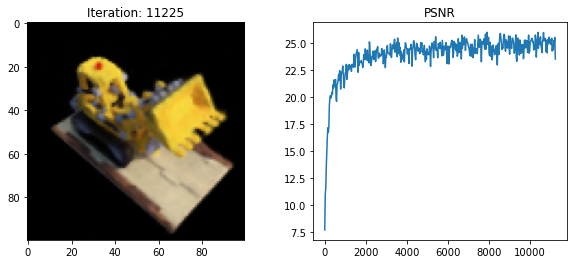

11250 0.3906116199493408 secs per iter


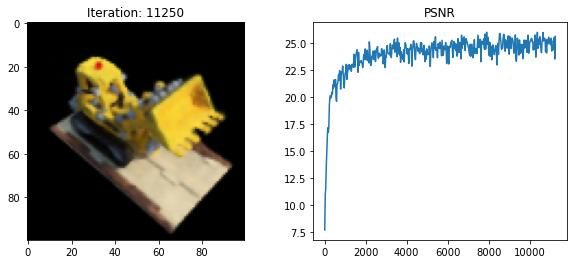

11275 0.3896723175048828 secs per iter


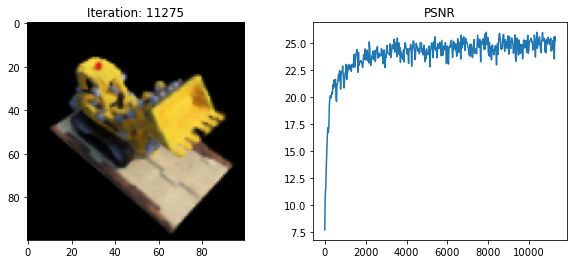

11300 0.39215282440185545 secs per iter


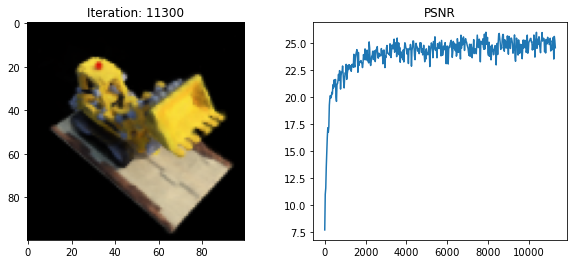

11325 0.392175989151001 secs per iter


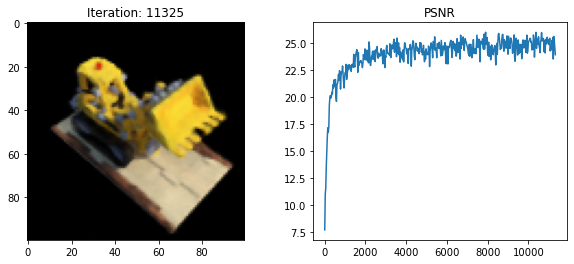

11350 0.3907080841064453 secs per iter


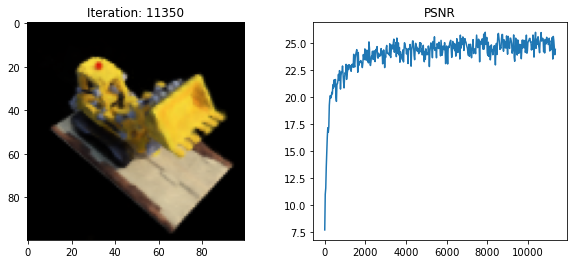

11375 0.3902976131439209 secs per iter


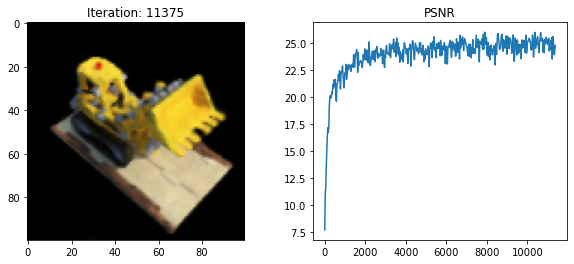

11400 0.39283103942871095 secs per iter


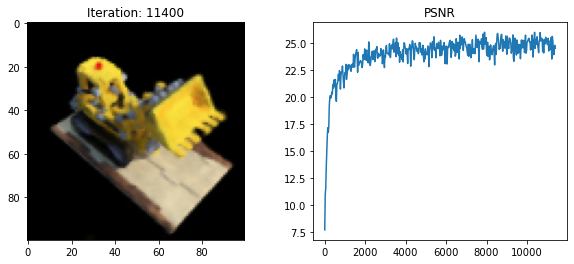

11425 0.39078804969787595 secs per iter


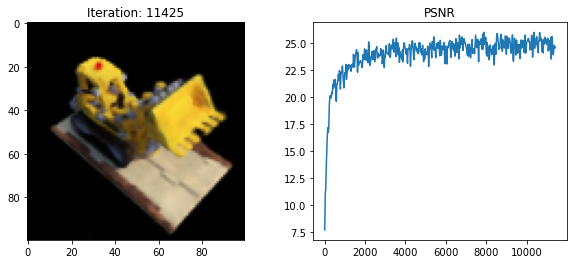

11450 0.39089859008789063 secs per iter


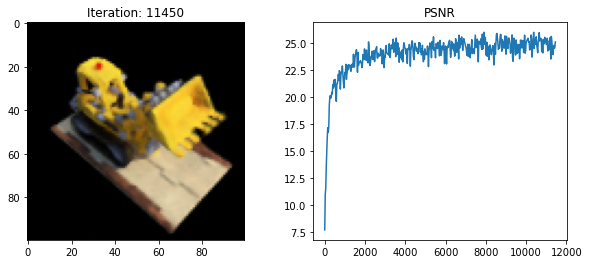

11475 0.39043545722961426 secs per iter


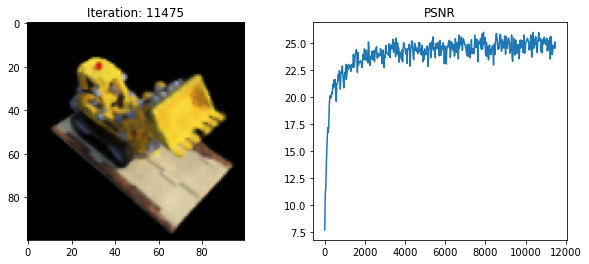

11500 0.39059264183044434 secs per iter


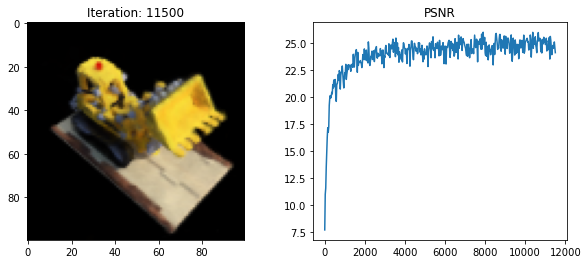

11525 0.3929524803161621 secs per iter


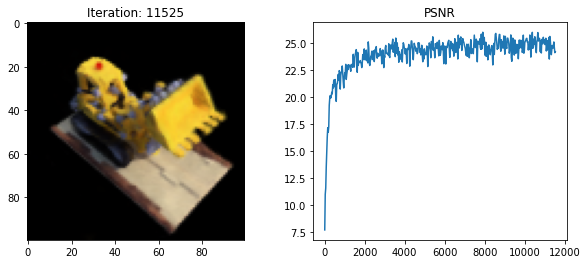

11550 0.3905327224731445 secs per iter


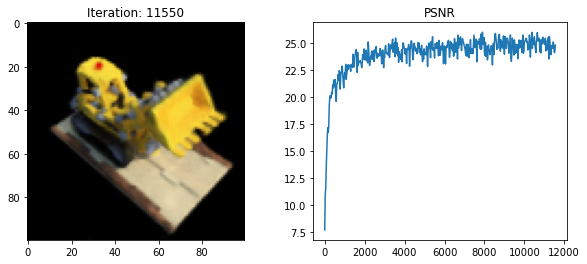

11575 0.39090178489685057 secs per iter


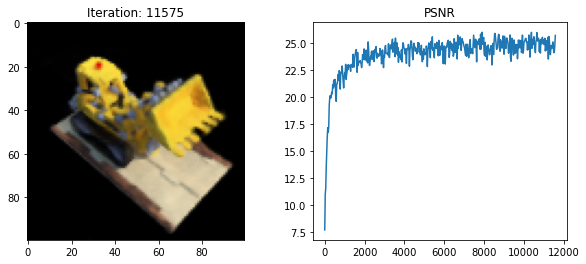

11600 0.3904932594299316 secs per iter


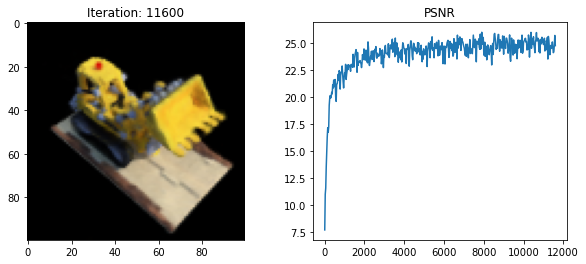

11625 0.3938498687744141 secs per iter


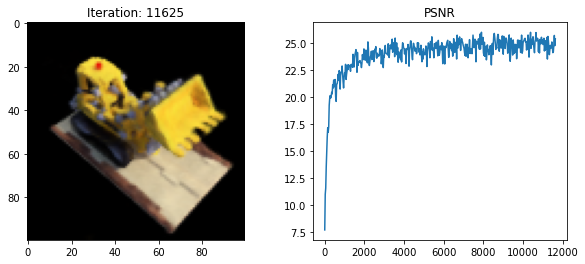

11650 0.3901677131652832 secs per iter


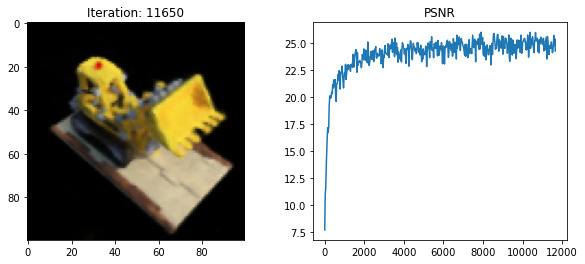

11675 0.39056605339050293 secs per iter


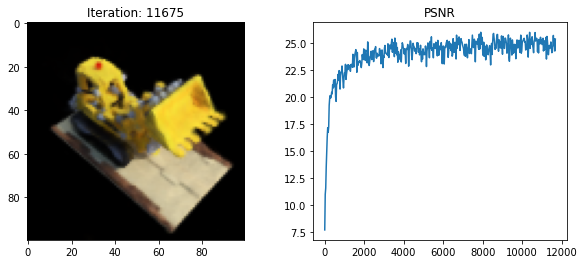

11700 0.3905209732055664 secs per iter


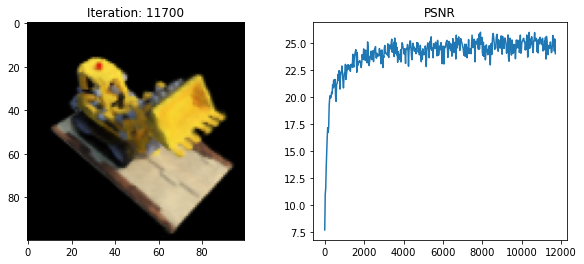

11725 0.3900864028930664 secs per iter


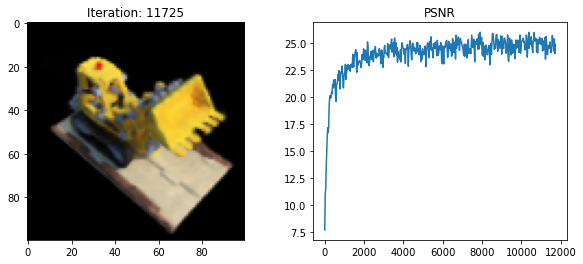

11750 0.39256264686584474 secs per iter


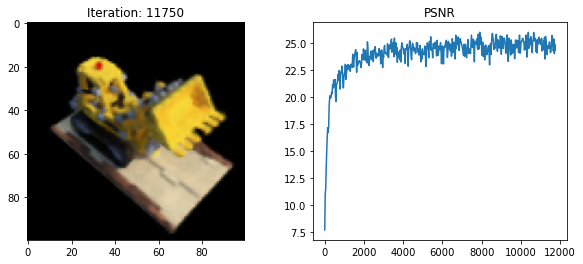

11775 0.39001214027404785 secs per iter


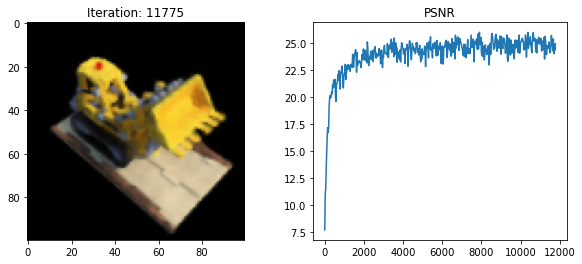

11800 0.390180025100708 secs per iter


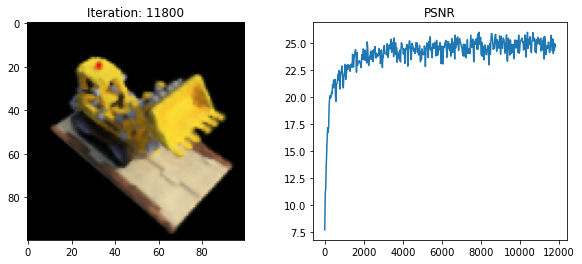

11825 0.390875940322876 secs per iter


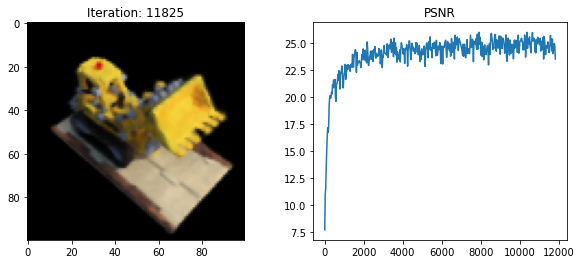

11850 0.3929788303375244 secs per iter


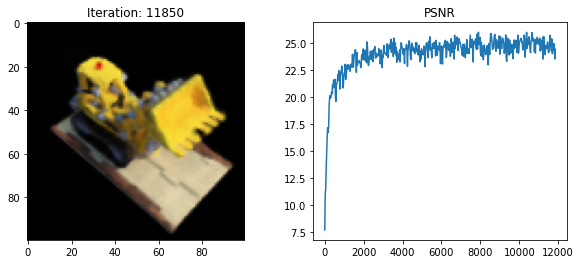

11875 0.39038227081298826 secs per iter


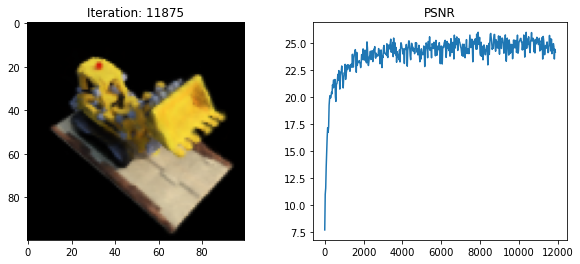

11900 0.3906006622314453 secs per iter


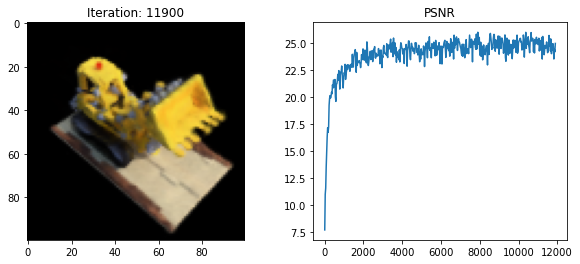

11925 0.3905616855621338 secs per iter


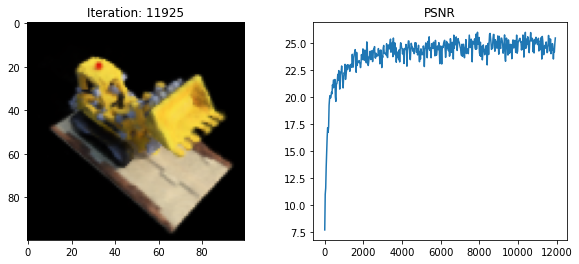

11950 0.3908116340637207 secs per iter


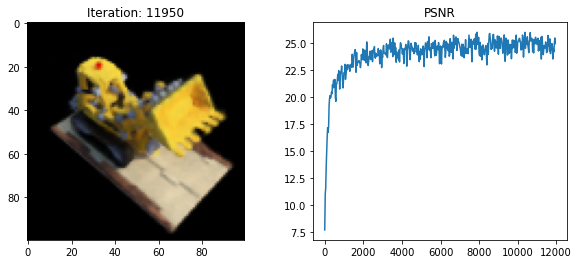

11975 0.3928636932373047 secs per iter


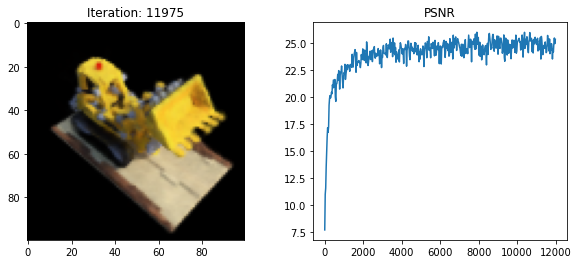

12000 0.39051459312438963 secs per iter


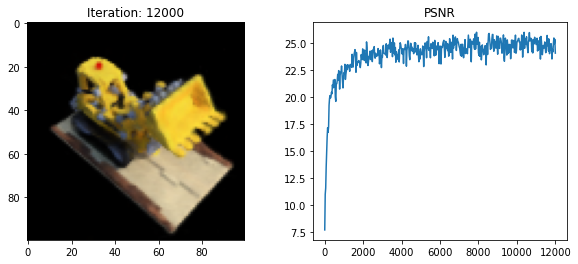

Done


In [5]:
model = init_model()
optimizer = tf.keras.optimizers.Adam(5e-4)

N_samples = 64
N_iters = 12000
psnrs = []
iternums = []
i_plot = 25

import time
t = time.time()
for i in range(N_iters+1):
    
    img_i = np.random.randint(images.shape[0])
    target = images[img_i]
    pose = poses[img_i]
    rays_o, rays_d = get_rays(H, W, focal, pose)
    with tf.GradientTape() as tape:
        rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples, rand=True)
        loss = tf.reduce_mean(tf.square(rgb - target))
    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    
    if i%i_plot==0:
        print(i, (time.time() - t) / i_plot, 'secs per iter')
        t = time.time()
        
        # Render the holdout view for logging
        rays_o, rays_d = get_rays(H, W, focal, testpose)
        rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
        loss = tf.reduce_mean(tf.square(rgb - testimg))
        psnr = -10. * tf.math.log(loss) / tf.math.log(10.)

        psnrs.append(psnr.numpy())
        iternums.append(i)
        
        plt.figure(figsize=(10,4))
        plt.subplot(121)
        plt.imshow(rgb)
        plt.title(f'Iteration: {i}')
        plt.subplot(122)
        plt.plot(iternums, psnrs)
        plt.title('PSNR')
        plt.show()

print('Done')

### Interactive Visualization

In [6]:
%matplotlib inline
from ipywidgets import interactive, widgets


trans_t = lambda t : tf.convert_to_tensor([
    [1,0,0,0],
    [0,1,0,0],
    [0,0,1,t],
    [0,0,0,1],
], dtype=tf.float32)

rot_phi = lambda phi : tf.convert_to_tensor([
    [1,0,0,0],
    [0,tf.cos(phi),-tf.sin(phi),0],
    [0,tf.sin(phi), tf.cos(phi),0],
    [0,0,0,1],
], dtype=tf.float32)

rot_theta = lambda th : tf.convert_to_tensor([
    [tf.cos(th),0,-tf.sin(th),0],
    [0,1,0,0],
    [tf.sin(th),0, tf.cos(th),0],
    [0,0,0,1],
], dtype=tf.float32)


def pose_spherical(theta, phi, radius):
    c2w = trans_t(radius)
    c2w = rot_phi(phi/180.*np.pi) @ c2w
    c2w = rot_theta(theta/180.*np.pi) @ c2w
    c2w = np.array([[-1,0,0,0],[0,0,1,0],[0,1,0,0],[0,0,0,1]]) @ c2w
    return c2w


def f(**kwargs):
    c2w = pose_spherical(**kwargs)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    img = np.clip(rgb,0,1)
    
    plt.figure(2, figsize=(20,6))
    plt.imshow(img)
    plt.show()
    

sldr = lambda v, mi, ma: widgets.FloatSlider(
    value=v,
    min=mi,
    max=ma,
    step=.01,
)

names = [
    ['theta', [100., 0., 360]],
    ['phi', [-30., -90, 0]],
    ['radius', [4., 3., 5.]],
]

interactive_plot = interactive(f, **{s[0] : sldr(*s[1]) for s in names})
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=100.0, description='theta', max=360.0, step=0.01), FloatSlider(value=-…

### Render 360 Video

In [9]:
frames = []
for th in tqdm(np.linspace(0., 360., 120, endpoint=False)):
    c2w = pose_spherical(th, -30., 4.)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    frames.append((255*np.clip(rgb,0,1)).astype(np.uint8))

import imageio
f = 'video_i12000.mp4'
imageio.mimwrite(f, frames, fps=30, quality=10)

/home/james/anaconda3/envs/dev/lib/python3.7/site-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (100, 100) to (112, 112) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [10]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('video_i12000.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)